# <center>Random Corona Walk</center>  
<center><b>Armin Hajar Sabri Sabri</b></center>  

In [1]:
import math as mt
import numpy as np
import scipy as sp
import scipy.integrate
import matplotlib.pyplot as plt

# Abstract

In this project, we developed a Class full of functions that simulate susceptible and infected people in the current COVID 19 situation. First we generated a square with dimensions specified, and generated blue and red dots within that square. Also we built functions that check the interaction between them since the dots are moving one-step either north, south,east o west direction from their last position. We generated plots as well, where we check how fast the infected people transmit the disease with a transmission probability of 0,9. Additionally we compare Random Walk model to analytical equations, we had to find Beta which is the effective contact rate and it was around 0.033-0.042, these depends on the moment we ran the model since we are generating some randomly values at some point which makes that not every time we get the same results. At the end we implemented inside the existed functions and class, some conditions that simulated if some people  get vaccinated and others die, this last probability was set at 1%.



# Introduction

COVID 19 disease, is a virus that is possibly transmitted by being in contact with an infected person, at the beggining of 2020 we saw how this virus got easily spread around the world in just couple of months. Some months later we realized that some people get recovered from it as well, either by medical treatment or just the self-inmune system of the person act by itself. Therefore it is important to understand how fast it can be spread out on the population if none measurement is apply.


We were set out a problem which we solved as we will describe it in the following steps, we tried to recreate how people SUSCEPTIBLE (Blue dots) and INFECTED PEOPLE (Red dots) move around a square, with a high probability rate to transmit the disease if the two dots coincide in the same point. People on the square only had possibility to move one step at a time in any north,south, east or west direction.[<sup>1</sup>](#refer-1)

In the first exercise we were asked to generate a code which allows us to generate any-specified number of dots around an specificed-size square, after have done this we gave movement to each dot according to the specified given conditions. As they moved around we checked their position to make sure they remain inside the built square and the ones which were out of the square were returned to the just previous position. As finally part of the implementation we had to generate a first infected person and when this infected person (red dot) coincide in the same point with a susceptible person (blue dot), the susceptible person get infected and become another red point moving around. 

We started these first part developing a class with a simulator every step function and a collide function that check infected-susceptible interaction. We started using proffesor given code and modify according to out thoughts and way to code.


Having designed the MAIN PART, in the second exercise they asked us to set the inital population to 683 people and run the same code over 50 iterations and 300 step each iteration, these took almost 12 hours to be ran, in order to optimize the time-code-running we changed our code and instead of check every single person status we started to check only infected people and the rest of them were susceptible, this reduce time to 5 minutes the same amount of iterations and steps.

Also in the second exercise we found the mean of the infected people  and susceptible people in each time step of the 50 iteration, and we found an standard deviation for these to see some minimuns and maximuns that thse curves can vary over. With the ODE formula given we found a value for $\beta$, then we plot the two models to see hoew they fit.

In the third exercise we were asked to create the SIR-model--Susceptible, Infected and recovered people--, we could se how when the proability to get recover is 1%, less than half of the populatios is infected at a same time, but when we increased this one at 10%, only about 30 people get infected and they recover so fast that from time step 30 , all the curves are constant.

In the last exercise we choose to add vaccinated and death people, some plots were generated in order to observe and anaylize how the curves change, the probability that we gave to die was of 1% to SENIOR and 10 times less to JUNIOR. Regarding vaccinated people, this started on time step 100, to represent how late vaccines came after COVD 19 disease was already spread out, we could see how the infected people is reduced at the same time that people start to be vaccinated, each time step only 5% of the susceptible people we gave vacciones to.

# Exercise 1: Implement random walk SI-model



In [2]:
class RandomWalkEpidemicSimulator:
    """
    Class used to model the spreading of a contagious disease in a
    population of individuals with a 2D random walk.

    Each walker has a disease status which is represented by an
    integer Enum. Also, a set of integer (x, y)-coordinates are
    stored for each walker. The possible coordinates are:

      {0, 1, ..., Lx-1} in the x-direction
      {0, 1, ..., Ly-1} in the y-direction
    
    It is only possible to move North, South, East, or West. If a
    walker attempts to move outside of the physical domain, nothing
    happens (i.e., a "bounce-back boundary condition" is enforced).
    """
    def __init__(self,
                 population_size=1000,
                 no_init_infected=1,
                 nx=30,
                 ny=30,
                 p_infected=0.9,
                 p_recovered=0,
                 p_vaccinated=0,
                 p_dead=0,
                 plot_radomwalk=False,
                 plot_beta=False,
                 plot_mean=False,
                 plot_mean10=False,
                 print_age=False):
      
        """
        :param population_size: The total number of people (N).
        :param no_init_infected: The number of infected people at t=0.
        :param nx: The number of lattice nodes in the x-direction
        :param ny: The number of lattice nodes in the y-direction
        :param p_infected: The probability of infection (0 <= q <= 1).
        :param p_recovered: The probability of infection (0 <= q <= 1).
        :param p_vaccinated: The probability of infection (0 <= q <= 1).
        :param p_dead: The probability of infection (0 <= q <= 1).
        :param plot_radomwalk: The switch for plot of random walk simulation.
        :param plot_beta: The switch for plot of beta list.
        :param plot_mean: The switch for plot of mean for all iterations.
        :param plot_mean10: The switch for plot of mean for 10 iterations. 
        :param print_age: Print the number of juniors and seniors.      
        """

        self.N = population_size
        self.I0= no_init_infected
        self.nx= nx
        self.ny= ny

        self.p_infected = p_infected
        self.p_recovered=p_recovered
        self.p_vaccinated=p_vaccinated
        self.p_dead=p_dead

        self.SUSCEPTIBLE = 0
        self.VACCINATED = 1
        self.INFECTIOUS = 2
        self.RECOVERED = 3
        self.DEAD = 4
        self.SENIOR=0
        self.JUNIOR=1

        self.timestep=0

        self.plot_radomwalk=plot_radomwalk
        self.plot_beta=plot_beta
        self.plot_mean=plot_mean
        self.plot_mean10=plot_mean10
        self.print_age=print_age
        
        self.State = np.full(self.N, self.SUSCEPTIBLE) 
        self.State[0:self.I0] = self.INFECTIOUS
        #0: senior, 1: junior (low death rate)
        self.Age=np.zeros(self.N) 
        self.Age[0:mt.ceil(self.N*np.random.uniform(0, 1))] = self.JUNIOR

        self.Walkers = np.random.randint(0, [self.nx, self.ny], size=(self.N, 2)) #position of all pop
        
        self.no_susceptible = np.array(np.sum(self.State == self.SUSCEPTIBLE))
        self.no_infectious = np.array(np.sum(self.State == self.INFECTIOUS))
        self.no_recovered = np.array(np.sum(self.State == self.RECOVERED))
        self.no_vaccinated = np.array(np.sum(self.State==self.VACCINATED))
        self.no_dead = np.array(np.sum(self.State == self.DEAD))
        self.no_dead_senior = 0

    #ex1   
    def simulatior_every_step(self,tf):   
        if self.print_age:
            print(len(self.Age[self.Age==1]),"juniors and",len(self.Age[self.Age==0]),"seniors" )
        for t in range(tf): 
            self.current_time=t
            #random walk
            choices = np.random.randint(0, 4, self.Walkers.shape[0]) # choose direction
            old_Walkers=self.Walkers.copy()
            self.Walkers[choices == 0, 0] += 1 # Right
            self.Walkers[choices == 1, 0] -= 1 # Left
            self.Walkers[choices == 2, 1] += 1 # Up
            self.Walkers[choices == 3, 1] -= 1 # Down
            # Death don't move
            self.Walkers[self.State ==self.DEAD]=old_Walkers[self.State ==self.DEAD]
            # Keep all people inside the grid
            self.Walkers[self.Walkers < 0] = 0
            self.Walkers[self.Walkers[:,0] >= self.nx,0] = self.nx-1
            self.Walkers[self.Walkers[:,1] >= self.ny,1] = self.ny-1

            self.S=self.Walkers[self.State==self.SUSCEPTIBLE]
            self.I=self.Walkers[self.State ==self.INFECTIOUS]
            self.R=self.Walkers[self.State ==self.RECOVERED]
            self.V=self.Walkers[self.State==self.VACCINATED]
            self.D=self.Walkers[self.State ==self.DEAD]
           
            self.timestep+=1
            self.collide(tf)          
            if ((self.timestep)%100==0)*(self.plot_radomwalk): 
                self.plot_simulation()
        
        return self.no_infectious, self.no_susceptible, self.no_recovered, self.no_vaccinated, self.no_dead
        
    def collide(self,tf):
        # whether susceptible to be infected
        unique_position,index,counts=np.unique(self.Walkers,axis=0,return_index=True,return_counts=True)
        collision_index= np.where(counts>1)
        collide_position = unique_position[collision_index]
        for i in range(len(collide_position)):
            same_place_index=np.where((self.Walkers==collide_position[i]).all(axis=1))
            for j in same_place_index:
                no_of_infected = self.State[j][self.State[j]==self.INFECTIOUS]
                no_of_susceptible = self.State[j][self.State[j]==self.SUSCEPTIBLE]
                if len(no_of_infected)>0 and len(no_of_susceptible)>0:
                    for idx in j:
                        if self.State[idx]==self.SUSCEPTIBLE:
                            q_prop = np.random.uniform(0, 1)
                            if q_prop < self.p_infected:
                                self.State[idx] = self.INFECTIOUS
        
        #ex3p1 whether to be recovered
        Chance_rec_index=np.where(self.State==self.INFECTIOUS)[0]
        p=np.random.uniform(0,1,len(Chance_rec_index))
        rec_index=Chance_rec_index[p<np.full(shape=len(Chance_rec_index),fill_value=self.p_recovered)]
        self.State[rec_index]=self.RECOVERED
        
        #ex4 whether to be vaccinated
        if self.current_time >= 100: #after 100 time steps begin to vaccine
            Chance_vac_index=np.where(self.State==self.SUSCEPTIBLE)[0]
            q_vac=np.random.uniform(0,1,len(Chance_vac_index))
            vac_index=Chance_vac_index[q_vac<np.full(shape=len(Chance_vac_index),fill_value=self.p_vaccinated)]
            self.State[vac_index]=self.VACCINATED
        
        #ex4 whether to be dead
        Chance_dea_index=np.where(self.State==self.INFECTIOUS)[0]
        p_death=np.random.uniform(0,1,len(Chance_dea_index))
        # The death rate for junior is 10% of the senior's
        dea_index=Chance_dea_index[p_death<(np.full(shape=len(Chance_dea_index),fill_value=self.p_dead)-self.Age[Chance_dea_index]*self.p_dead*0.9)]
        self.no_dead_senior+=np.sum(self.Age[dea_index]==self.SENIOR)                                   
        self.State[dea_index]=self.DEAD   

        self.no_infectious=np.append(self.no_infectious,np.sum(self.State == self.INFECTIOUS))
        self.no_susceptible=np.append(self.no_susceptible,np.sum(self.State == self.SUSCEPTIBLE))
        self.no_recovered=np.append(self.no_recovered,np.sum(self.State == self.RECOVERED))
        self.no_vaccinated=np.append(self.no_vaccinated,np.sum(self.State == self.VACCINATED))
        self.no_dead=np.append(self.no_dead,np.sum(self.State == self.DEAD))
        
    def plot_simulation(self):
        if self.plot_radomwalk:
            plt.xlim(-.8,self.nx+0.8)
            plt.ylim(-.8,self.ny+0.8)
            plt.scatter(self.S[:,0],self.S[:,1],c='b',label="Susceptible - RW")
            plt.scatter(self.I[:,0],self.I[:,1],c='r',label="Susceptible - RW")
            plt.scatter(self.R[:,0],self.R[:,1],c='yellow',label='Recovered - RW')
            plt.scatter(self.V[:,0],self.V[:,1],c='g',label='Vaccinated - RW')
            plt.scatter(self.D[:,0],self.D[:,1],c='k',label='Dead - RW')
            plt.grid() 
            plt.legend(bbox_to_anchor=(1,0.5))
            plt.title("Step: %i" %self.timestep)
            plt.show()

            print("Healthy people=", np.sum(self.State==self.SUSCEPTIBLE))
            print("Sick people=", np.sum(self.State==self.INFECTIOUS)) 
            print("Recovered people=", np.sum(self.State==self.RECOVERED)) 
            print("Vaccinated people=", np.sum(self.State==self.VACCINATED))
            print("Dead people=", np.sum(self.State==self.DEAD)) 
            print(" Dead seniors",self.no_dead_senior)
            print(" Dead juniors",np.sum(self.State==self.DEAD)-self.no_dead_senior) 

    #ex2p1
    def SI_mean_sd_plot(self,inf,sus,rec,vak,dea,m):
        #mean
        self.inf_mean=np.reshape(inf,(-1,m)).mean(axis=0) # 50 iterations
        inf_mean_10=np.reshape(inf,(-1,m))[0:10,].mean(axis=0)
        self.sus_mean=np.reshape(sus,(-1,m)).mean(axis=0) # 50 iterations
        sus_mean_10=np.reshape(sus,(-1,m))[0:10,].mean(axis=0)
        self.rec_mean=np.reshape(rec,(-1,m)).mean(axis=0) # 50 iteration
        rec_mean_10=np.reshape(rec,(-1,m))[0:10,].mean(axis=0)
        vak_mean=np.reshape(vak,(-1,m)).mean(axis=0) # 50 iteration
        vak_mean_10=np.reshape(vak,(-1,m))[0:10,].mean(axis=0)
        dea_mean=np.reshape(dea,(-1,m)).mean(axis=0) # 50 iteration
        dea_mean_10=np.reshape(dea,(-1,m))[0:10,].mean(axis=0)

        #std
        inf_std=np.reshape(inf,(-1,m)).std(axis=0,ddof=0) # for 50 iterations
        inf_std_10=np.reshape(inf,(-1,m))[0:10,].std(axis=0,ddof=0)
        sus_std=np.reshape(sus,(-1,m)).std(axis=0,ddof=0) # 50 iterations
        sus_std_10=np.reshape(sus,(-1,m))[0:10,].std(axis=0,ddof=0)
        rec_std=np.reshape(rec,(-1,m)).std(axis=0,ddof=0) # 50 iterations
        rec_std_10=np.reshape(rec,(-1,m))[0:10,].std(axis=0,ddof=0)
        vak_std=np.reshape(vak,(-1,m)).std(axis=0,ddof=0) # 50 iterations
        vak_std_10=np.reshape(vak,(-1,m))[0:10,].std(axis=0,ddof=0)         
        dea_std=np.reshape(dea,(-1,m)).std(axis=0,ddof=0) # 50 iterations
        dea_std_10=np.reshape(dea,(-1,m))[0:10,].std(axis=0,ddof=0)         
        
        if self.plot_mean:
            x=range(len(self.inf_mean))
            plt.fill_between(x,self.inf_mean-inf_std, self.inf_mean+inf_std,color="lightcoral",alpha=0.4)
            plt.fill_between(x,self.sus_mean-sus_std, self.sus_mean+sus_std,color="skyblue",alpha=0.4)
            plt.fill_between(x,self.rec_mean-rec_std,self.rec_mean+rec_std,color='khaki',alpha=0.4)
            plt.fill_between(x,vak_mean-vak_std,vak_mean+vak_std,color='lime',alpha=0.4)
            plt.fill_between(x,dea_mean-dea_std,dea_mean+dea_std,color='Grey',alpha=0.4)

            plt.plot(self.inf_mean,color="r",label="Infected - RW")
            plt.plot(self.sus_mean,color="b",label="Susceptible - RW")
            plt.plot(self.rec_mean,color='yellow',label='Recovered - RW')
            plt.plot(vak_mean,color='g',label='Vaccinated - RW')
            plt.plot(dea_mean,color='k',label='Dead - RW')

            plt.xlabel("Time steps")
            plt.ylabel("Population")
            plt.title("Average of 50 simulations of the random walk")
            plt.legend(bbox_to_anchor=(1,0.5))
            plt.grid()
            plt.show()
            
        if self.plot_mean10:
            plt.fill_between(x,inf_mean_10-inf_std_10, inf_mean_10+inf_std_10,color="lightcoral",alpha=0.4)
            plt.fill_between(x,sus_mean_10-sus_std_10, sus_mean_10+sus_std_10,color="skyblue",alpha=0.4)
            plt.fill_between(x,rec_mean_10-rec_std_10,rec_mean_10+rec_std_10,color='khaki',alpha=0.4)
            plt.fill_between(x,vak_mean_10-vak_std_10,vak_mean_10+vak_std_10,color='lime',alpha=0.4)
            plt.fill_between(x,dea_mean_10-dea_std_10,dea_mean_10+dea_std_10,color='Grey',alpha=0.4)
            
            plt.plot(inf_mean_10,color="r",label="Infected - RW")
            plt.plot(sus_mean_10,color="b",label="Susceptible - RW")
            plt.plot(rec_mean_10,color='yellow',label='Recovered - RW')
            plt.plot(vak_mean_10,color='g',label='Vaccinated - RW')
            plt.plot(dea_mean_10,color='k',label='Dead - RW')
            
            plt.xlabel("Time steps")
            plt.ylabel("Population")
            plt.title("Average of 10 simulations of the random walk ")
            plt.legend(bbox_to_anchor=(1,0.5))
            plt.grid()
            plt.show()  

    #ex2p3 
    def beta_deltat_plot(self):
        beta_deltat=[]
        for i in range(1,len(self.sus_mean)-1):
            beta_deltat.append(-(self.sus_mean[i]-self.sus_mean[i-1])*self.N/self.sus_mean[i]/self.inf_mean[i])
        self.beta_deltat=np.asarray(beta_deltat)
        self.beta_deltat=self.beta_deltat[~np.isnan(self.beta_deltat)]
        self.beta_deltat=self.beta_deltat[~np.isinf(self.beta_deltat)]
        self.average_beta=np.mean(self.beta_deltat)         

        if self.plot_beta:
            plt.plot(beta_deltat,color="Red")
            plt.xlabel("Time steps")
            plt.ylabel("\u03B2\u0394 t")
            plt.grid()
            plt.show()
            print('\nThe \u03B2\u0394 t ',self.beta_deltat)
        print('\nThe average \u03B2-value ', self.average_beta)
        return self.average_beta

    #ex2p4    
    def tau_sick(self):
        tau_sick_values=[]
        for j in range(1,len(self.sus_mean)-1):
            if self.rec_mean[j]!=self.rec_mean[j-1]:
                tau_sick_values.append(self.inf_mean[j]/(self.rec_mean[j]-self.rec_mean[j-1]))
        self.tau_sick_values=np.asarray(tau_sick_values)
        self.average_tau_sick=np.mean(self.tau_sick_values)
        print('The average Taus_sick is {}'.format(self.average_tau_sick))
        return self.average_tau_sick

    def analytical_I(self): 
        t = range(len(self.inf_mean))
        # Calculate S(t) and I(t) 
        i_t = self.N/(1+((self.N-self.I0)/self.I0)*np.exp(-self.average_beta*t))
        plt.plot(t,i_t,label='Analytical')
        plt.plot(t,self.inf_mean,label='Mean Infected')
        plt.title('Initial_Infected={init_inf} and q={q_prop}'.format(init_inf=self.I0,q_prop=self.p_infected))
        plt.legend()
        plt.grid()
        plt.plot()

## Part 1:
- Write a function and/or class that can be used to conduct a single simulation of the random walk algorithm.

## Part 2:
- Discuss your implementation, and show some relevant plots (e.g. like in figure 1) where you demonstrate that the code does what it is supposed to. In particular, we would like to see that walkers do not cross boundaries, and that only walkers that meet infected individuals get infected.

**Answer:**
We choose random direction by each time step. And because there is 2 elements in matrix walkers, as the first one is x-axis and the second is y-axis. So when direction is 0 and 1 the walkers will take one right/left step for each movement. The same as the up/down direction. [<sup>2</sup>](#refer-2)


    choices = np.random.randint(0, 4, self.Walkers.shape[0]) # choose direction
    old_Walkers=self.Walkers.copy()
    self.Walkers[choices == 0, 0] += 1 # Right
    self.Walkers[choices == 1, 0] -= 1 # Left
    self.Walkers[choices == 2, 1] += 1 # Up
    self.Walkers[choices == 3, 1] -= 1 # Down
    
We have created limit boundries of the grid, so that the walkers will not cross the boundries. If they go out of the boundries they will take one backward step. [<sup>3</sup>](#refer-3)

    # Keep all people inside the grid
    self.Walkers[self.Walkers < 0] = 0
    self.Walkers[self.Walkers[:,0] >= self.nx,0] = self.nx-1
    self.Walkers[self.Walkers[:,1] >= self.ny,1] = self.ny-1

We plot the state of the walkers' posisition each 100 time steps.

    if ((self.timestep)%100==0)*(self.plot_radomwalk): 
        self.plot_simulation()

**Solution Part 1 and Part 2**:

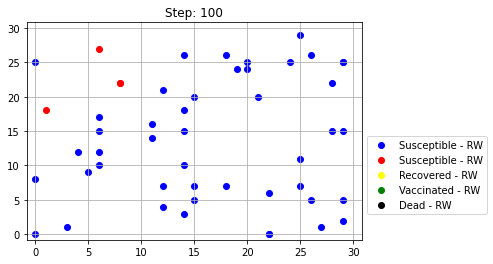

Healthy people= 46
Sick people= 4
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0


In [3]:
ex1 = RandomWalkEpidemicSimulator(population_size=50,plot_radomwalk=True) 
inf_temp, sus_temp, rec_temp,vac_temp,dea_temp=ex1.simulatior_every_step(100)

# Exercise 2: Compare with ODE-based SI-model

## Part 1: 
Suppose there is a single infectious individual initially, $I_0$≡I(0)= 1.

- Run the random walk SI-model forward in time repeatedly; at least 50 times. For each run, take 300 time steps. (If your code is fast, you should experiment with running the code even more times, and longer if necessary)
- For each time step, calculate 1) the sample mean and 2) the sample standard deviation of the number of healthy (S) and sick (I) people in the population.
- Create a figure showing the expected time-development of the two populations. Make sure to include the computed uncertainty in the plot, e.g., by making your plot similar to figure 2.

**Solution**:


 Iteration 1


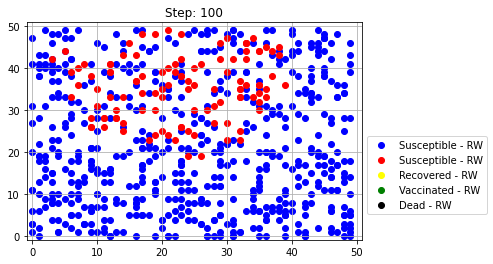

Healthy people= 572
Sick people= 111
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0


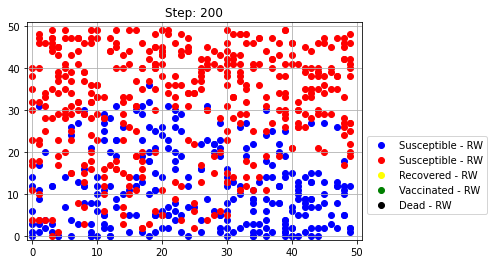

Healthy people= 271
Sick people= 412
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0


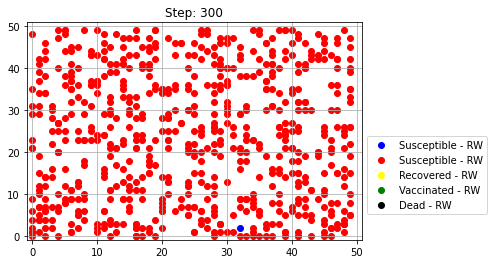

Healthy people= 1
Sick people= 682
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0

 Iteration 2


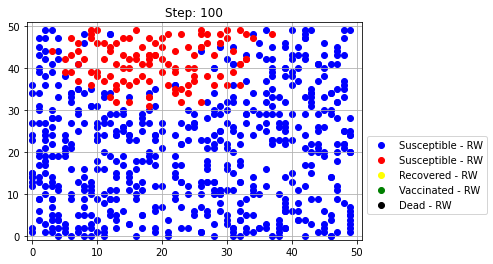

Healthy people= 571
Sick people= 112
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0


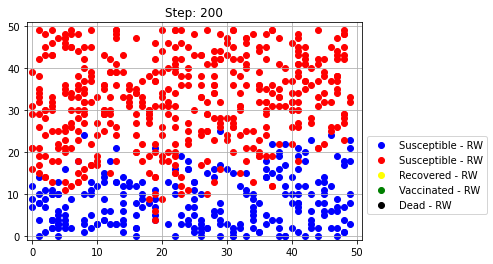

Healthy people= 239
Sick people= 444
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0


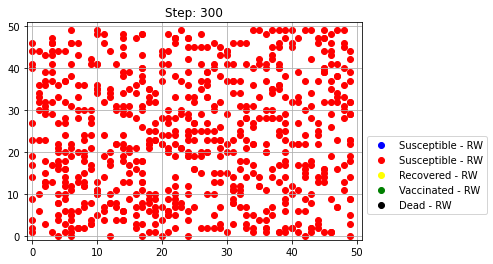

Healthy people= 0
Sick people= 683
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0

 Iteration 3


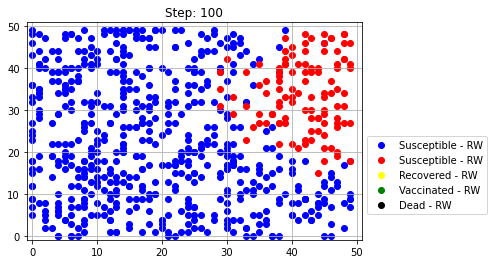

Healthy people= 569
Sick people= 114
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0


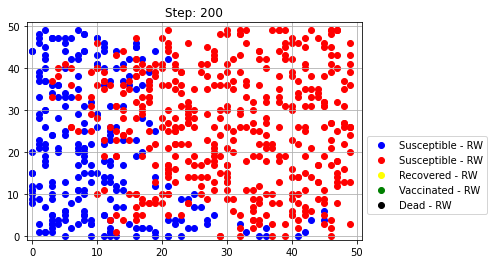

Healthy people= 242
Sick people= 441
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0


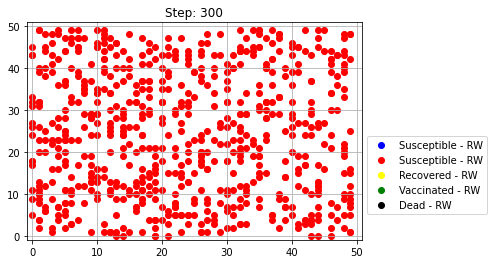

Healthy people= 0
Sick people= 683
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0

 Iteration 4


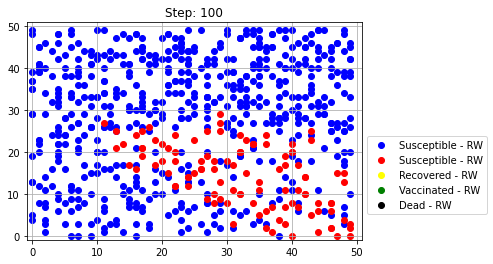

Healthy people= 575
Sick people= 108
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0


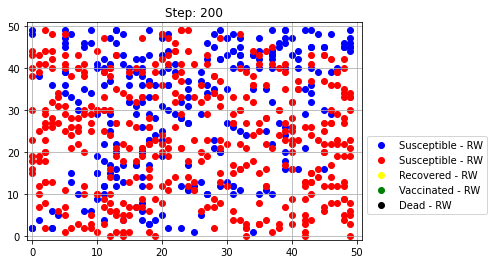

Healthy people= 264
Sick people= 419
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0


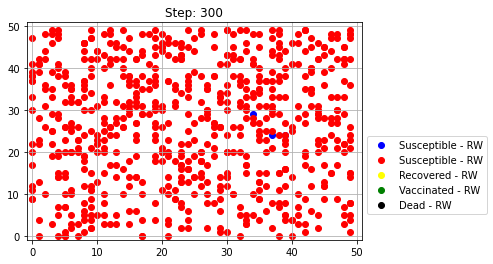

Healthy people= 2
Sick people= 681
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0

 Iteration 5


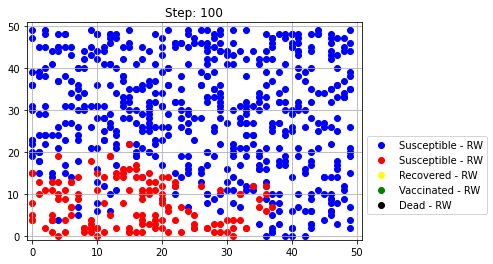

Healthy people= 540
Sick people= 143
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0


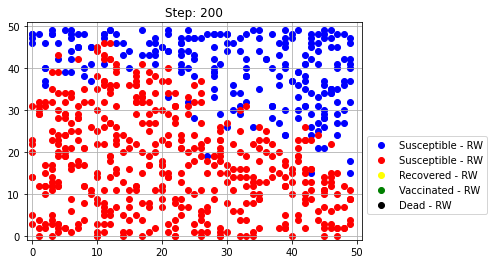

Healthy people= 228
Sick people= 455
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0


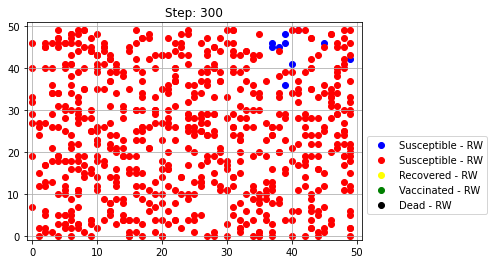

Healthy people= 9
Sick people= 674
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0

 Iteration 6


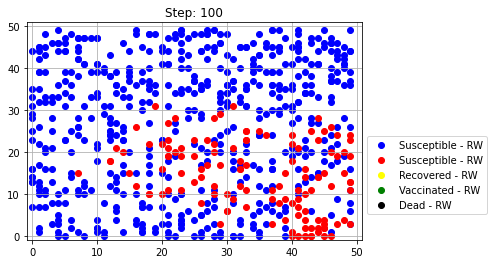

Healthy people= 556
Sick people= 127
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0


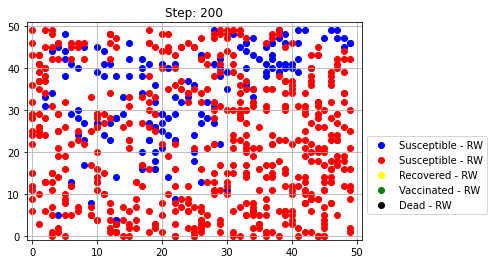

Healthy people= 150
Sick people= 533
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0


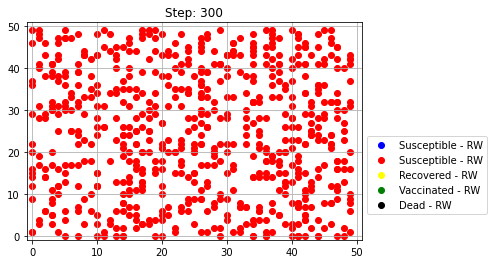

Healthy people= 0
Sick people= 683
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0

 Iteration 7


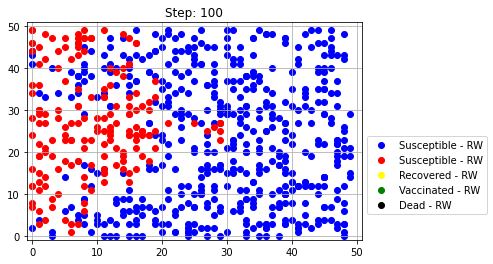

Healthy people= 504
Sick people= 179
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0


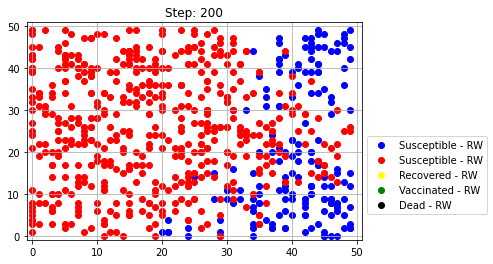

Healthy people= 169
Sick people= 514
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0


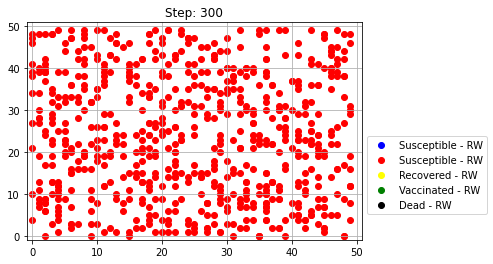

Healthy people= 0
Sick people= 683
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0

 Iteration 8


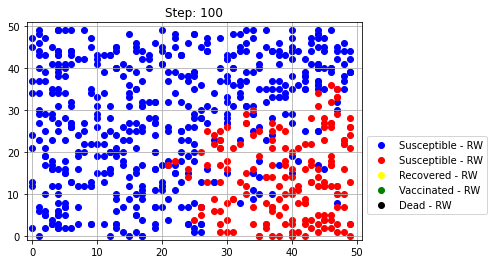

Healthy people= 506
Sick people= 177
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0


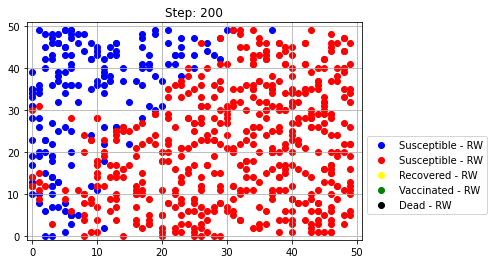

Healthy people= 176
Sick people= 507
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0


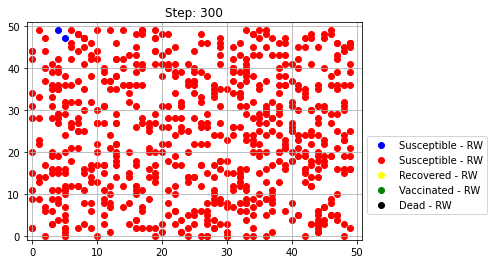

Healthy people= 2
Sick people= 681
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0

 Iteration 9


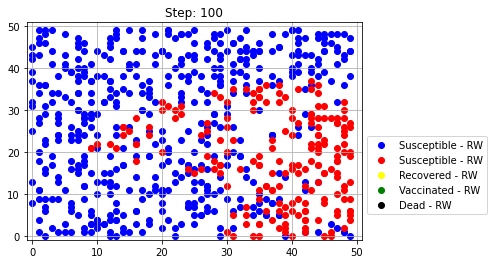

Healthy people= 490
Sick people= 193
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0


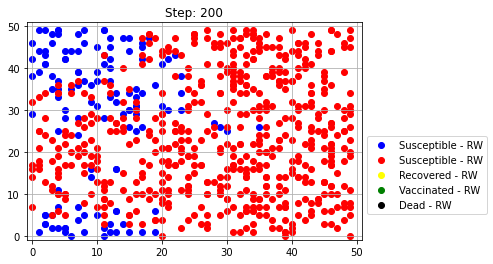

Healthy people= 125
Sick people= 558
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0


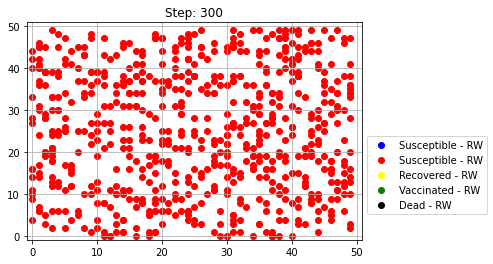

Healthy people= 0
Sick people= 683
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0

 Iteration 10


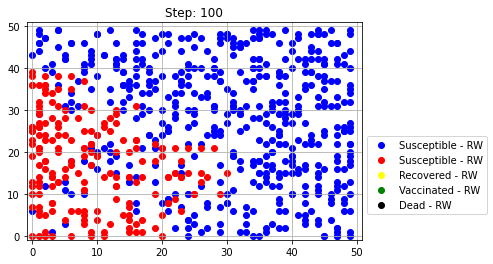

Healthy people= 493
Sick people= 190
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0


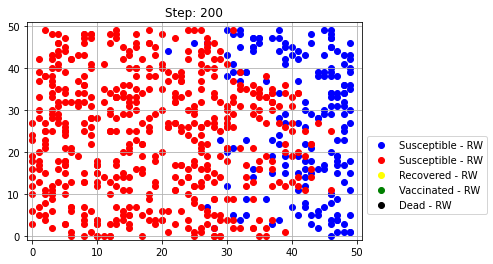

Healthy people= 174
Sick people= 509
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0


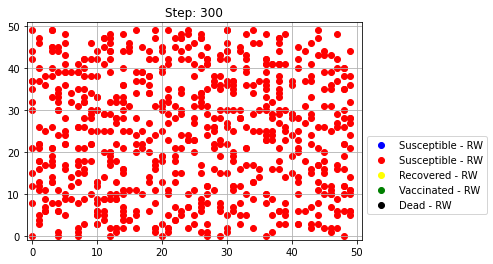

Healthy people= 0
Sick people= 683
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0

 Iteration 11


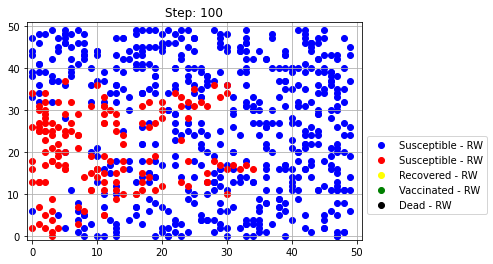

Healthy people= 531
Sick people= 152
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0


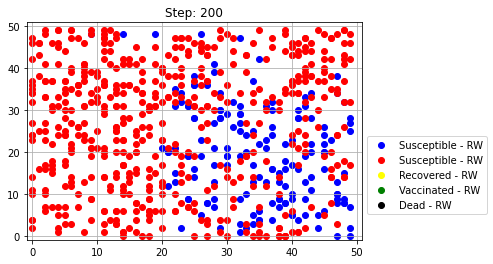

Healthy people= 155
Sick people= 528
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0


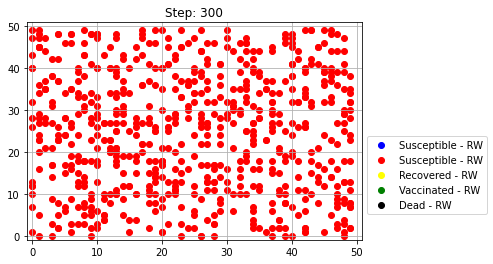

Healthy people= 0
Sick people= 683
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0

 Iteration 12


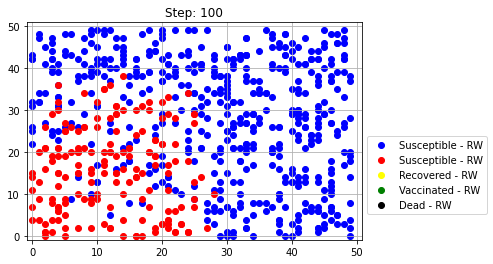

Healthy people= 504
Sick people= 179
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0


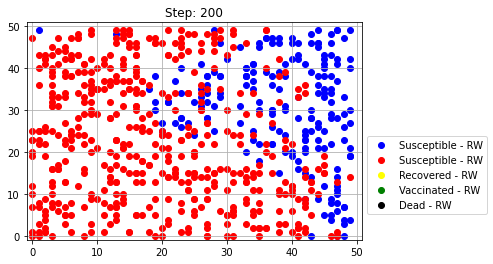

Healthy people= 188
Sick people= 495
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0


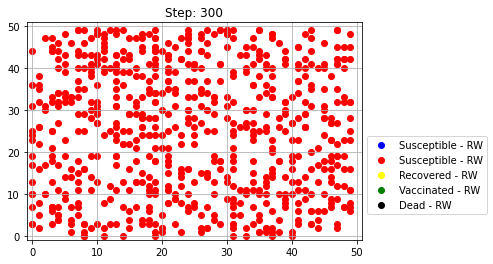

Healthy people= 0
Sick people= 683
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0

 Iteration 13


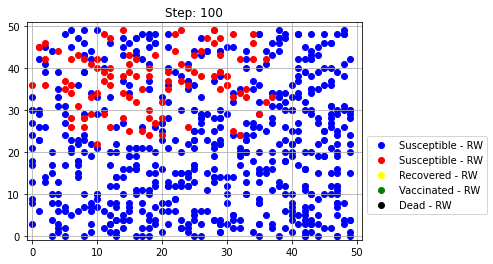

Healthy people= 578
Sick people= 105
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0


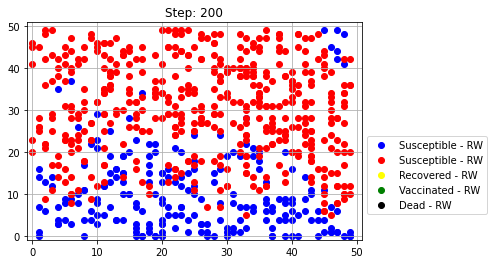

Healthy people= 215
Sick people= 468
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0


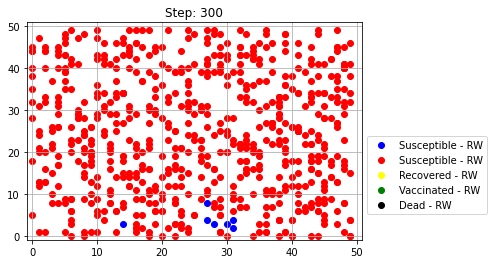

Healthy people= 7
Sick people= 676
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0

 Iteration 14


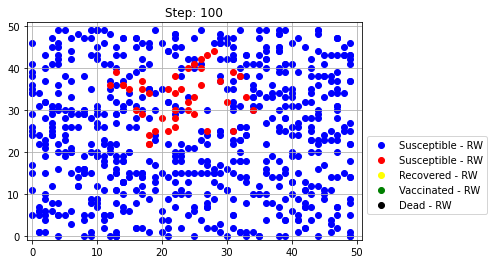

Healthy people= 636
Sick people= 47
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0


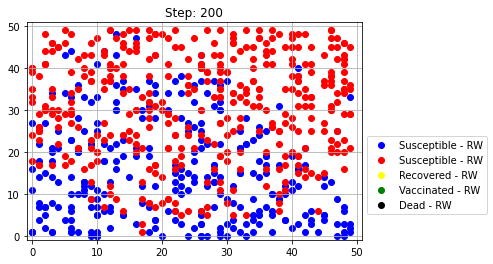

Healthy people= 280
Sick people= 403
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0


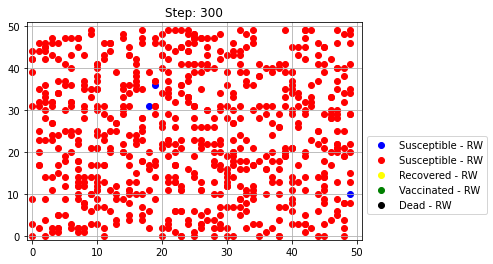

Healthy people= 3
Sick people= 680
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0

 Iteration 15


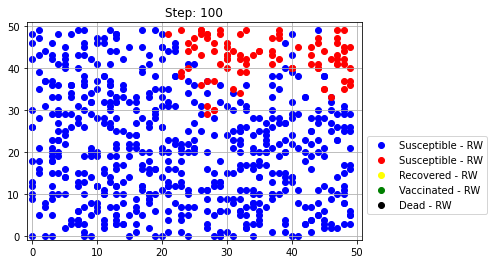

Healthy people= 590
Sick people= 93
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0


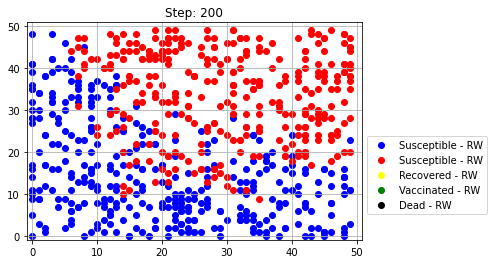

Healthy people= 352
Sick people= 331
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0


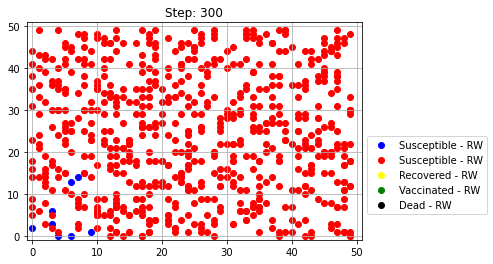

Healthy people= 8
Sick people= 675
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0

 Iteration 16


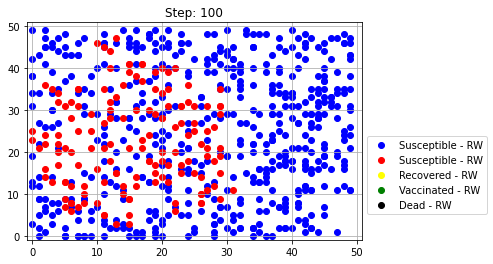

Healthy people= 533
Sick people= 150
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0


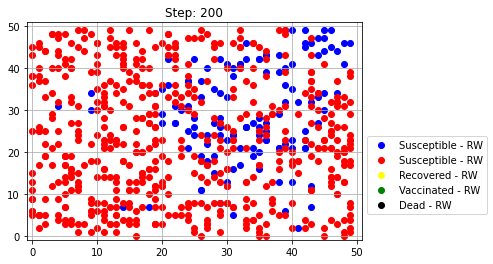

Healthy people= 122
Sick people= 561
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0


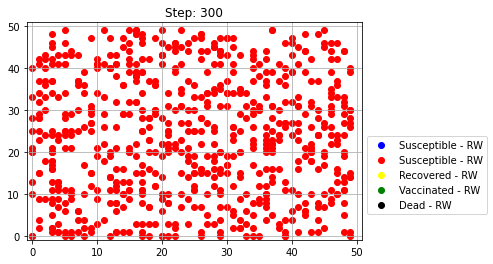

Healthy people= 0
Sick people= 683
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0

 Iteration 17


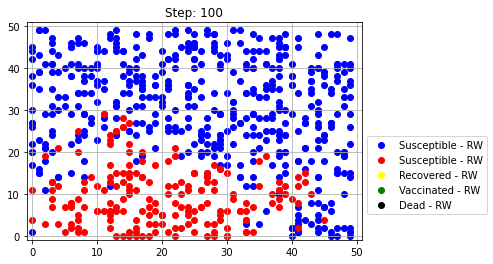

Healthy people= 490
Sick people= 193
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0


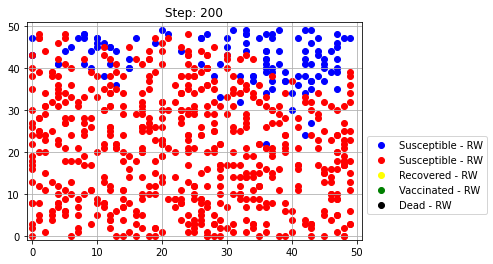

Healthy people= 113
Sick people= 570
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0


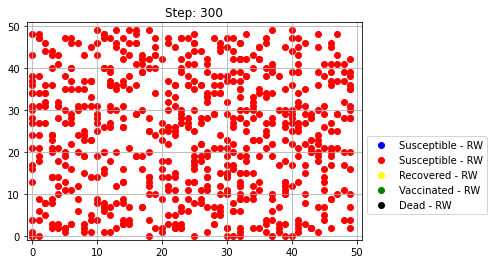

Healthy people= 0
Sick people= 683
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0

 Iteration 18


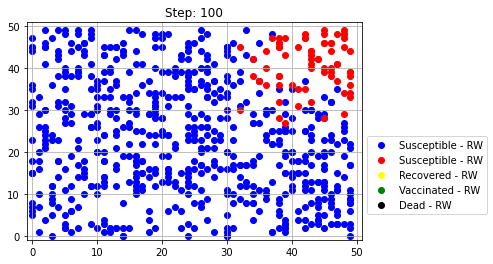

Healthy people= 609
Sick people= 74
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0


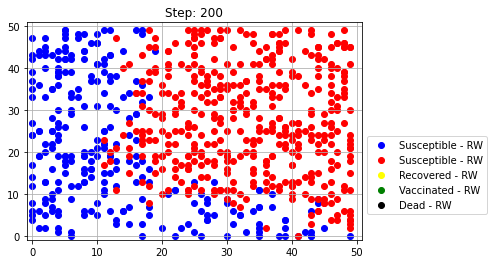

Healthy people= 259
Sick people= 424
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0


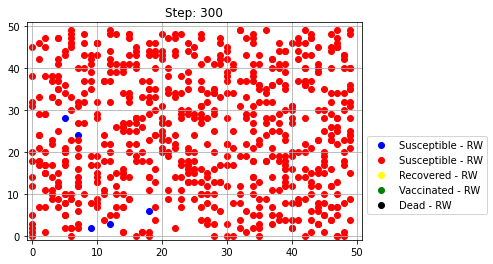

Healthy people= 5
Sick people= 678
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0

 Iteration 19


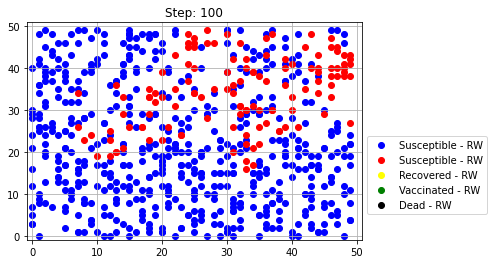

Healthy people= 555
Sick people= 128
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0


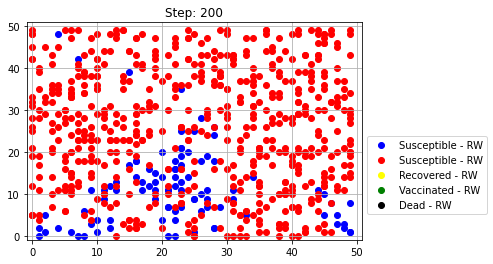

Healthy people= 93
Sick people= 590
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0


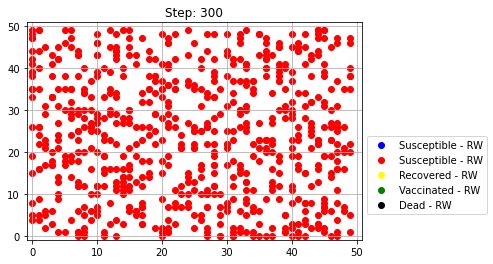

Healthy people= 0
Sick people= 683
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0

 Iteration 20


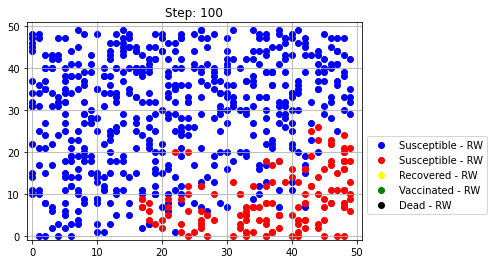

Healthy people= 542
Sick people= 141
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0


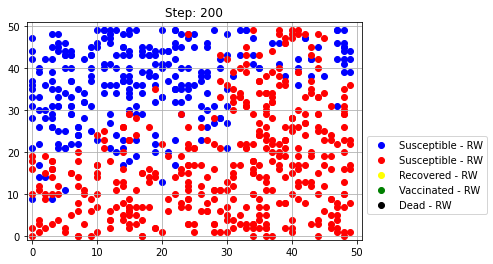

Healthy people= 269
Sick people= 414
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0


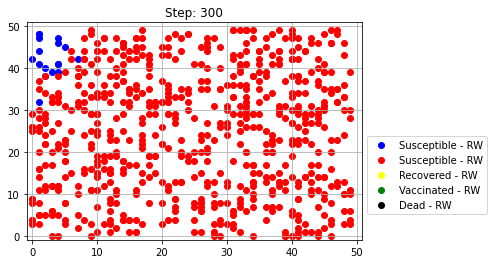

Healthy people= 16
Sick people= 667
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0

 Iteration 21


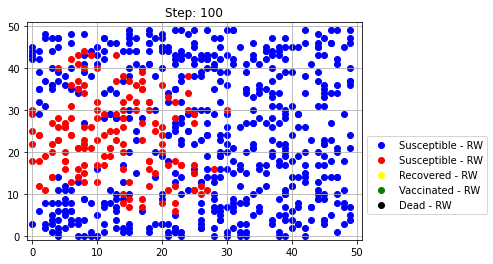

Healthy people= 533
Sick people= 150
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0


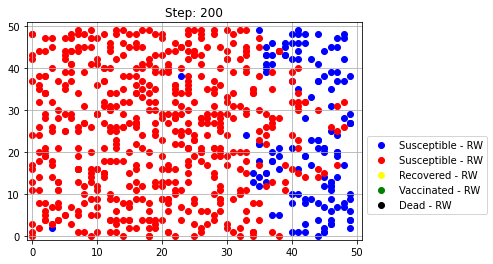

Healthy people= 131
Sick people= 552
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0


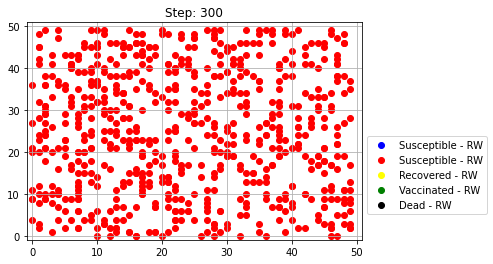

Healthy people= 0
Sick people= 683
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0

 Iteration 22


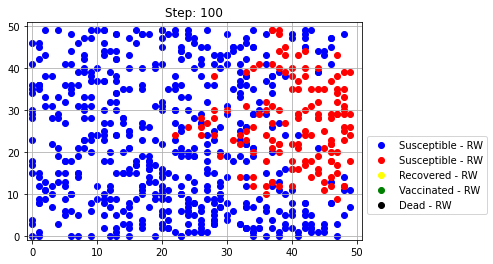

Healthy people= 546
Sick people= 137
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0


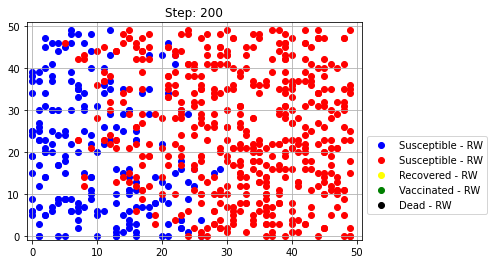

Healthy people= 200
Sick people= 483
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0


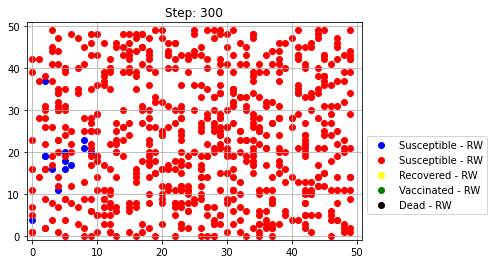

Healthy people= 13
Sick people= 670
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0

 Iteration 23


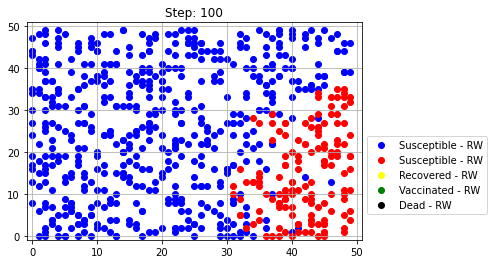

Healthy people= 540
Sick people= 143
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0


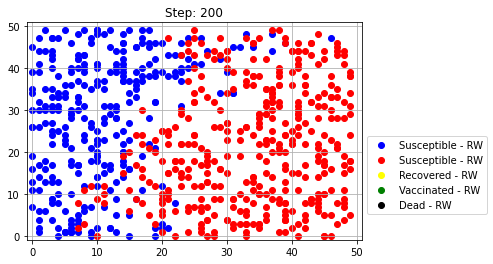

Healthy people= 291
Sick people= 392
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0


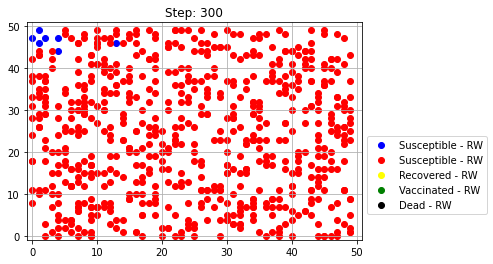

Healthy people= 7
Sick people= 676
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0

 Iteration 24


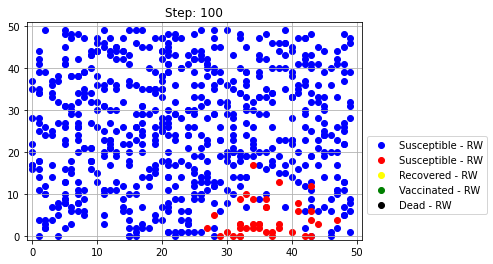

Healthy people= 644
Sick people= 39
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0


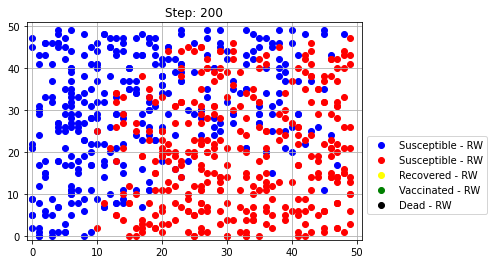

Healthy people= 335
Sick people= 348
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0


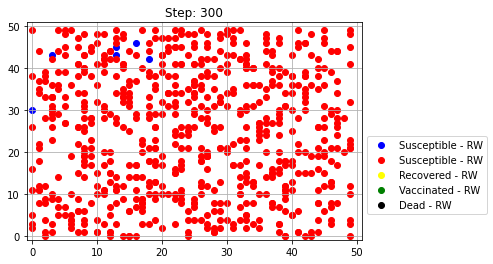

Healthy people= 6
Sick people= 677
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0

 Iteration 25


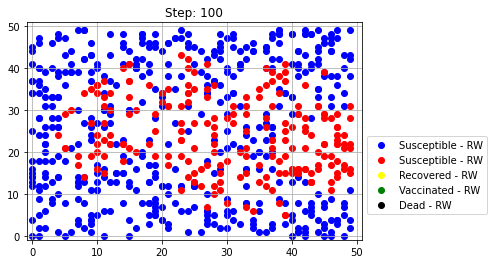

Healthy people= 467
Sick people= 216
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0


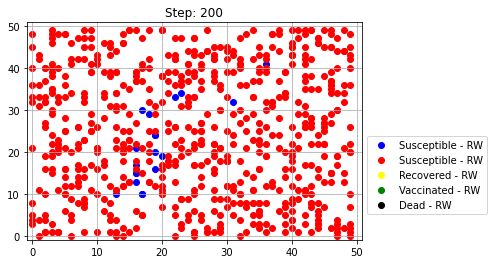

Healthy people= 19
Sick people= 664
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0


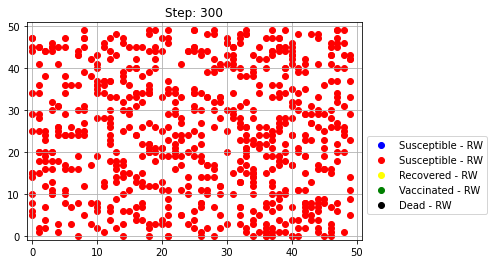

Healthy people= 0
Sick people= 683
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0

 Iteration 26


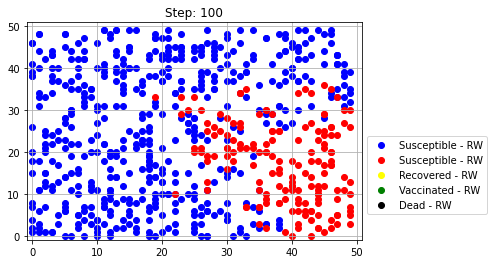

Healthy people= 513
Sick people= 170
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0


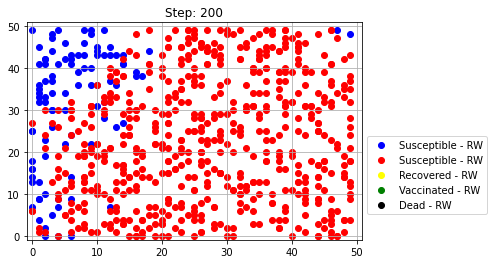

Healthy people= 92
Sick people= 591
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0


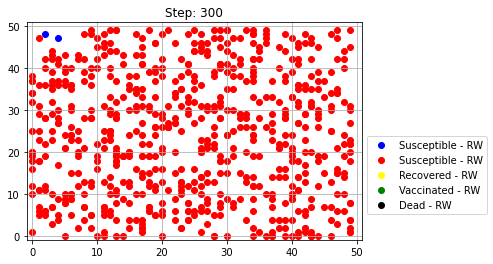

Healthy people= 2
Sick people= 681
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0

 Iteration 27


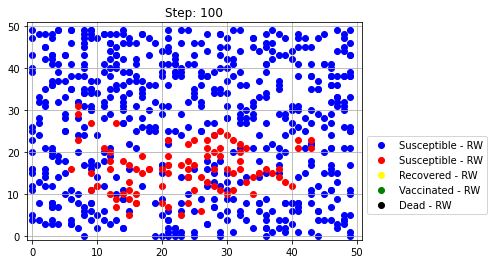

Healthy people= 587
Sick people= 96
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0


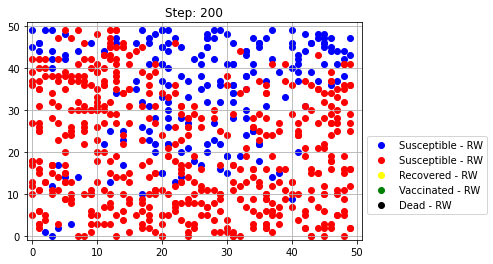

Healthy people= 191
Sick people= 492
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0


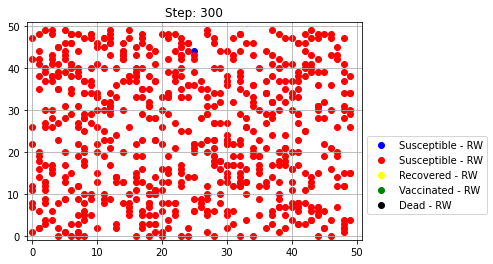

Healthy people= 1
Sick people= 682
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0

 Iteration 28


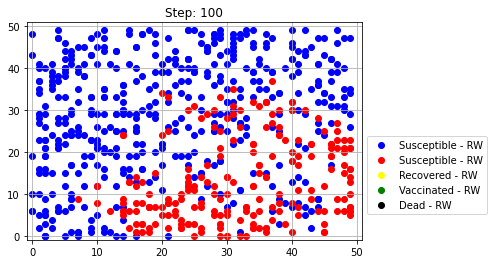

Healthy people= 463
Sick people= 220
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0


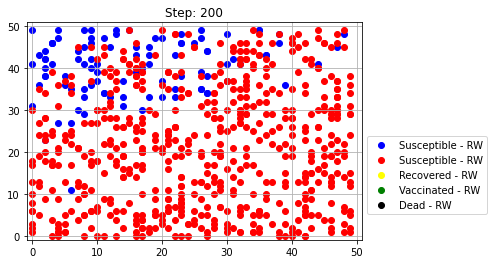

Healthy people= 94
Sick people= 589
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0


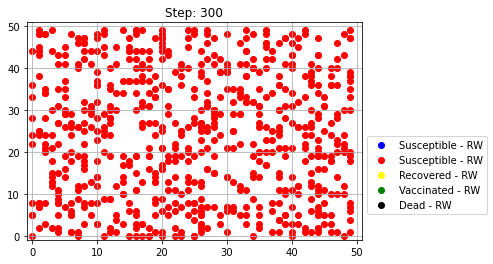

Healthy people= 0
Sick people= 683
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0

 Iteration 29


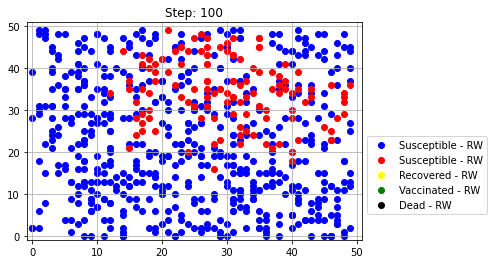

Healthy people= 555
Sick people= 128
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0


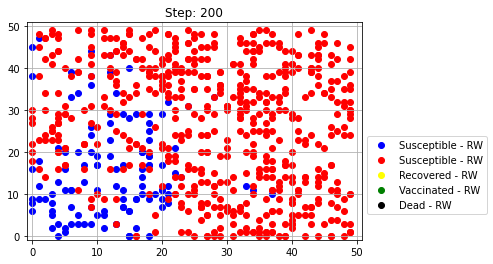

Healthy people= 110
Sick people= 573
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0


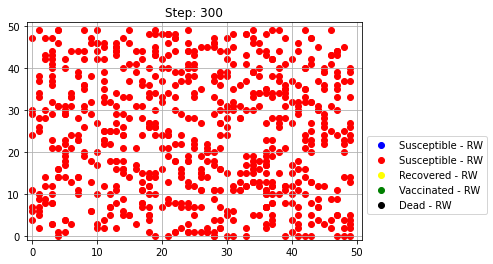

Healthy people= 0
Sick people= 683
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0

 Iteration 30


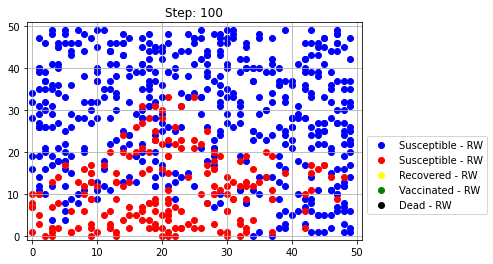

Healthy people= 487
Sick people= 196
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0


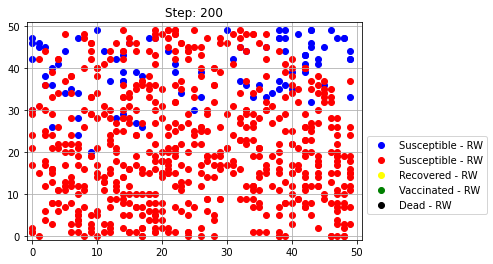

Healthy people= 83
Sick people= 600
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0


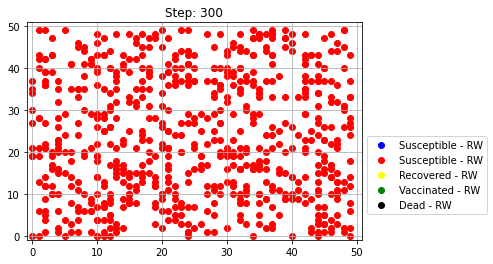

Healthy people= 0
Sick people= 683
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0

 Iteration 31


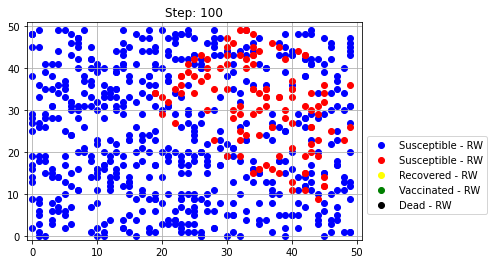

Healthy people= 564
Sick people= 119
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0


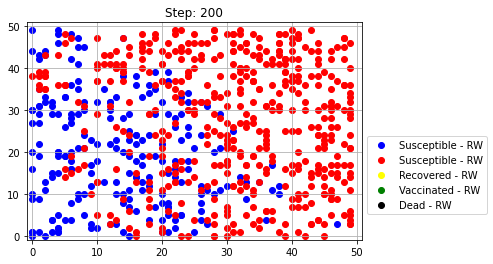

Healthy people= 207
Sick people= 476
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0


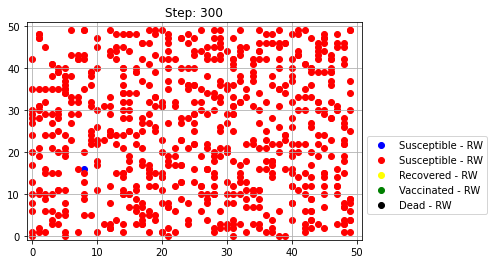

Healthy people= 1
Sick people= 682
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0

 Iteration 32


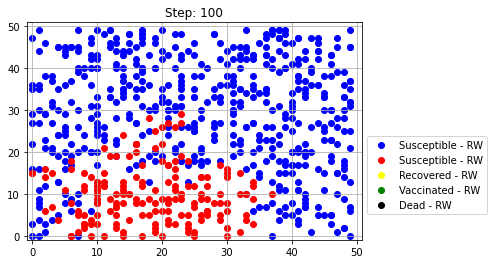

Healthy people= 511
Sick people= 172
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0


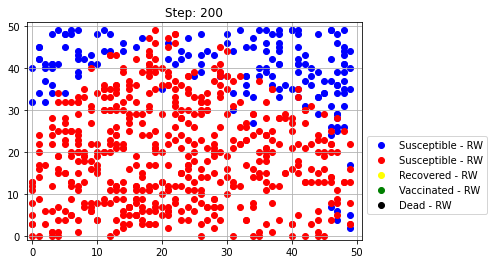

Healthy people= 159
Sick people= 524
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0


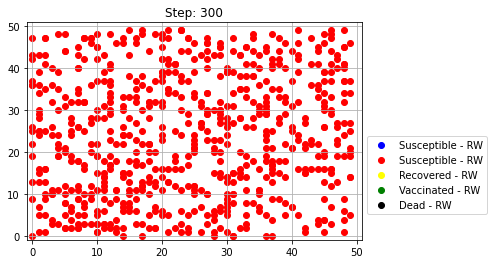

Healthy people= 0
Sick people= 683
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0

 Iteration 33


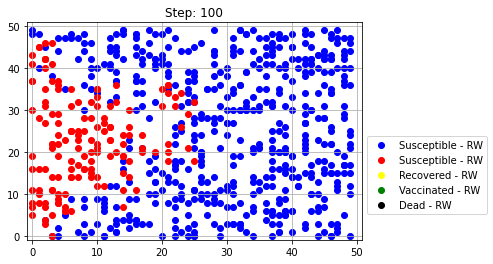

Healthy people= 531
Sick people= 152
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0


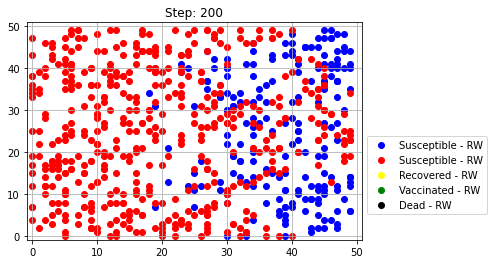

Healthy people= 194
Sick people= 489
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0


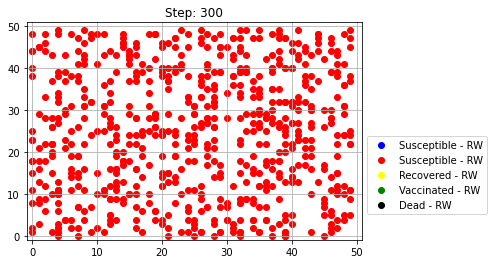

Healthy people= 0
Sick people= 683
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0

 Iteration 34


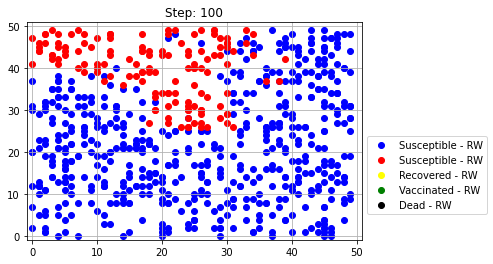

Healthy people= 542
Sick people= 141
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0


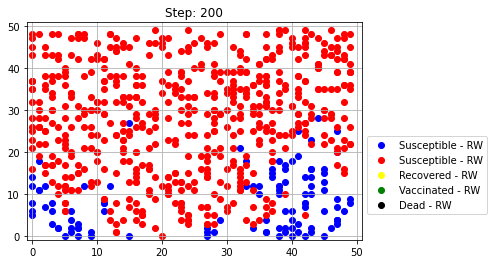

Healthy people= 105
Sick people= 578
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0


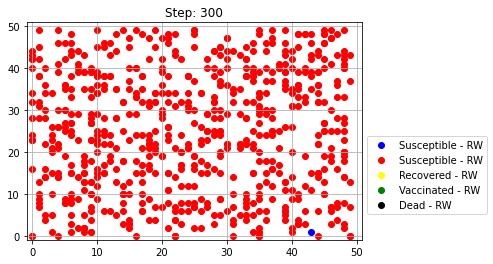

Healthy people= 1
Sick people= 682
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0

 Iteration 35


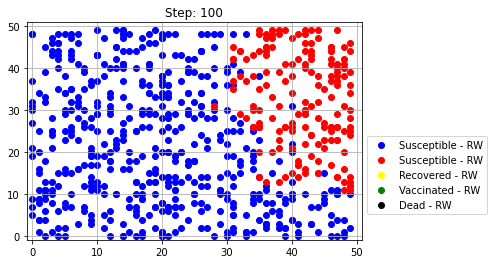

Healthy people= 512
Sick people= 171
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0


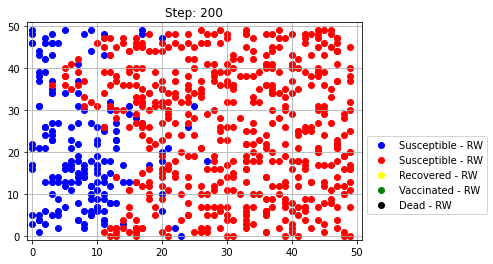

Healthy people= 169
Sick people= 514
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0


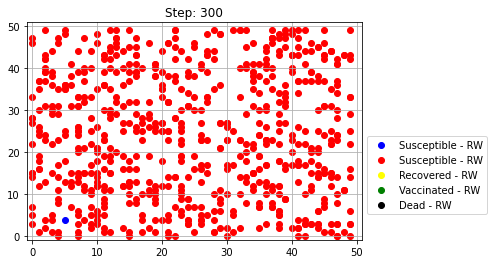

Healthy people= 1
Sick people= 682
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0

 Iteration 36


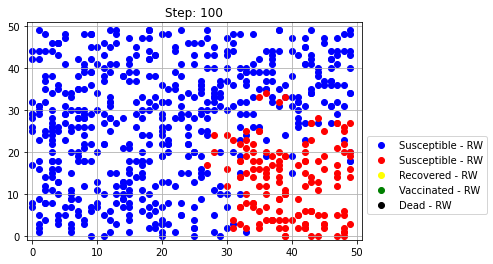

Healthy people= 538
Sick people= 145
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0


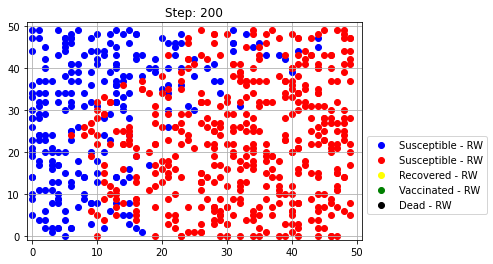

Healthy people= 238
Sick people= 445
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0


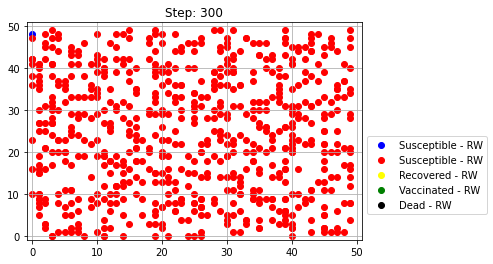

Healthy people= 1
Sick people= 682
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0

 Iteration 37


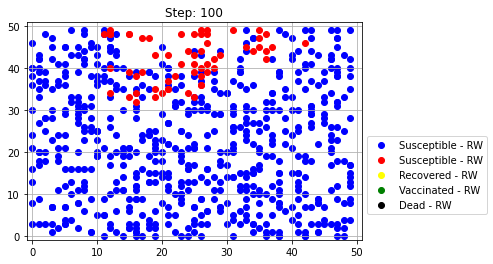

Healthy people= 619
Sick people= 64
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0


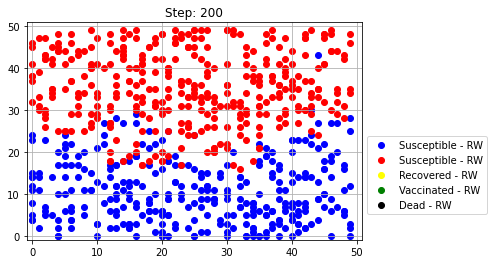

Healthy people= 317
Sick people= 366
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0


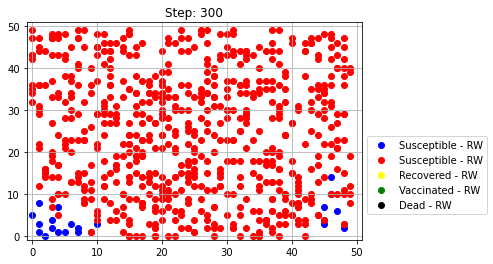

Healthy people= 20
Sick people= 663
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0

 Iteration 38


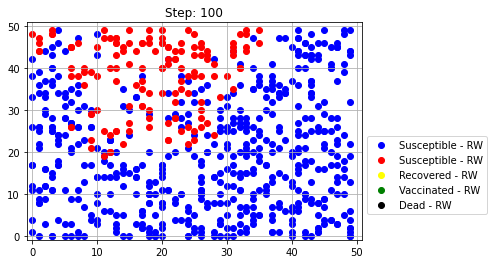

Healthy people= 538
Sick people= 145
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0


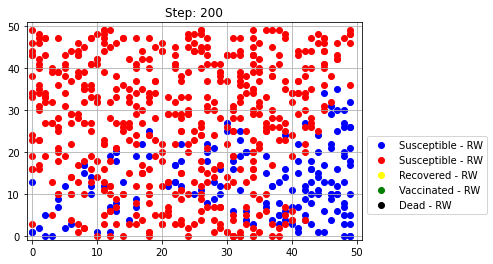

Healthy people= 161
Sick people= 522
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0


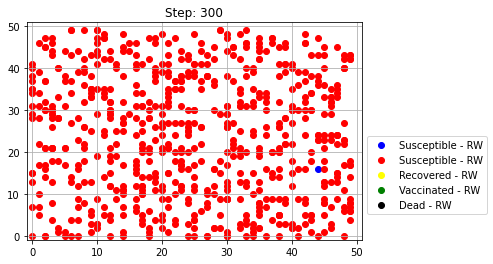

Healthy people= 1
Sick people= 682
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0

 Iteration 39


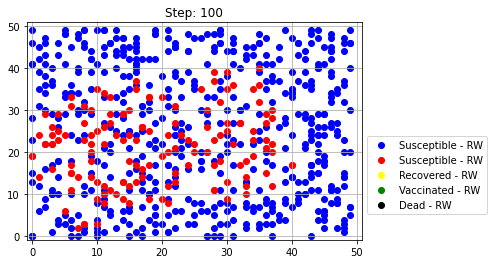

Healthy people= 536
Sick people= 147
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0


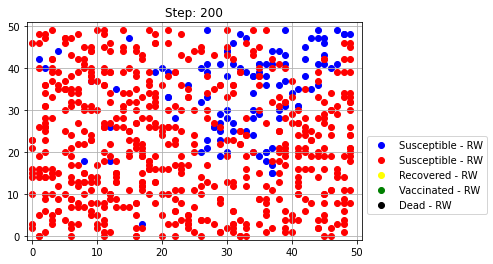

Healthy people= 103
Sick people= 580
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0


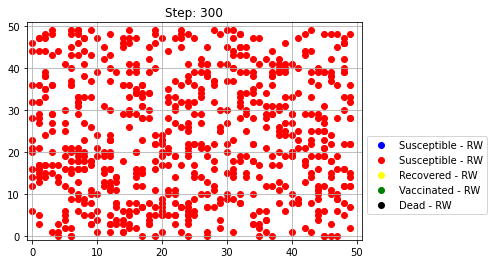

Healthy people= 0
Sick people= 683
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0

 Iteration 40


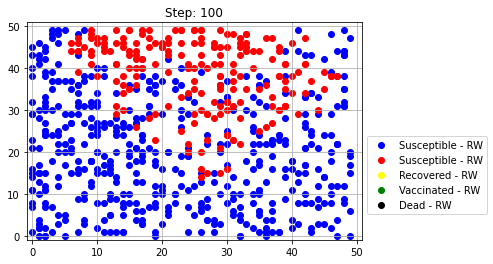

Healthy people= 481
Sick people= 202
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0


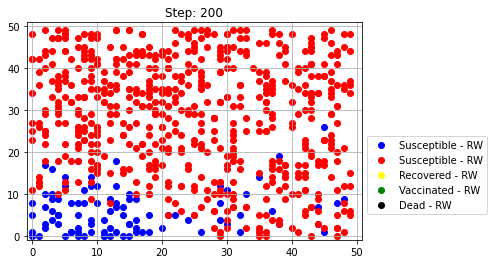

Healthy people= 89
Sick people= 594
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0


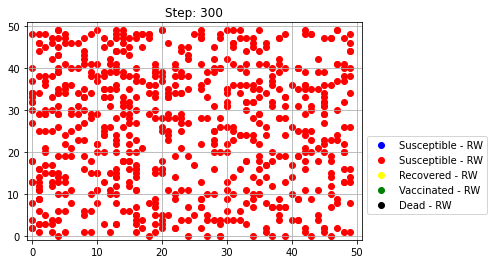

Healthy people= 0
Sick people= 683
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0

 Iteration 41


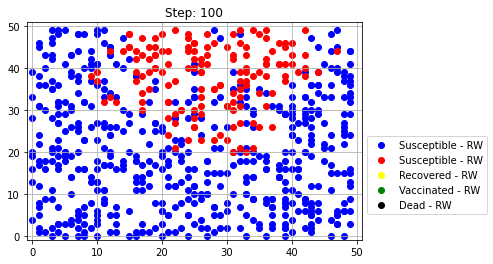

Healthy people= 530
Sick people= 153
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0


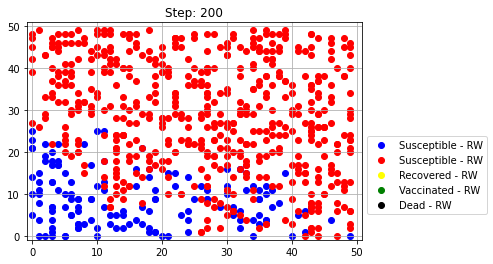

Healthy people= 136
Sick people= 547
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0


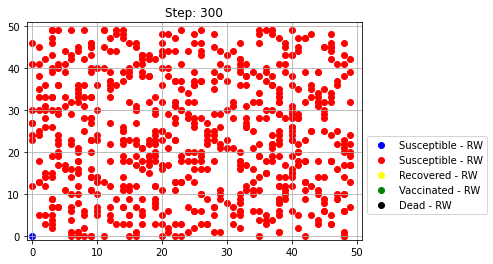

Healthy people= 1
Sick people= 682
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0

 Iteration 42


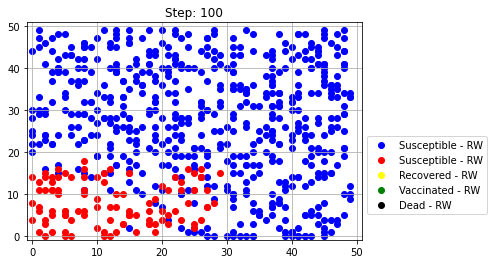

Healthy people= 574
Sick people= 109
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0


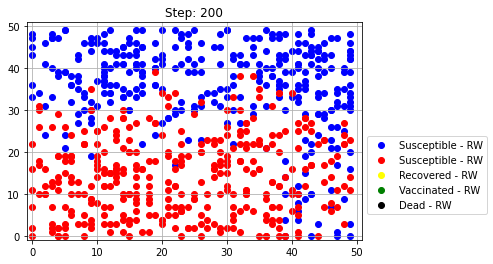

Healthy people= 322
Sick people= 361
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0


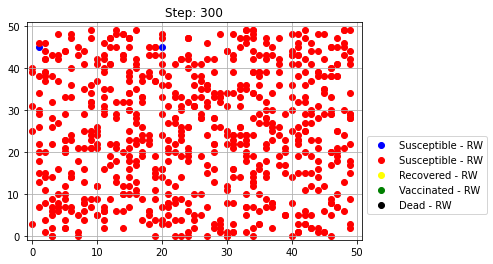

Healthy people= 2
Sick people= 681
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0

 Iteration 43


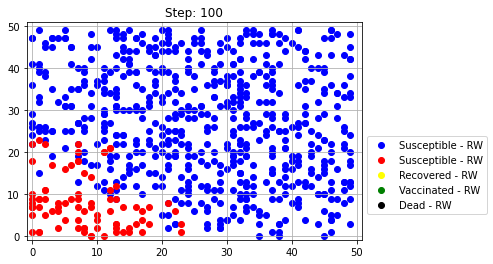

Healthy people= 596
Sick people= 87
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0


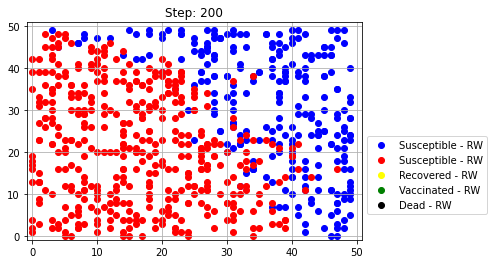

Healthy people= 255
Sick people= 428
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0


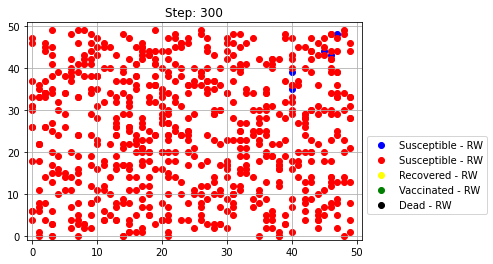

Healthy people= 5
Sick people= 678
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0

 Iteration 44


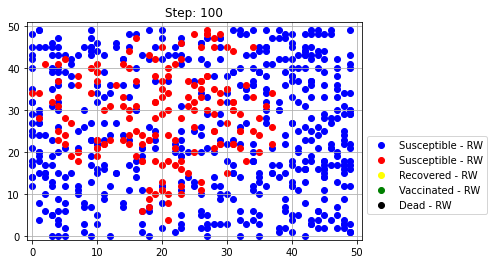

Healthy people= 515
Sick people= 168
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0


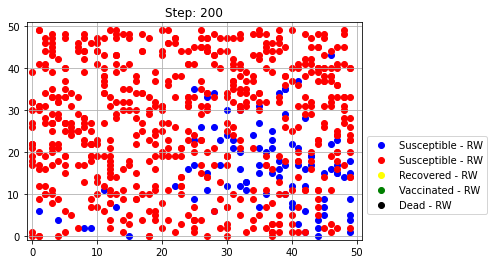

Healthy people= 90
Sick people= 593
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0


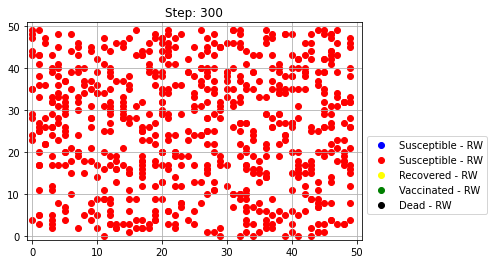

Healthy people= 0
Sick people= 683
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0

 Iteration 45


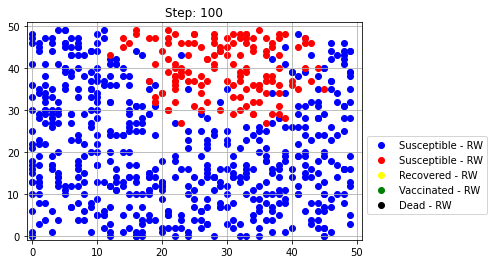

Healthy people= 544
Sick people= 139
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0


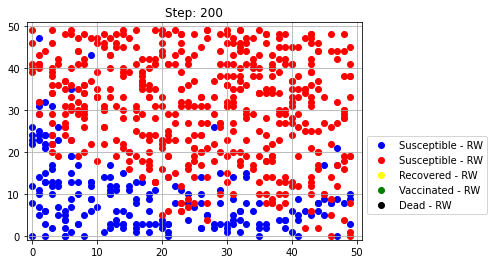

Healthy people= 188
Sick people= 495
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0


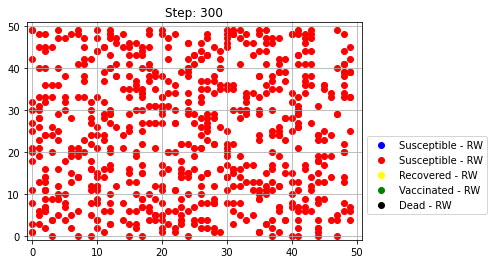

Healthy people= 0
Sick people= 683
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0

 Iteration 46


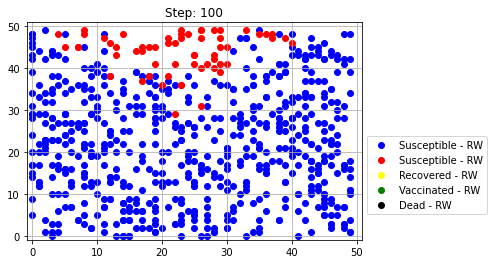

Healthy people= 621
Sick people= 62
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0


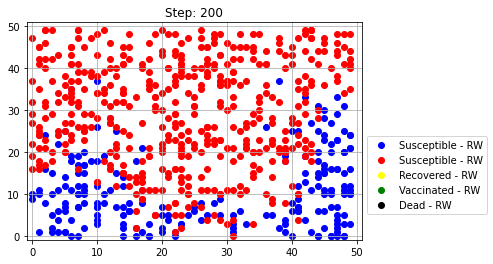

Healthy people= 204
Sick people= 479
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0


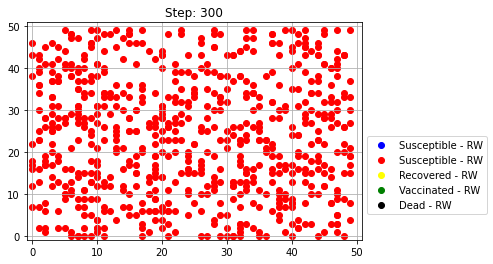

Healthy people= 0
Sick people= 683
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0

 Iteration 47


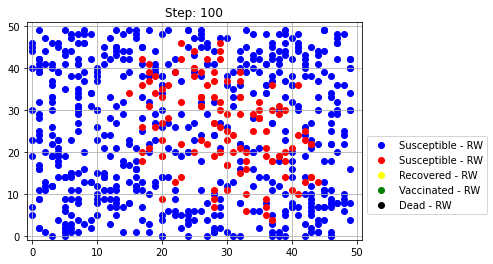

Healthy people= 559
Sick people= 124
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0


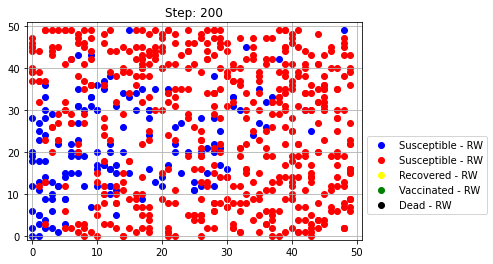

Healthy people= 145
Sick people= 538
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0


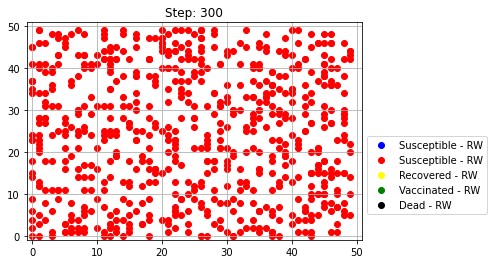

Healthy people= 0
Sick people= 683
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0

 Iteration 48


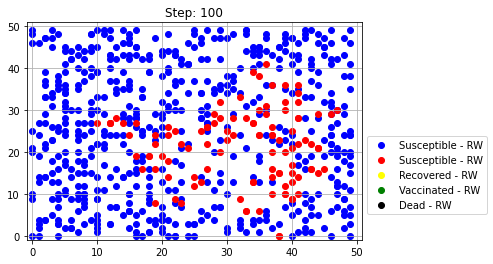

Healthy people= 570
Sick people= 113
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0


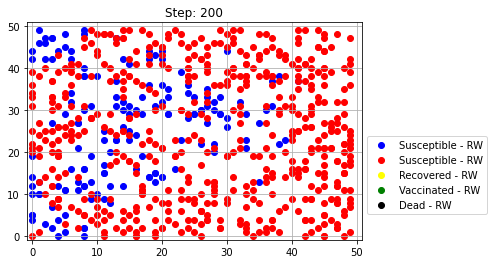

Healthy people= 152
Sick people= 531
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0


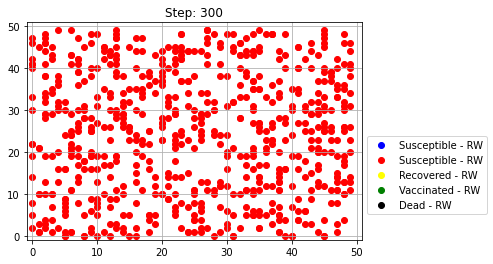

Healthy people= 0
Sick people= 683
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0

 Iteration 49


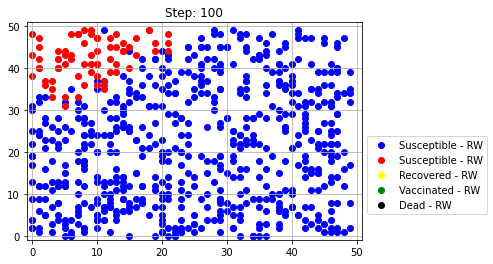

Healthy people= 611
Sick people= 72
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0


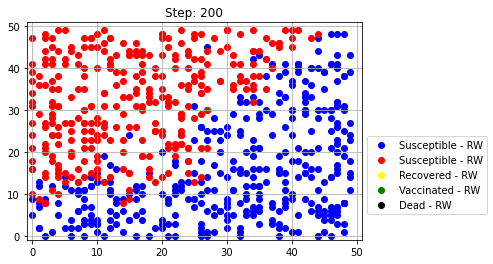

Healthy people= 367
Sick people= 316
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0


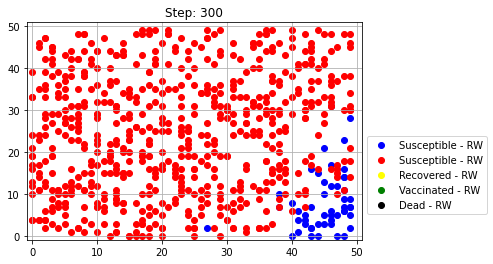

Healthy people= 47
Sick people= 636
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0

 Iteration 50


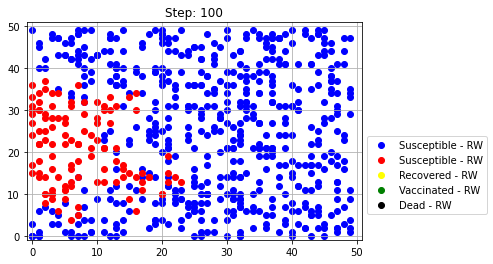

Healthy people= 564
Sick people= 119
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0


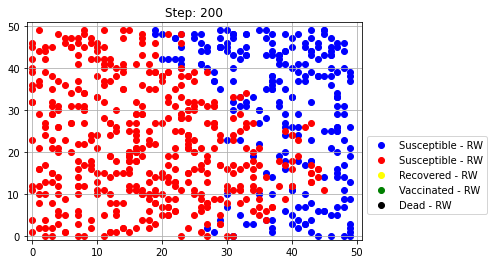

Healthy people= 231
Sick people= 452
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0


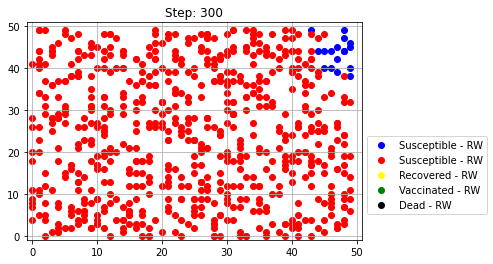

Healthy people= 17
Sick people= 666
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0


In [4]:
inf, sus,rec,vac,dea=np.array([]),np.array([]), np.array([]), np.array([]), np.array([])
n,m=50,300# n is number of iterations and m is time step
for i in range(0,n):
    print('\n Iteration {}'.format(i+1))
    ex2p1 = RandomWalkEpidemicSimulator(population_size=683,no_init_infected=1,nx=50, ny=50, 
                                        p_infected=0.9,plot_radomwalk=True,plot_mean=True,plot_mean10=True,plot_beta=True) 
    inf_temp, sus_temp,rec_temp,vac_temp,dea_temp=ex2p1.simulatior_every_step(m)
    inf=np.append(inf,inf_temp)
    sus=np.append(sus,sus_temp)
    rec=np.append(rec,rec_temp)
    vac=np.append(vac,vac_temp)
    dea=np.append(dea,dea_temp)

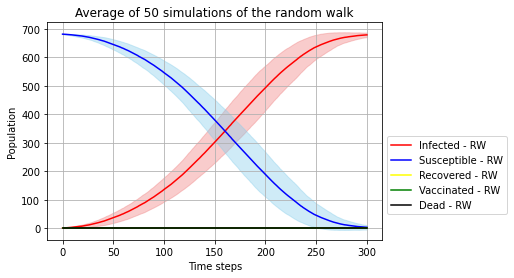

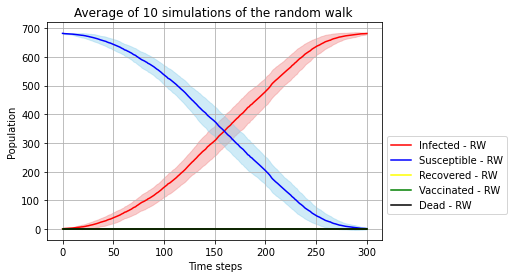

In [5]:
# Mean and SD plot of Susseptible and infected people
ex2p1.SI_mean_sd_plot(inf,sus,rec,vac,dea ,m+1)

## Part 2:
- Repeat the exercise when $I_0$=10

**Solution:**


 Iteration 1


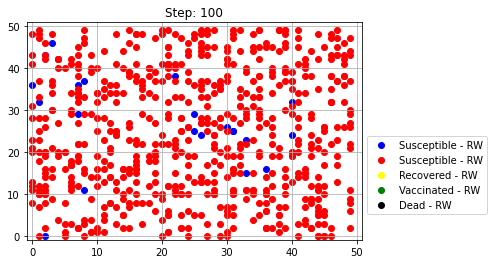

Healthy people= 20
Sick people= 663
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0


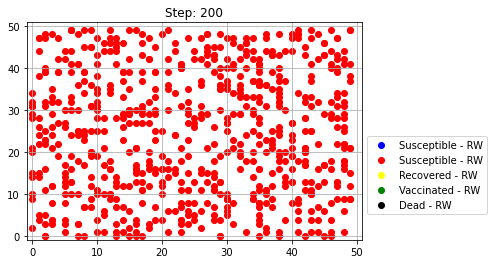

Healthy people= 0
Sick people= 683
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0


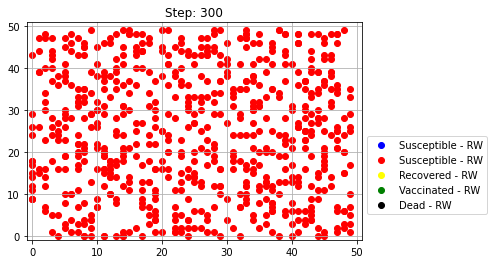

Healthy people= 0
Sick people= 683
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0

 Iteration 2


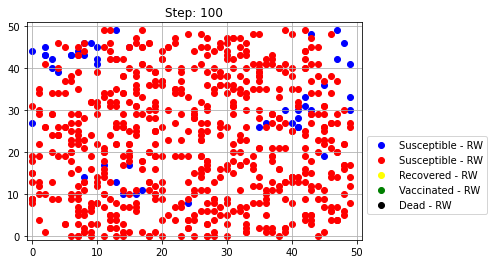

Healthy people= 45
Sick people= 638
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0


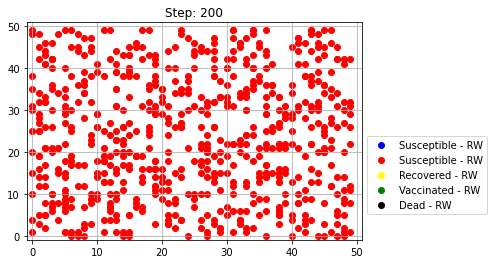

Healthy people= 0
Sick people= 683
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0


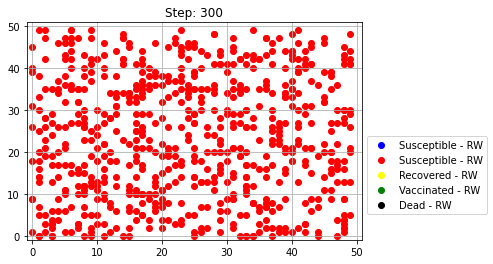

Healthy people= 0
Sick people= 683
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0

 Iteration 3


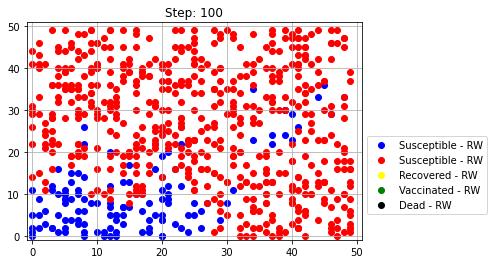

Healthy people= 116
Sick people= 567
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0


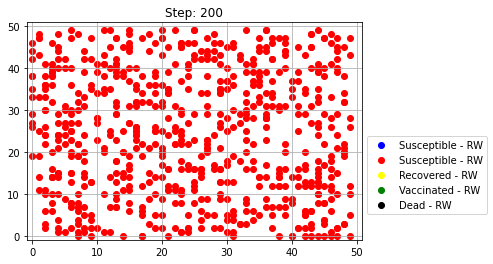

Healthy people= 0
Sick people= 683
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0


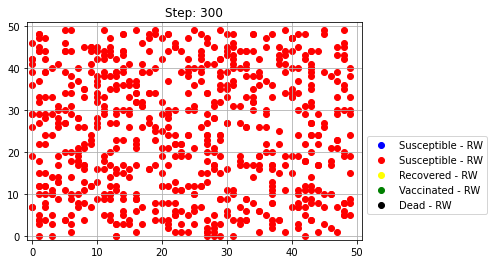

Healthy people= 0
Sick people= 683
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0

 Iteration 4


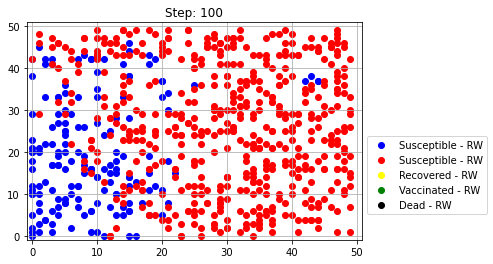

Healthy people= 161
Sick people= 522
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0


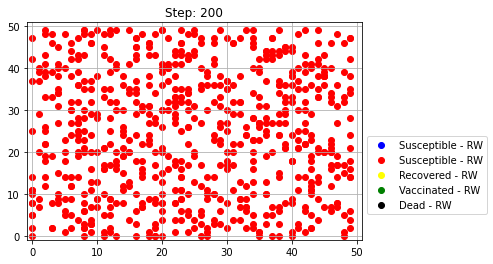

Healthy people= 0
Sick people= 683
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0


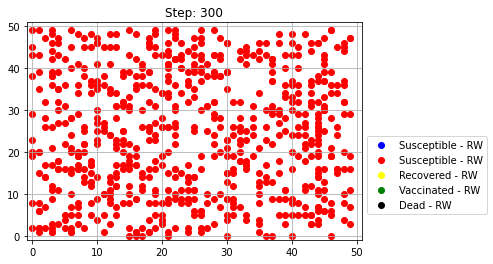

Healthy people= 0
Sick people= 683
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0

 Iteration 5


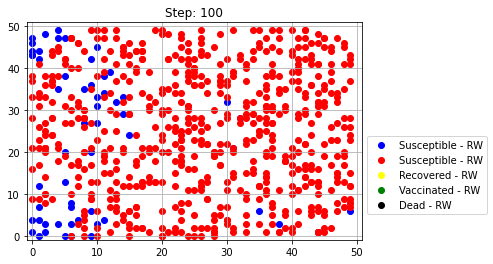

Healthy people= 54
Sick people= 629
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0


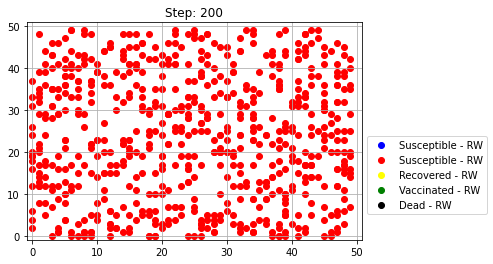

Healthy people= 0
Sick people= 683
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0


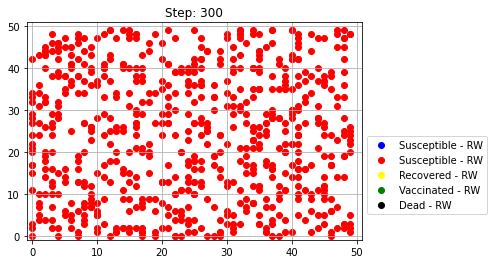

Healthy people= 0
Sick people= 683
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0

 Iteration 6


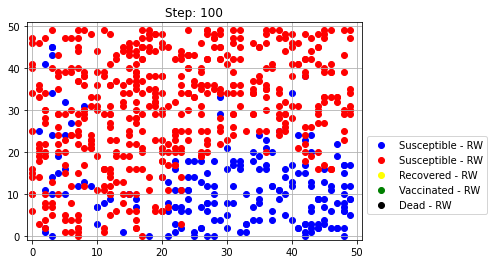

Healthy people= 183
Sick people= 500
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0


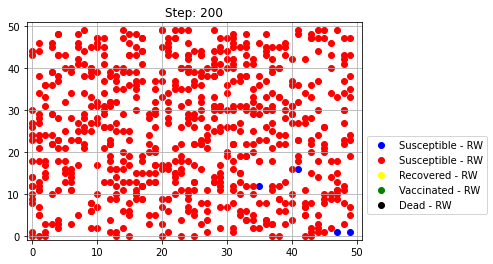

Healthy people= 4
Sick people= 679
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0


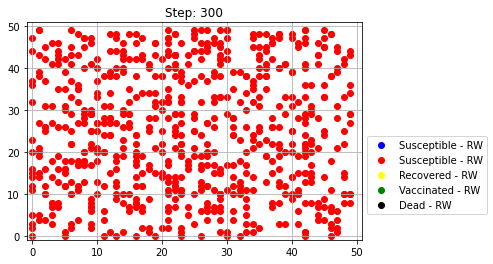

Healthy people= 0
Sick people= 683
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0

 Iteration 7


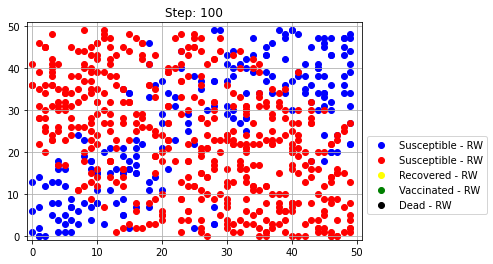

Healthy people= 197
Sick people= 486
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0


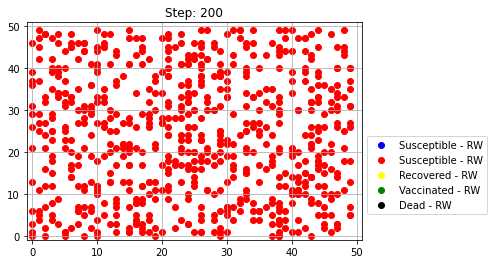

Healthy people= 0
Sick people= 683
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0


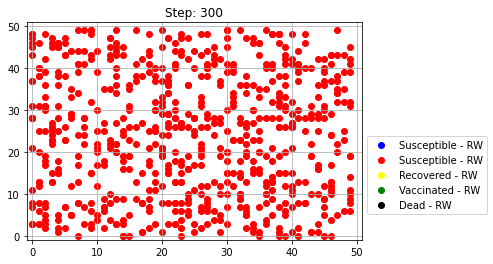

Healthy people= 0
Sick people= 683
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0

 Iteration 8


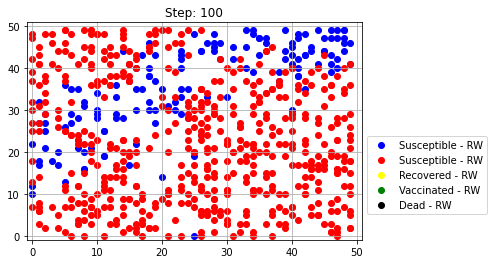

Healthy people= 139
Sick people= 544
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0


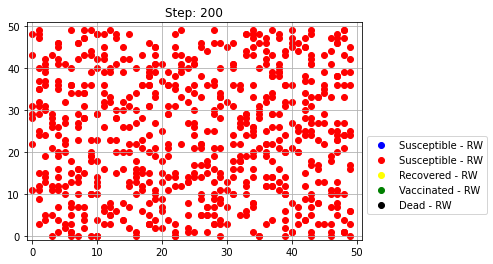

Healthy people= 0
Sick people= 683
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0


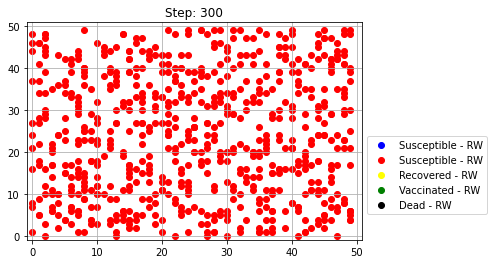

Healthy people= 0
Sick people= 683
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0

 Iteration 9


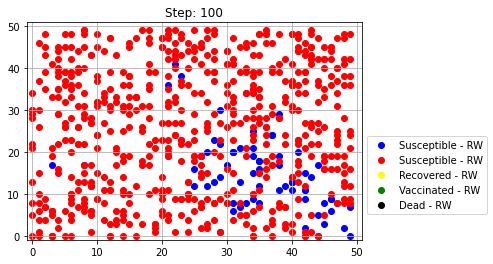

Healthy people= 63
Sick people= 620
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0


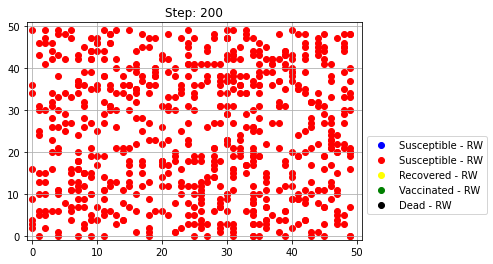

Healthy people= 0
Sick people= 683
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0


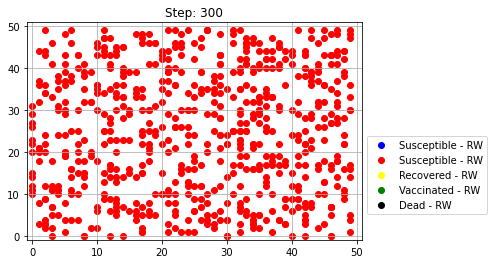

Healthy people= 0
Sick people= 683
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0

 Iteration 10


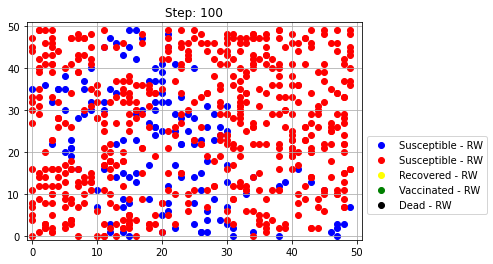

Healthy people= 131
Sick people= 552
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0


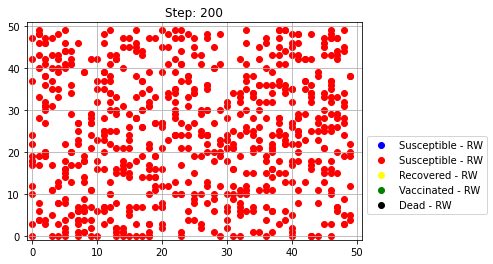

Healthy people= 0
Sick people= 683
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0


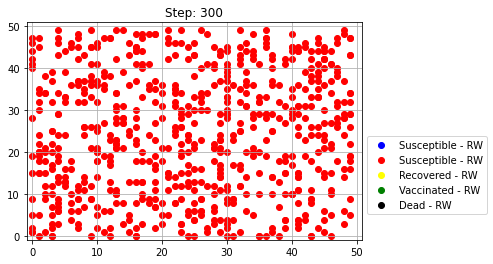

Healthy people= 0
Sick people= 683
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0

 Iteration 11


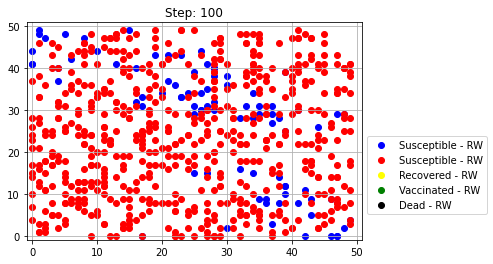

Healthy people= 79
Sick people= 604
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0


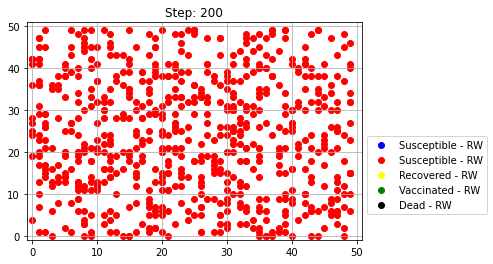

Healthy people= 0
Sick people= 683
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0


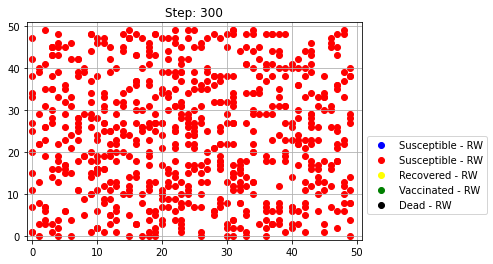

Healthy people= 0
Sick people= 683
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0

 Iteration 12


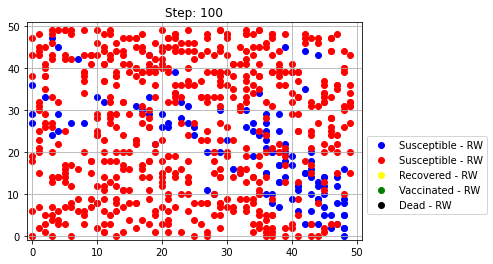

Healthy people= 110
Sick people= 573
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0


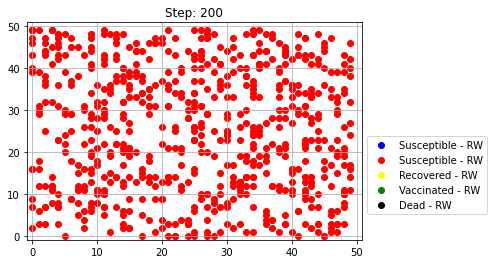

Healthy people= 0
Sick people= 683
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0


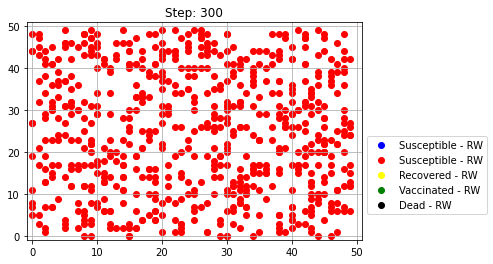

Healthy people= 0
Sick people= 683
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0

 Iteration 13


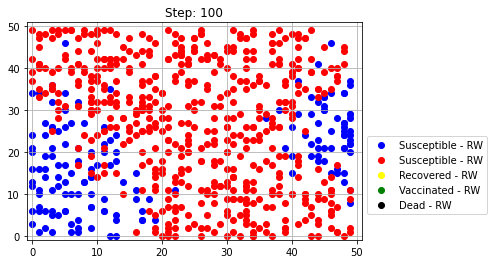

Healthy people= 155
Sick people= 528
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0


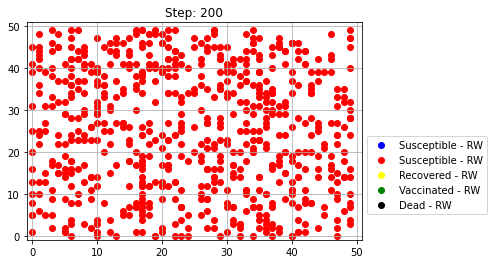

Healthy people= 0
Sick people= 683
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0


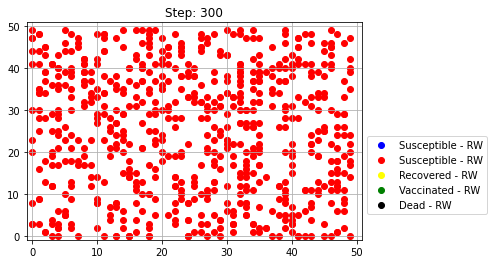

Healthy people= 0
Sick people= 683
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0

 Iteration 14


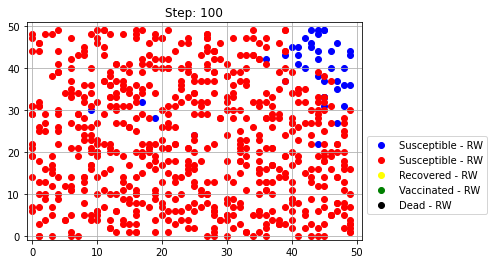

Healthy people= 38
Sick people= 645
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0


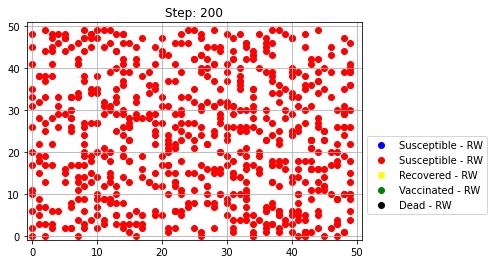

Healthy people= 0
Sick people= 683
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0


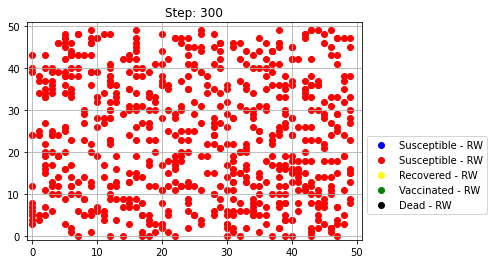

Healthy people= 0
Sick people= 683
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0

 Iteration 15


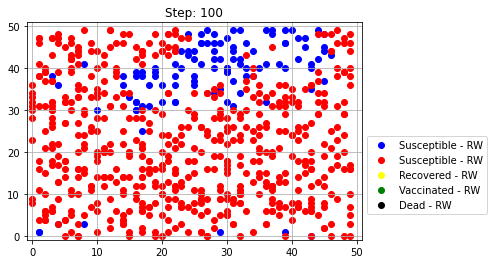

Healthy people= 104
Sick people= 579
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0


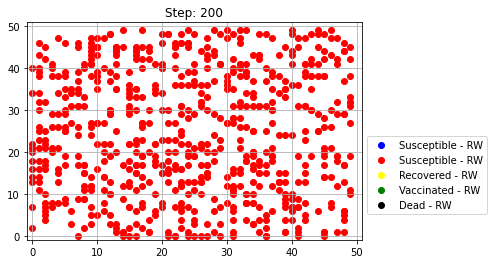

Healthy people= 0
Sick people= 683
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0


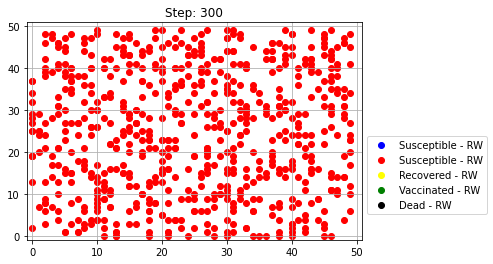

Healthy people= 0
Sick people= 683
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0

 Iteration 16


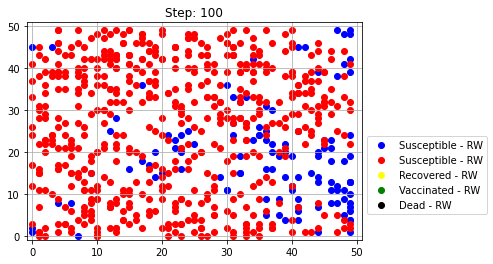

Healthy people= 108
Sick people= 575
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0


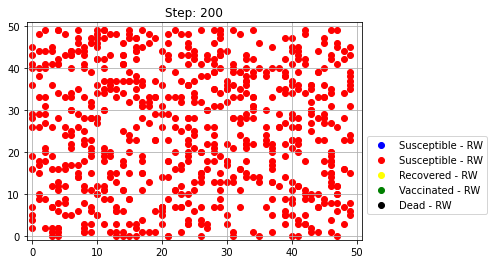

Healthy people= 0
Sick people= 683
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0


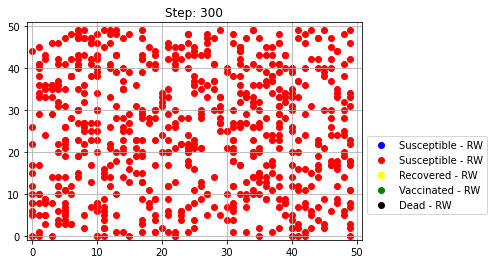

Healthy people= 0
Sick people= 683
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0

 Iteration 17


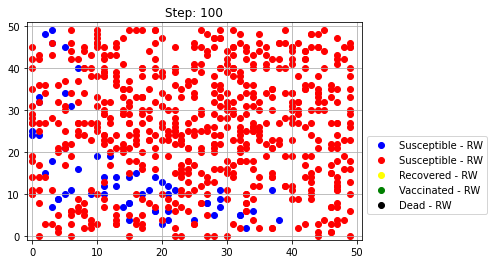

Healthy people= 57
Sick people= 626
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0


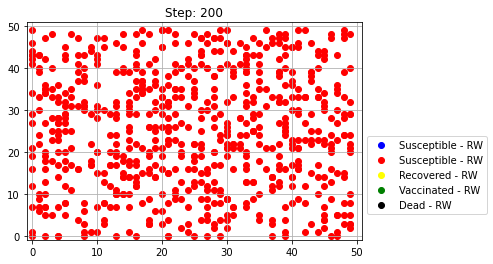

Healthy people= 0
Sick people= 683
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0


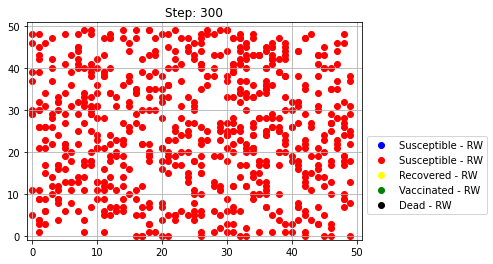

Healthy people= 0
Sick people= 683
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0

 Iteration 18


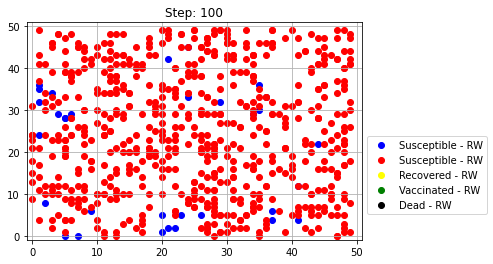

Healthy people= 28
Sick people= 655
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0


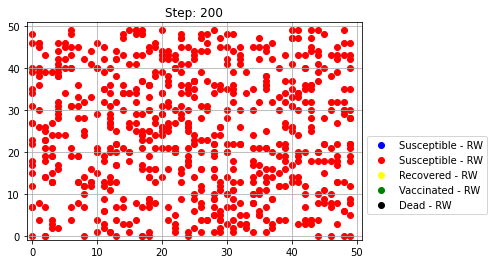

Healthy people= 0
Sick people= 683
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0


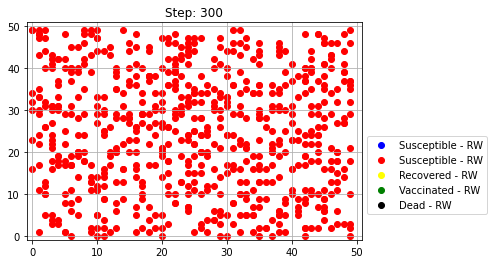

Healthy people= 0
Sick people= 683
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0

 Iteration 19


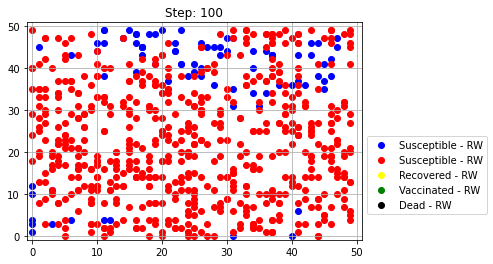

Healthy people= 79
Sick people= 604
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0


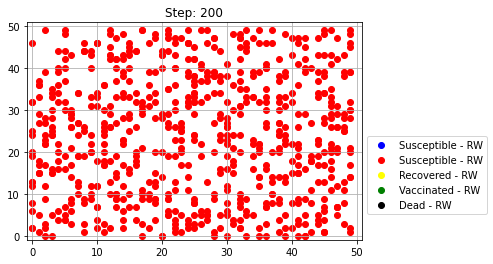

Healthy people= 0
Sick people= 683
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0


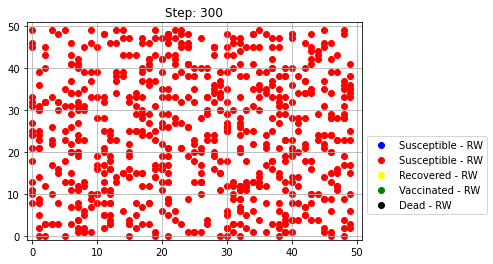

Healthy people= 0
Sick people= 683
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0

 Iteration 20


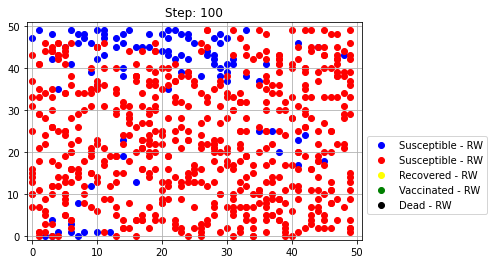

Healthy people= 90
Sick people= 593
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0


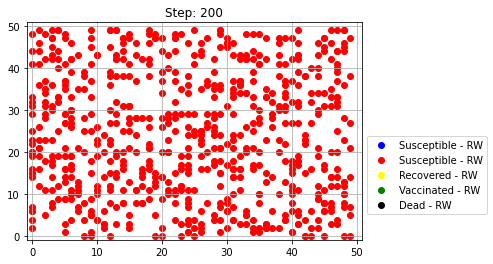

Healthy people= 0
Sick people= 683
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0


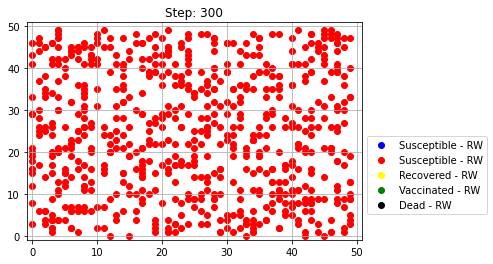

Healthy people= 0
Sick people= 683
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0

 Iteration 21


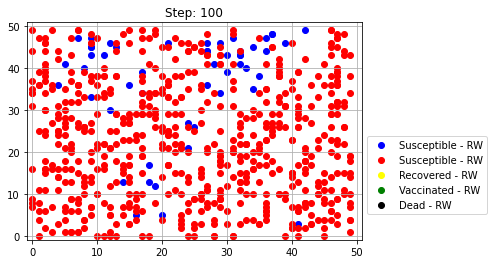

Healthy people= 49
Sick people= 634
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0


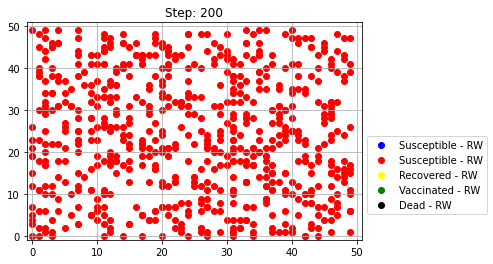

Healthy people= 0
Sick people= 683
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0


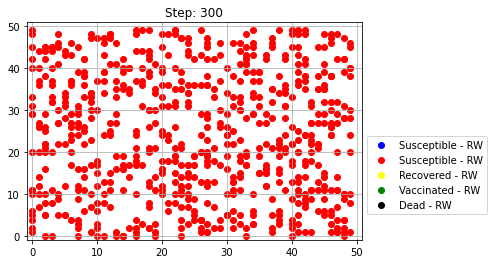

Healthy people= 0
Sick people= 683
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0

 Iteration 22


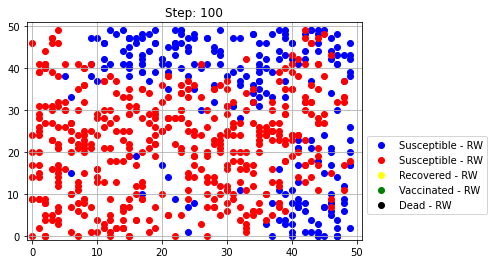

Healthy people= 228
Sick people= 455
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0


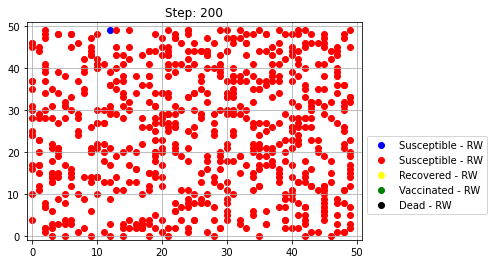

Healthy people= 1
Sick people= 682
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0


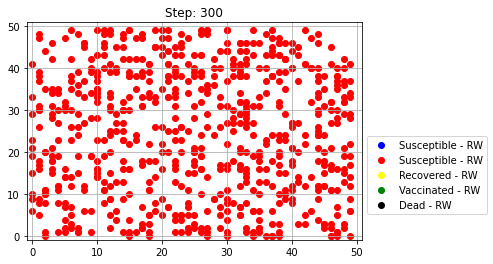

Healthy people= 0
Sick people= 683
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0

 Iteration 23


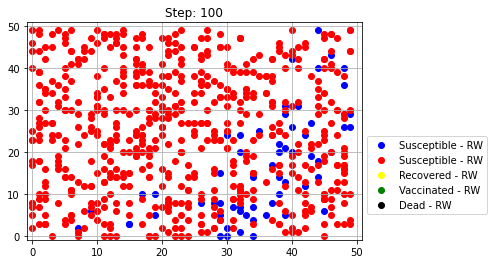

Healthy people= 59
Sick people= 624
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0


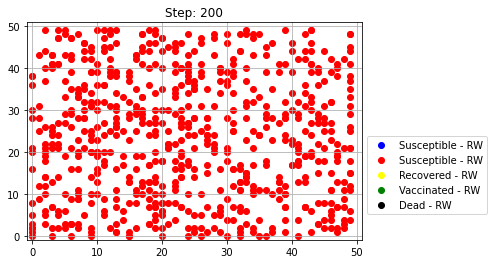

Healthy people= 0
Sick people= 683
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0


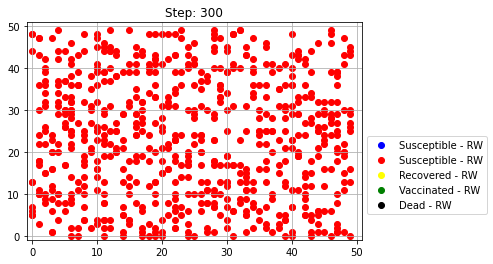

Healthy people= 0
Sick people= 683
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0

 Iteration 24


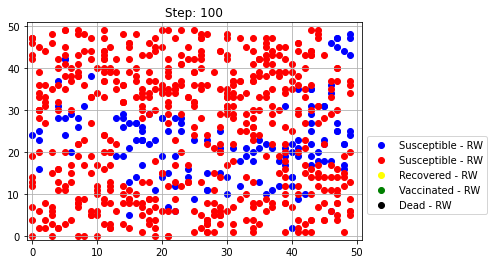

Healthy people= 133
Sick people= 550
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0


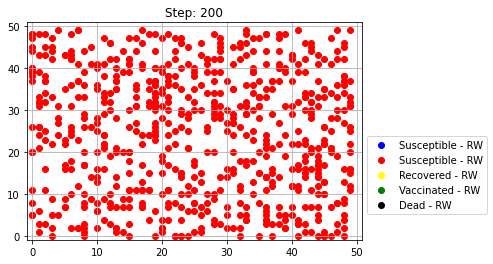

Healthy people= 0
Sick people= 683
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0


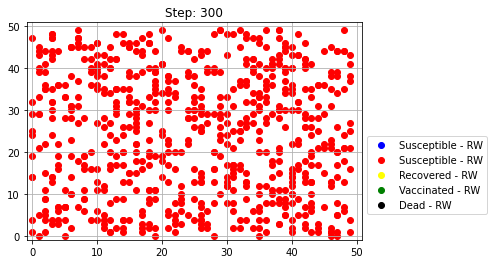

Healthy people= 0
Sick people= 683
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0

 Iteration 25


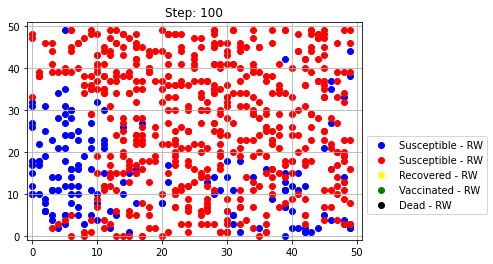

Healthy people= 148
Sick people= 535
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0


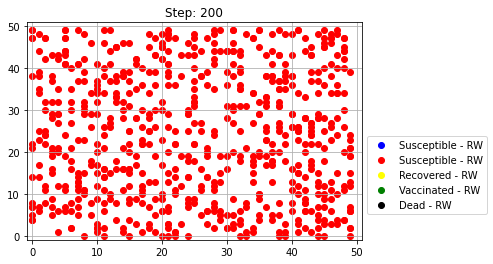

Healthy people= 0
Sick people= 683
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0


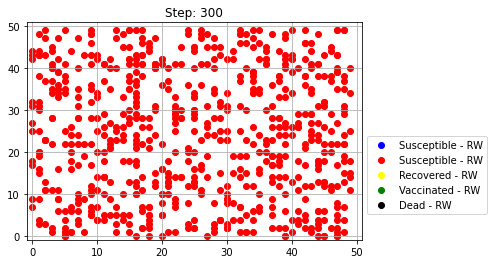

Healthy people= 0
Sick people= 683
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0

 Iteration 26


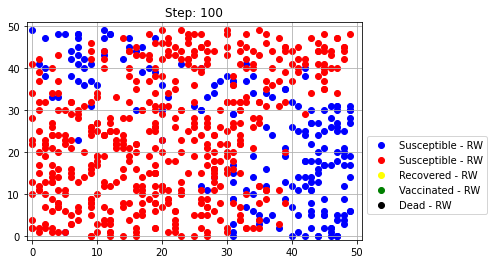

Healthy people= 188
Sick people= 495
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0


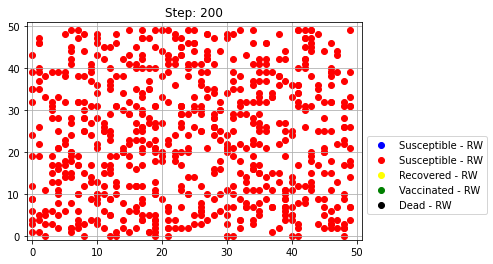

Healthy people= 0
Sick people= 683
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0


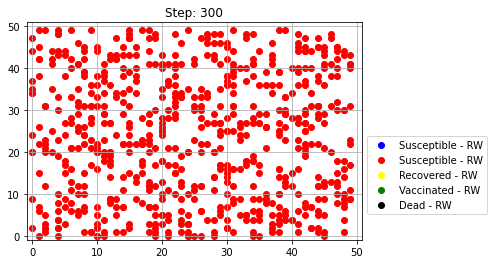

Healthy people= 0
Sick people= 683
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0

 Iteration 27


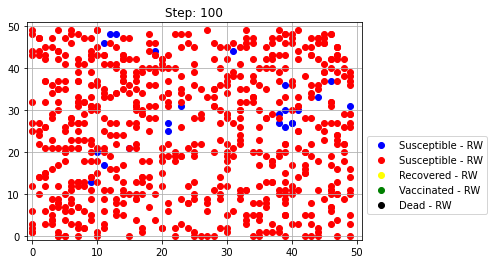

Healthy people= 22
Sick people= 661
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0


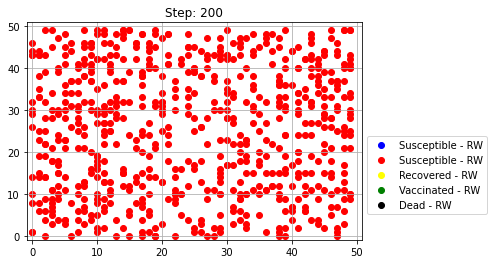

Healthy people= 0
Sick people= 683
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0


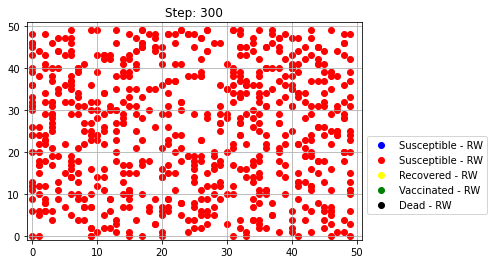

Healthy people= 0
Sick people= 683
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0

 Iteration 28


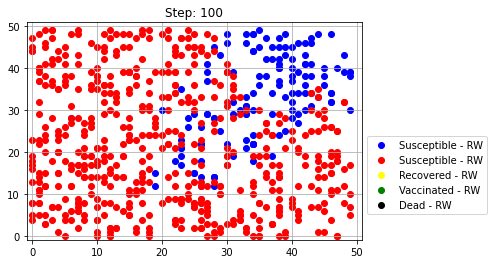

Healthy people= 132
Sick people= 551
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0


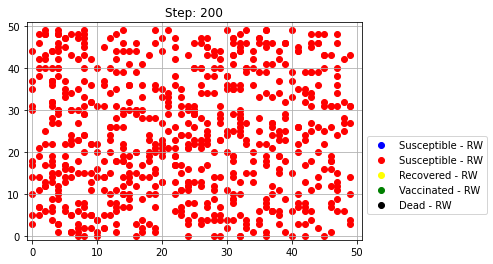

Healthy people= 0
Sick people= 683
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0


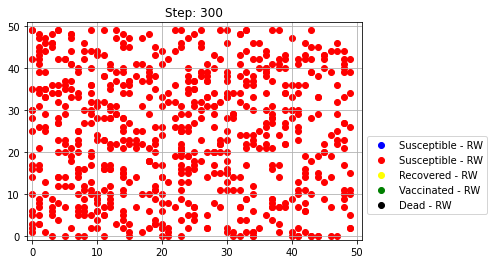

Healthy people= 0
Sick people= 683
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0

 Iteration 29


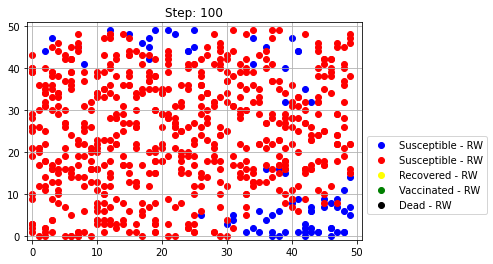

Healthy people= 74
Sick people= 609
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0


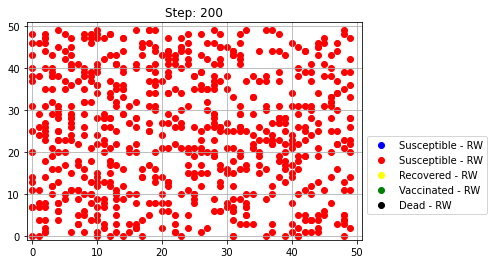

Healthy people= 0
Sick people= 683
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0


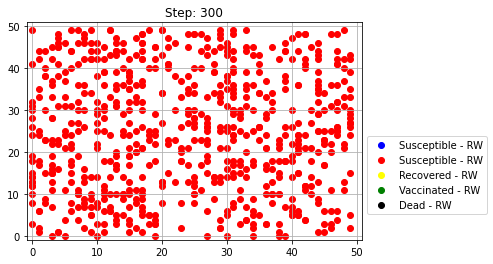

Healthy people= 0
Sick people= 683
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0

 Iteration 30


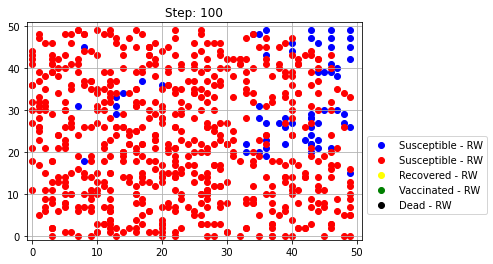

Healthy people= 63
Sick people= 620
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0


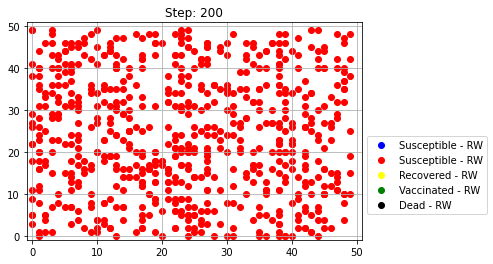

Healthy people= 0
Sick people= 683
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0


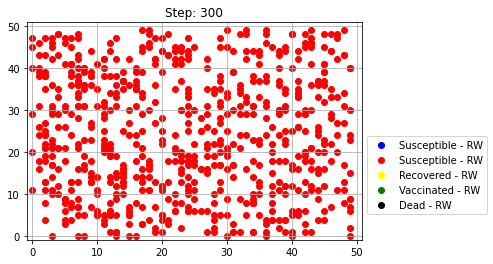

Healthy people= 0
Sick people= 683
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0

 Iteration 31


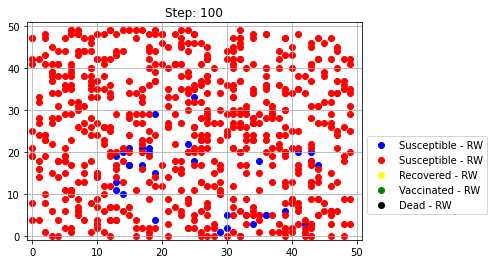

Healthy people= 30
Sick people= 653
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0


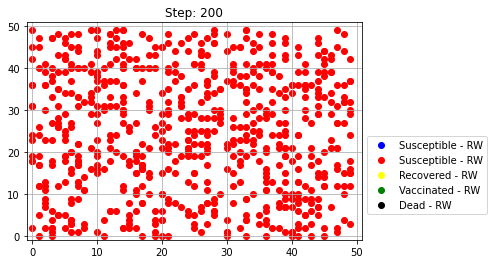

Healthy people= 0
Sick people= 683
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0


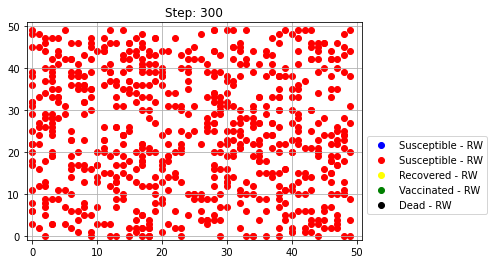

Healthy people= 0
Sick people= 683
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0

 Iteration 32


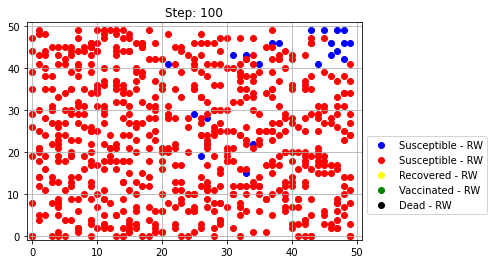

Healthy people= 22
Sick people= 661
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0


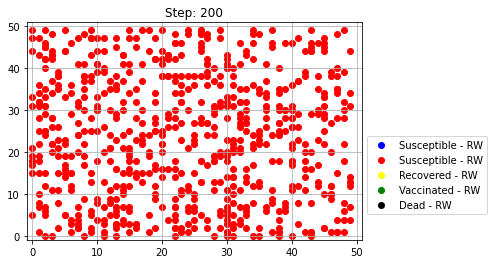

Healthy people= 0
Sick people= 683
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0


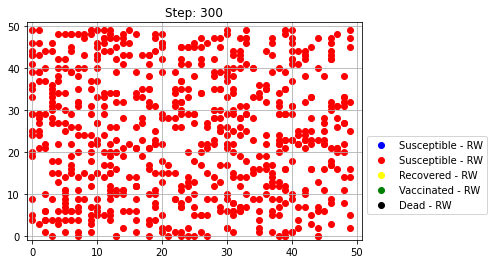

Healthy people= 0
Sick people= 683
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0

 Iteration 33


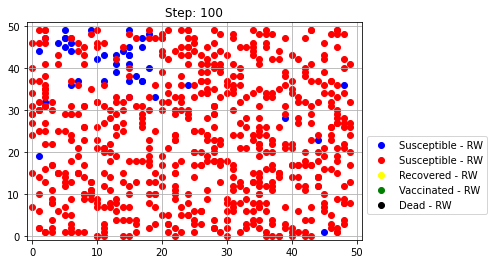

Healthy people= 39
Sick people= 644
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0


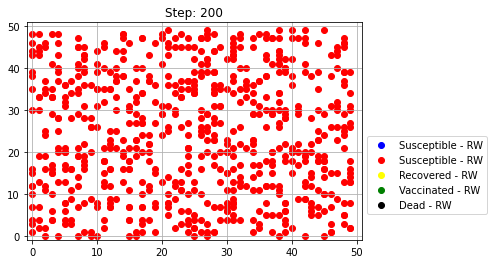

Healthy people= 0
Sick people= 683
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0


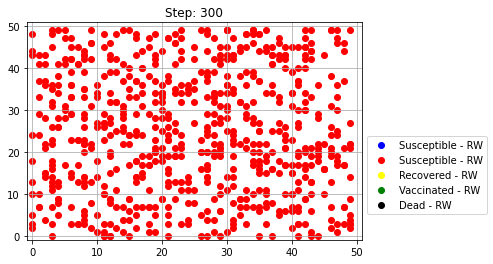

Healthy people= 0
Sick people= 683
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0

 Iteration 34


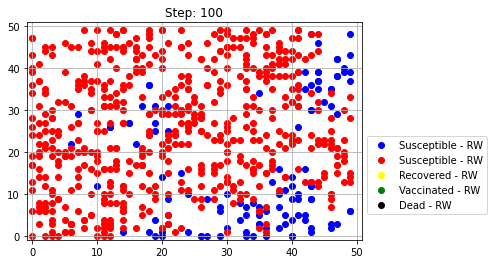

Healthy people= 110
Sick people= 573
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0


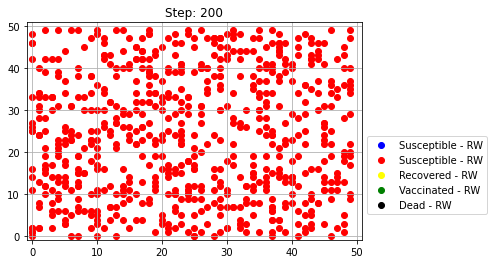

Healthy people= 0
Sick people= 683
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0


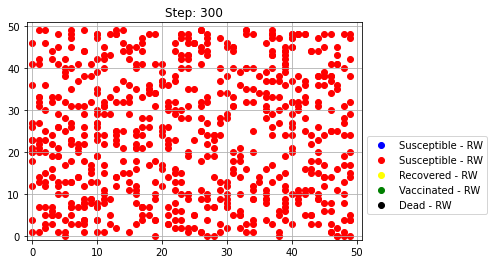

Healthy people= 0
Sick people= 683
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0

 Iteration 35


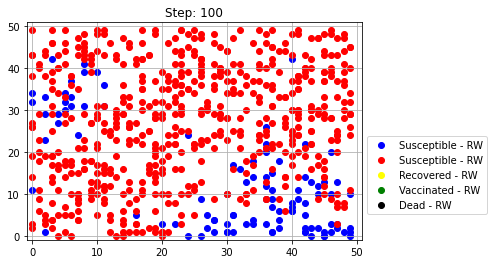

Healthy people= 99
Sick people= 584
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0


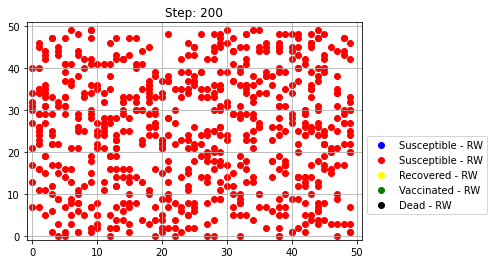

Healthy people= 0
Sick people= 683
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0


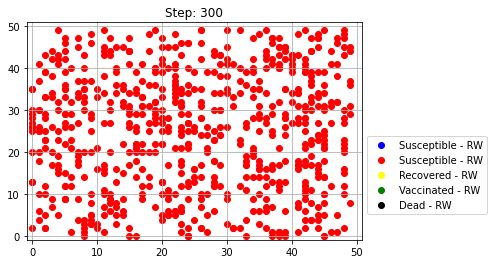

Healthy people= 0
Sick people= 683
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0

 Iteration 36


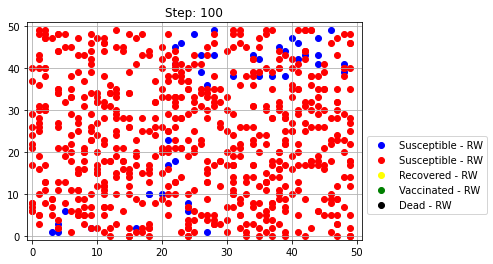

Healthy people= 41
Sick people= 642
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0


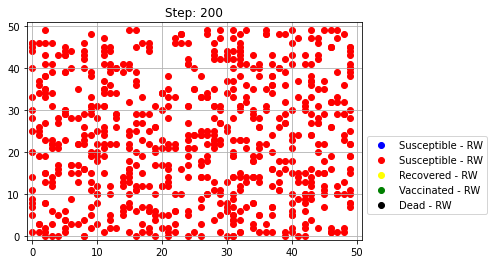

Healthy people= 0
Sick people= 683
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0


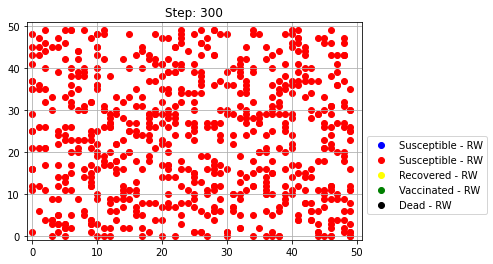

Healthy people= 0
Sick people= 683
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0

 Iteration 37


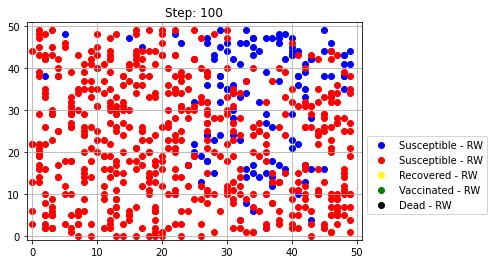

Healthy people= 115
Sick people= 568
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0


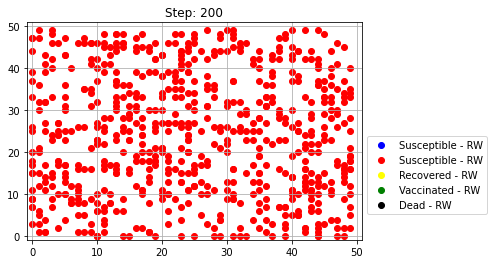

Healthy people= 0
Sick people= 683
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0


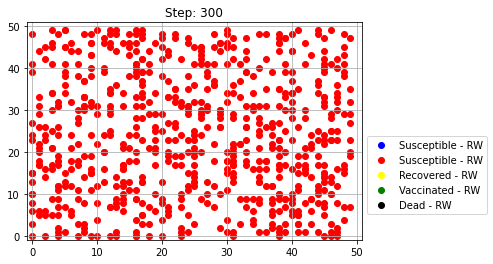

Healthy people= 0
Sick people= 683
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0

 Iteration 38


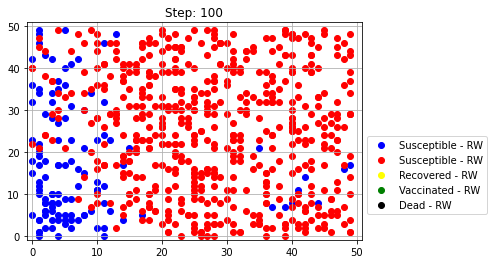

Healthy people= 115
Sick people= 568
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0


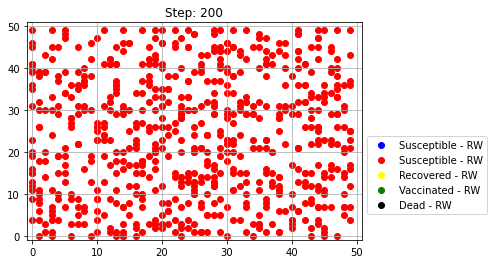

Healthy people= 0
Sick people= 683
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0


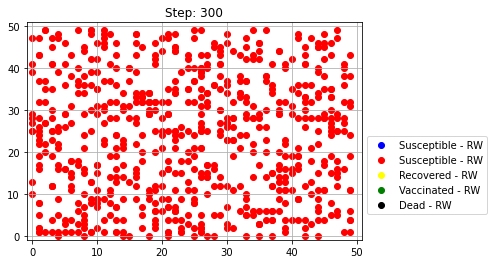

Healthy people= 0
Sick people= 683
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0

 Iteration 39


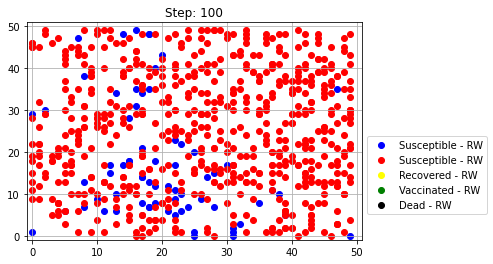

Healthy people= 65
Sick people= 618
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0


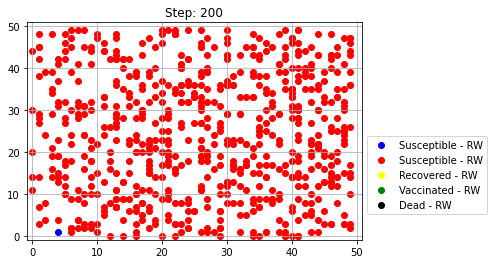

Healthy people= 1
Sick people= 682
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0


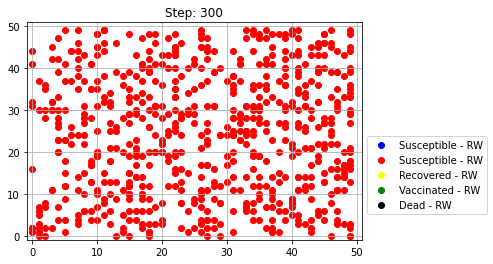

Healthy people= 0
Sick people= 683
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0

 Iteration 40


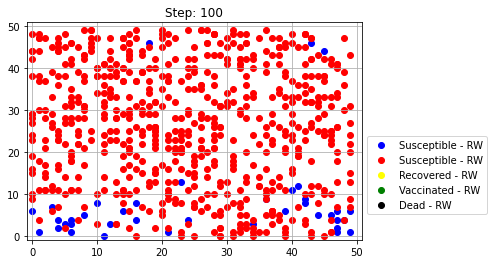

Healthy people= 36
Sick people= 647
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0


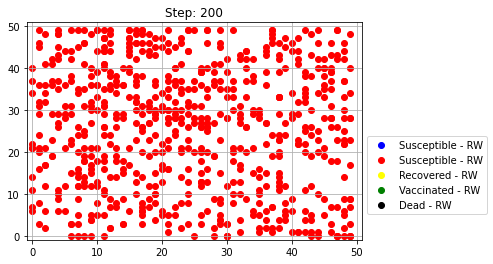

Healthy people= 0
Sick people= 683
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0


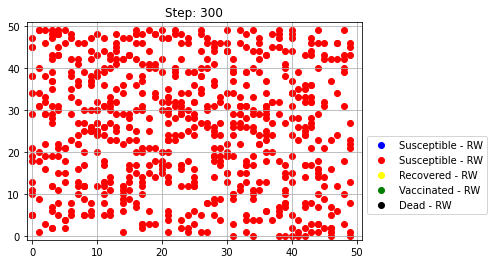

Healthy people= 0
Sick people= 683
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0

 Iteration 41


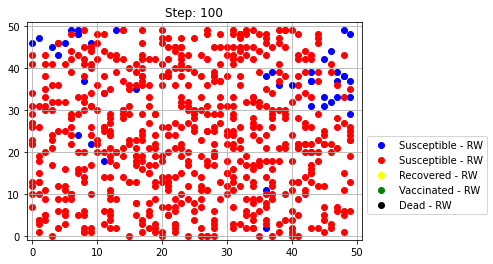

Healthy people= 41
Sick people= 642
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0


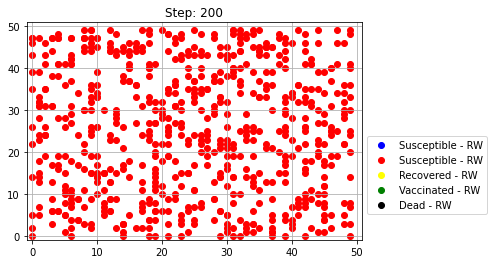

Healthy people= 0
Sick people= 683
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0


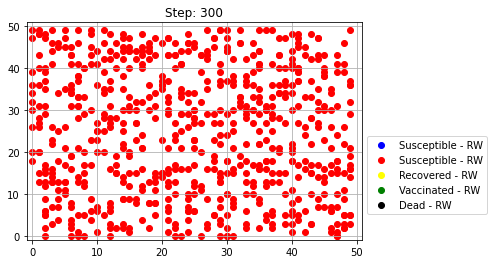

Healthy people= 0
Sick people= 683
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0

 Iteration 42


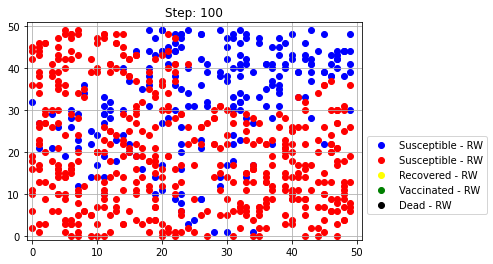

Healthy people= 208
Sick people= 475
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0


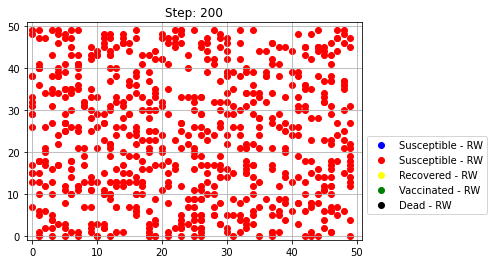

Healthy people= 0
Sick people= 683
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0


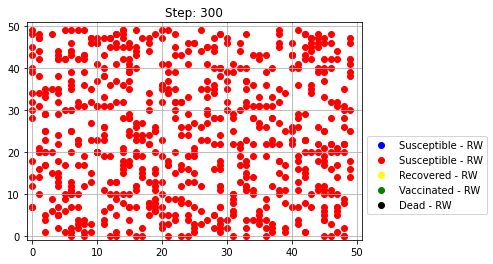

Healthy people= 0
Sick people= 683
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0

 Iteration 43


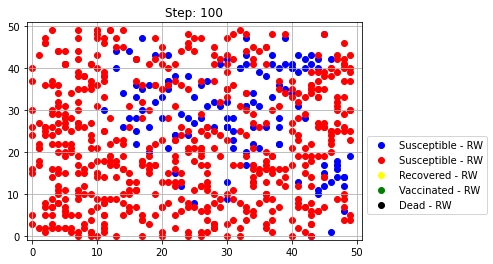

Healthy people= 123
Sick people= 560
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0


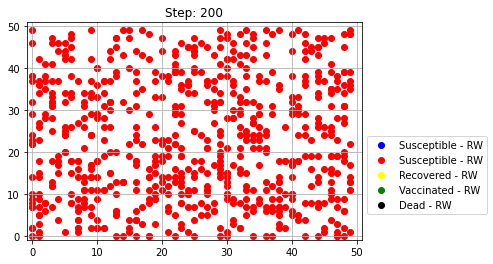

Healthy people= 0
Sick people= 683
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0


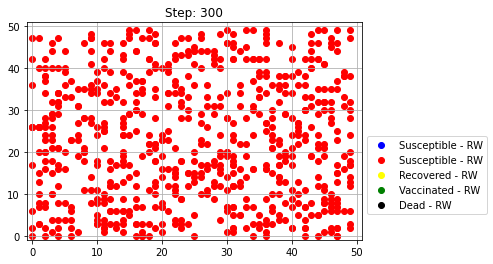

Healthy people= 0
Sick people= 683
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0

 Iteration 44


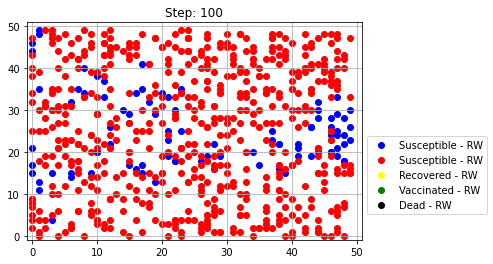

Healthy people= 89
Sick people= 594
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0


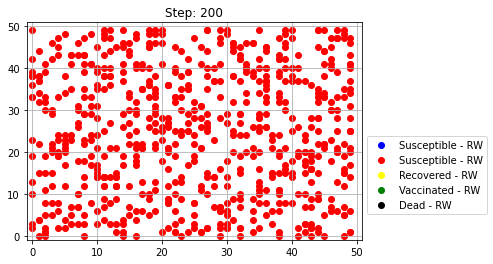

Healthy people= 0
Sick people= 683
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0


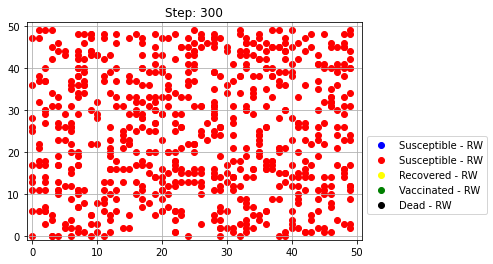

Healthy people= 0
Sick people= 683
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0

 Iteration 45


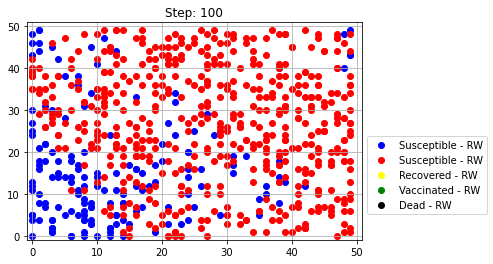

Healthy people= 163
Sick people= 520
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0


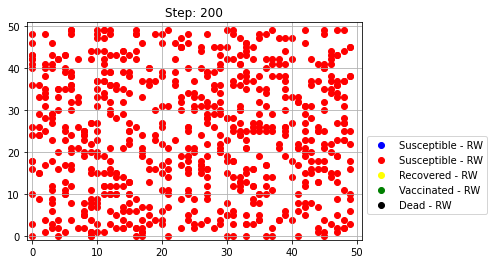

Healthy people= 0
Sick people= 683
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0


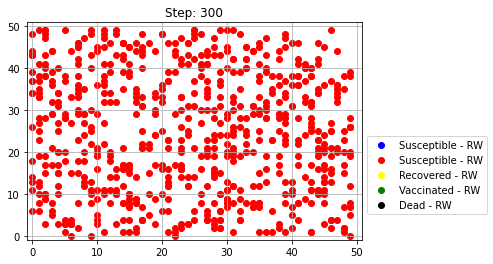

Healthy people= 0
Sick people= 683
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0

 Iteration 46


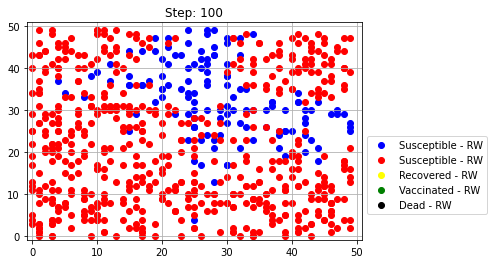

Healthy people= 128
Sick people= 555
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0


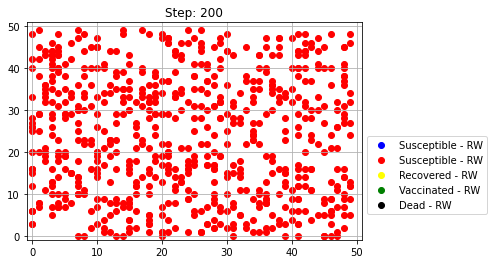

Healthy people= 0
Sick people= 683
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0


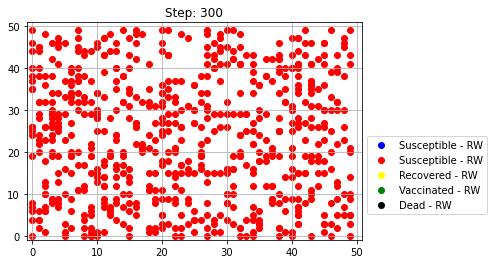

Healthy people= 0
Sick people= 683
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0

 Iteration 47


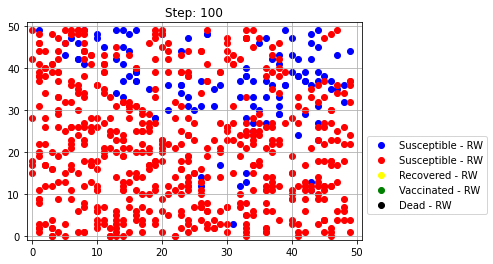

Healthy people= 112
Sick people= 571
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0


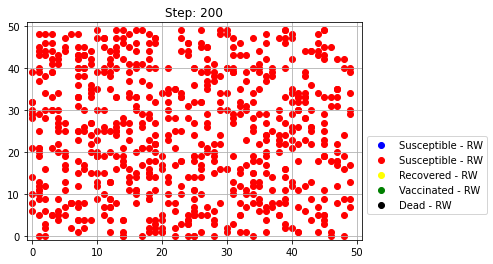

Healthy people= 0
Sick people= 683
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0


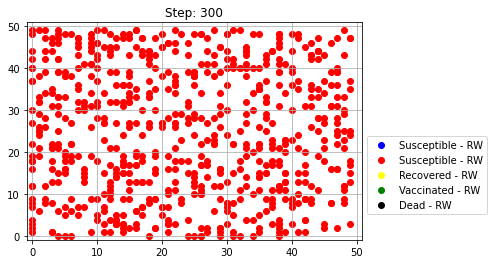

Healthy people= 0
Sick people= 683
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0

 Iteration 48


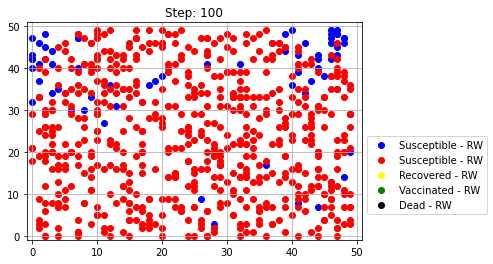

Healthy people= 63
Sick people= 620
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0


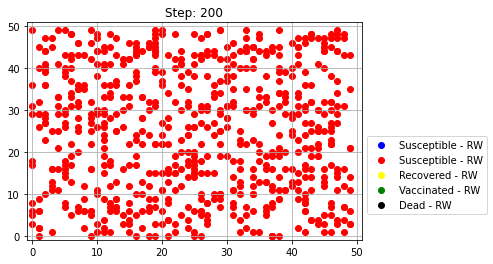

Healthy people= 0
Sick people= 683
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0


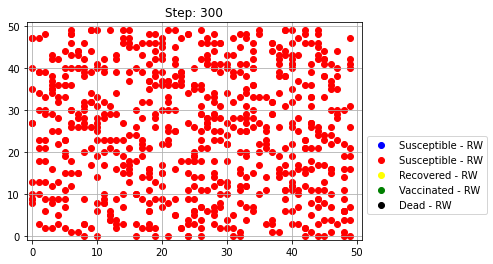

Healthy people= 0
Sick people= 683
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0

 Iteration 49


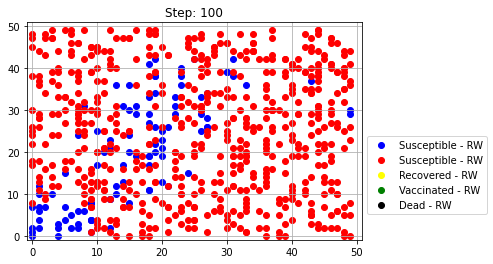

Healthy people= 94
Sick people= 589
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0


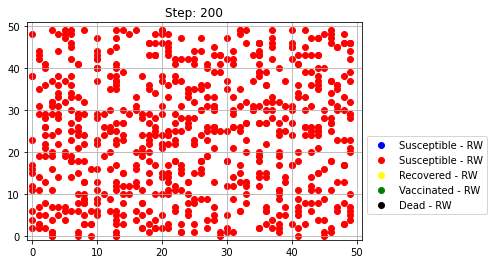

Healthy people= 0
Sick people= 683
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0


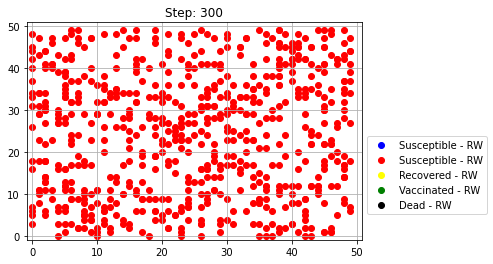

Healthy people= 0
Sick people= 683
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0

 Iteration 50


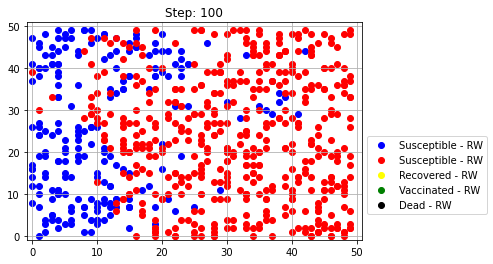

Healthy people= 210
Sick people= 473
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0


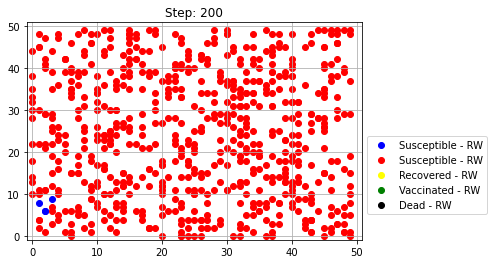

Healthy people= 4
Sick people= 679
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0


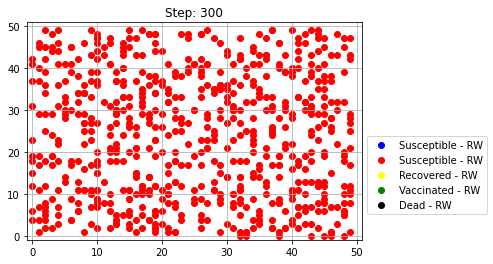

Healthy people= 0
Sick people= 683
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0


In [6]:
inf, sus,rec,vac,dea=np.array([]),np.array([]), np.array([]), np.array([]), np.array([])
n,m=50,300 # n is number of iterations and m is time step
for i in range(n):
    
    print('\n Iteration {}'.format(i+1))
   
    ex2p2 = RandomWalkEpidemicSimulator(population_size=683,no_init_infected=10,nx=50, ny=50,  
                                        p_infected=0.9,plot_radomwalk=True,plot_mean=True,plot_mean10=True,plot_beta=True) 
    inf_temp, sus_temp,rec_temp,vac_temp,dea_temp=ex2p2.simulatior_every_step(m)
    inf=np.append(inf,inf_temp)
    sus=np.append(sus,sus_temp)
    rec=np.append(rec,rec_temp)
    vac=np.append(vac,vac_temp)
    dea=np.append(dea,dea_temp)

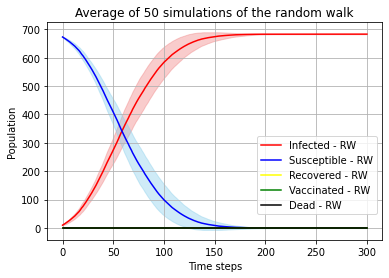

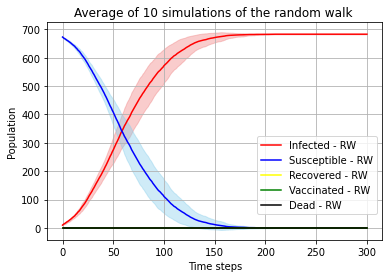

In [7]:
# Mean and sd plot of susseptible and infected people when initial infected = 10
ex2p2.SI_mean_sd_plot(inf,sus,rec,vac,dea,m+1)

- What is different now?  
  **Answer:**  
  From the graphs above, if the initial infected are 1 it takes more than 300 time steps to get the all people infected. While the initial infected comes to 10, it takes just almost 150 time steps to infect all the people. So he more people get infected the faster the disease spreads. It means that it can be much easier to take action against the spreding of the disease as early as possible. 

## Part 3:
Recall the ODE-based, deterministic SI-model:
\begin{align}
\tag{1}
\frac{\mathrm{d}S(t)}{\mathrm{d}t} &= -\beta(t)\cdot\frac{S(t)I(t)}{N}\\ 
\tag{2}
\frac{\mathrm{d}I(t)}{\mathrm{d}t}&=\beta(t)\cdot\frac{S(t)I(t)}{N}\,.
\end{align}



In the case of a constant β the analytical solution is
\begin{align}
\tag{3}
I(t)&=\frac{N}{1+\frac{S_0}{I_0}\exp(-\beta{t})}\,,
\end{align}

where S0=S(0) is the number of healthy people at t=0 . We want to estimate a value for the (mean) effective contact rate, β, based on "observed" changes in the random walker populations. To this end, we combine equation (1) with a first order approximation of the derivative to yield:

\begin{equation}
\tag{4}
\beta\cdot\Delta t \approx -\frac{(S(t)-S(t-\Delta t))N}{S(t)I(t)}
=-\frac{(S_n-S_{n-1})N}{S_n I_n}\,.
\end{equation}

- Consider again the results from Part 1. For each run of the random walk SI-model, calculate βΔt using equation (4).


**Solution:**

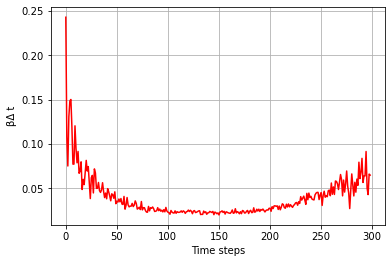


The βΔ t  [0.24289367 0.10834288 0.07517611 0.13078712 0.14861816 0.15016474
 0.11855547 0.07727608 0.07730564 0.12046897 0.09492893 0.07879153
 0.09158762 0.06695197 0.06931921 0.07985283 0.04866589 0.06011144
 0.05421142 0.0683     0.08149788 0.06947252 0.07451238 0.05707221
 0.03846293 0.06198644 0.0645848  0.04480532 0.07191775 0.06728693
 0.04998039 0.05004039 0.05659131 0.04743182 0.04539872 0.04836979
 0.05631285 0.0465579  0.03956513 0.04466444 0.038206   0.04964076
 0.04605291 0.04144603 0.03593944 0.04379856 0.04274137 0.03878415
 0.0460344  0.03265874 0.03551046 0.03442691 0.03795323 0.03477801
 0.03847944 0.03219436 0.03176955 0.0408692  0.02648352 0.03085972
 0.03962836 0.03142053 0.02910236 0.02989099 0.02988876 0.03302451
 0.02942671 0.03107338 0.03581201 0.03293006 0.02654599 0.0275142
 0.02870698 0.0260514  0.03513478 0.0256903  0.02817749 0.02811932
 0.02494008 0.02320539 0.02306586 0.0295857  0.02462377 0.02822382
 0.02743457 0.02895804 0.02704638 0.02391594 0.02417

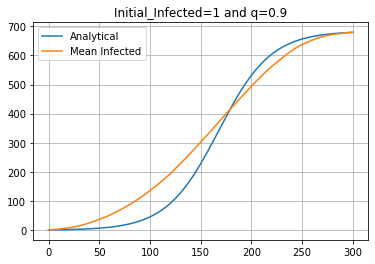

In [8]:
ex2p3=ex2p1  
ex2p3.beta_deltat_plot() 
ex2p3.analytical_I()

- Use the output to estimate a representative β-function. The simplest approach is to choose a constant value, otherwise you can try to find a sensible curve, β=β(t).  
 **Answer:**  
Since β$\Delta t$ it isn't constant value, we calculate the β by taking the mean of β$\Delta t$ while $\Delta t=1$

- Compare the mean number of infected individuals from the random walk simulation with the analytical solution to the SI-model  
 **Answer:**  
The mean of infected increases quickly in the beggining of the epidemic according to the analytical, and after 200 time steps these two become gratually similar.

## Part 4

- Make some test runs where you change the number of initially infected people to be larger, e.g., $I_0$=10, and/or lower the infection probability by fifty per cent (i.e., use q=0.45). 

**Solution:**


 Iteration 1


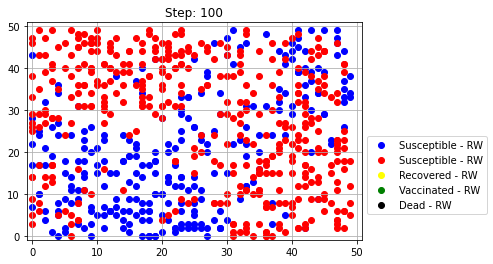

Healthy people= 265
Sick people= 418
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0


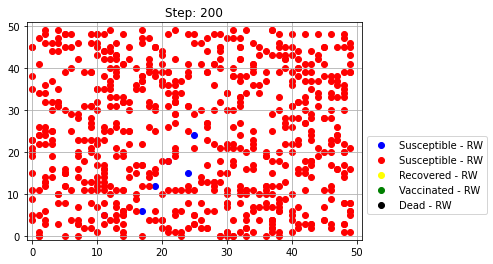

Healthy people= 5
Sick people= 678
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0


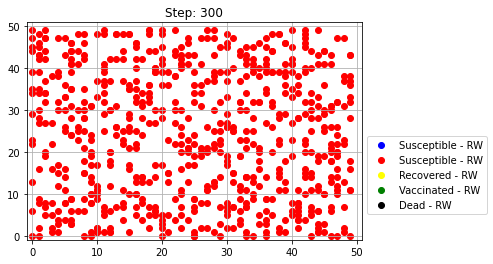

Healthy people= 0
Sick people= 683
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0

 Iteration 2


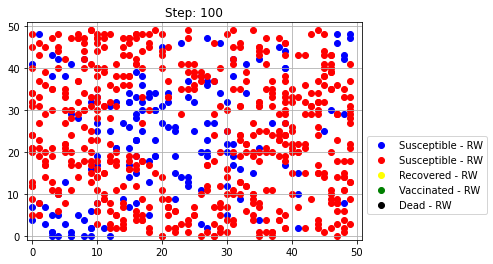

Healthy people= 155
Sick people= 528
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0


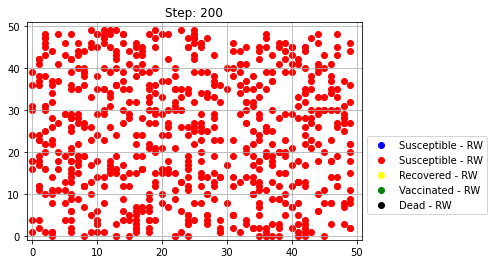

Healthy people= 1
Sick people= 682
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0


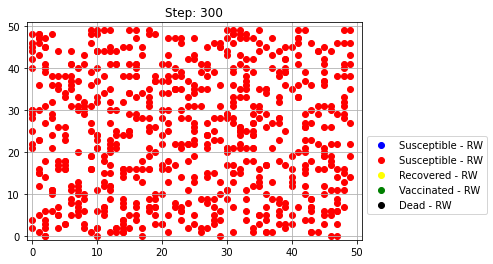

Healthy people= 0
Sick people= 683
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0

 Iteration 3


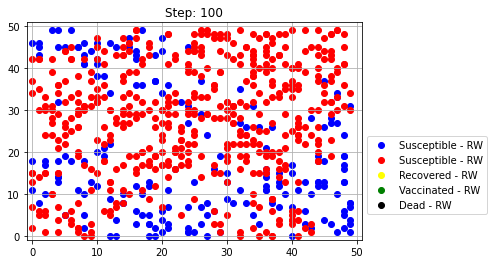

Healthy people= 184
Sick people= 499
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0


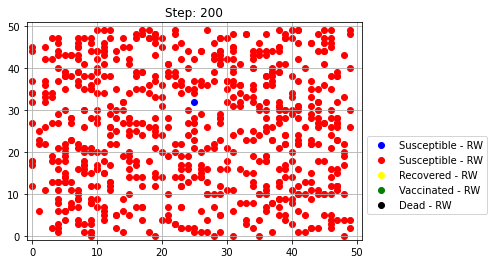

Healthy people= 1
Sick people= 682
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0


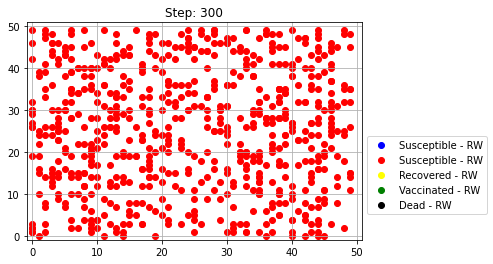

Healthy people= 0
Sick people= 683
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0

 Iteration 4


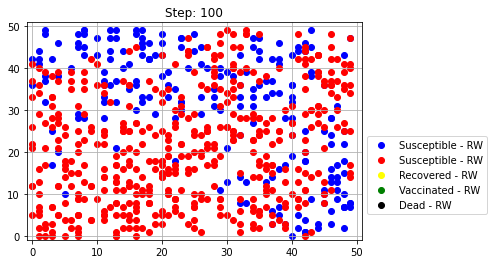

Healthy people= 202
Sick people= 481
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0


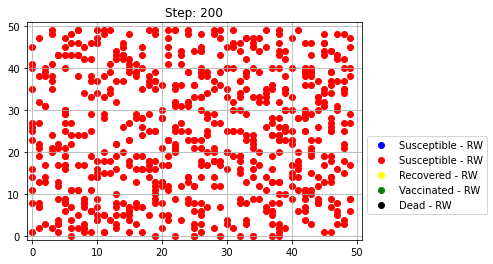

Healthy people= 0
Sick people= 683
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0


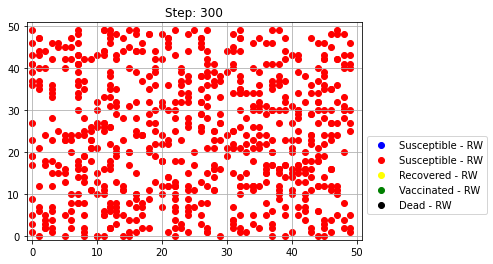

Healthy people= 0
Sick people= 683
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0

 Iteration 5


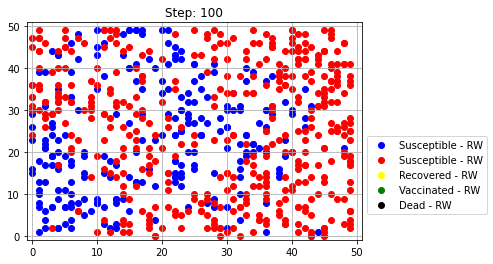

Healthy people= 246
Sick people= 437
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0


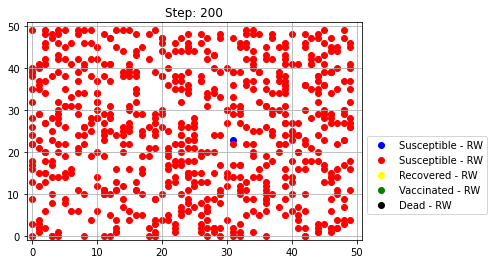

Healthy people= 1
Sick people= 682
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0


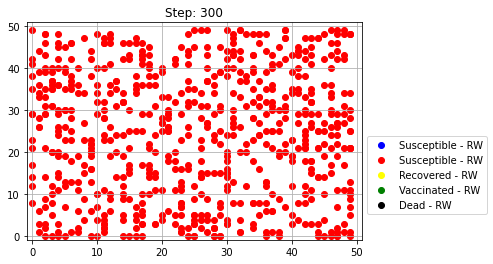

Healthy people= 0
Sick people= 683
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0

 Iteration 6


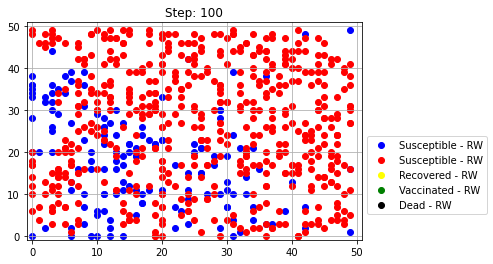

Healthy people= 147
Sick people= 536
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0


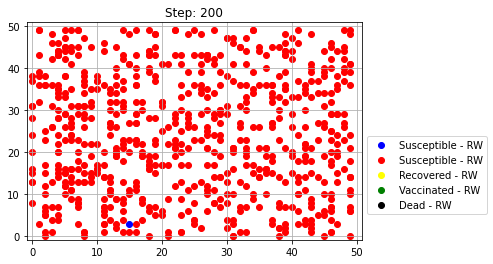

Healthy people= 1
Sick people= 682
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0


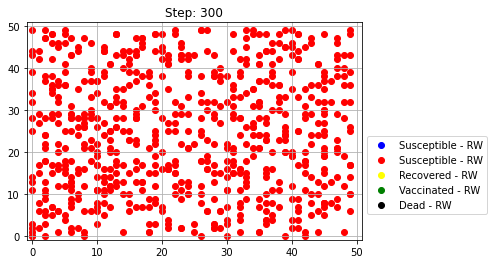

Healthy people= 0
Sick people= 683
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0

 Iteration 7


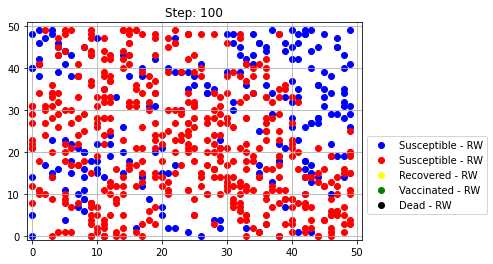

Healthy people= 211
Sick people= 472
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0


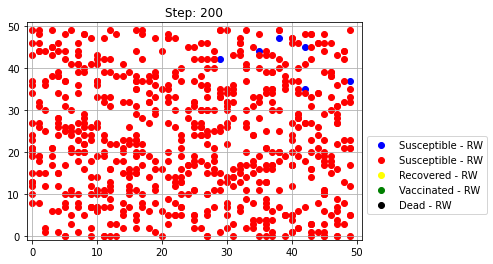

Healthy people= 6
Sick people= 677
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0


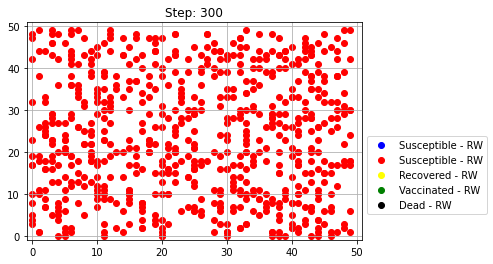

Healthy people= 0
Sick people= 683
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0

 Iteration 8


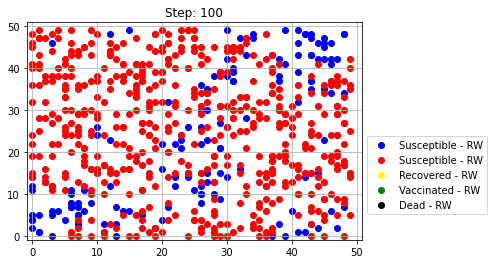

Healthy people= 145
Sick people= 538
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0


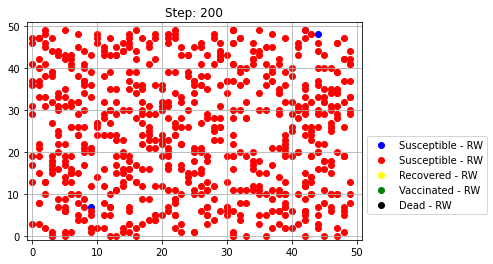

Healthy people= 3
Sick people= 680
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0


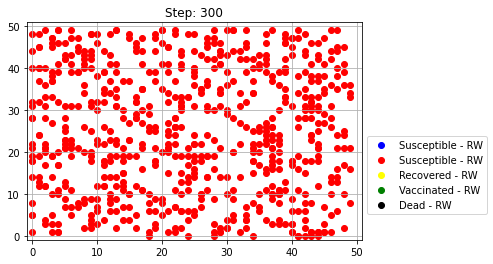

Healthy people= 0
Sick people= 683
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0

 Iteration 9


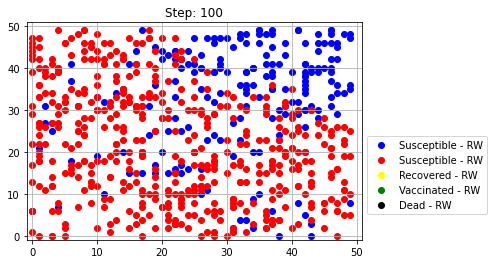

Healthy people= 193
Sick people= 490
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0


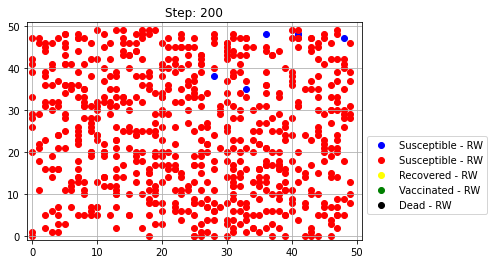

Healthy people= 6
Sick people= 677
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0


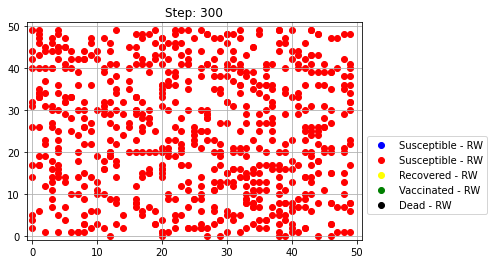

Healthy people= 0
Sick people= 683
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0

 Iteration 10


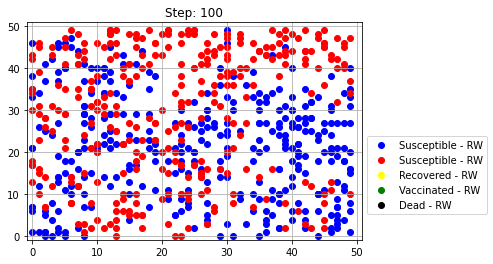

Healthy people= 352
Sick people= 331
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0


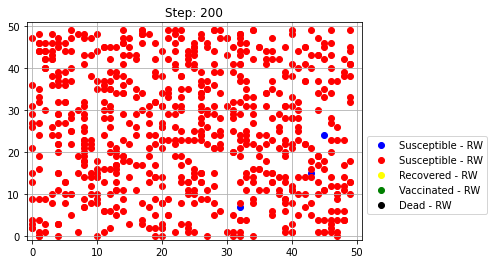

Healthy people= 3
Sick people= 680
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0


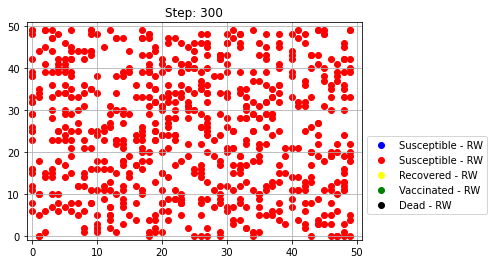

Healthy people= 0
Sick people= 683
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0

 Iteration 11


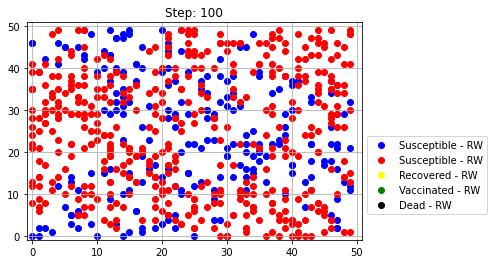

Healthy people= 215
Sick people= 468
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0


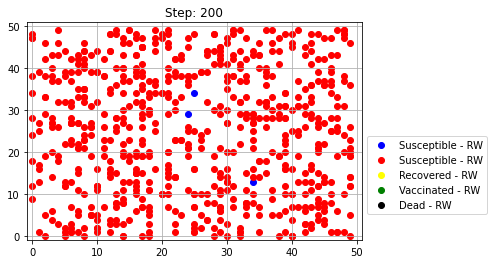

Healthy people= 3
Sick people= 680
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0


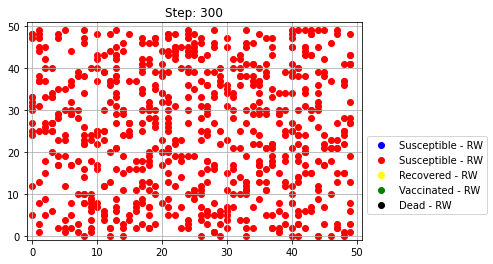

Healthy people= 0
Sick people= 683
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0

 Iteration 12


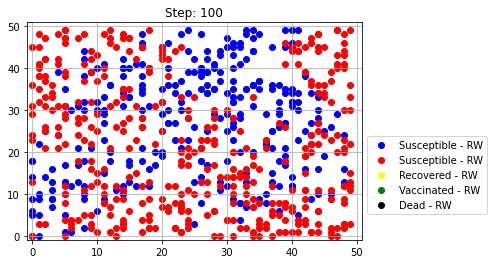

Healthy people= 279
Sick people= 404
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0


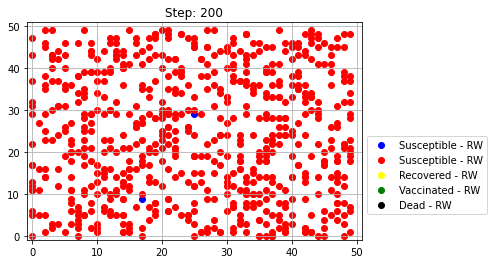

Healthy people= 2
Sick people= 681
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0


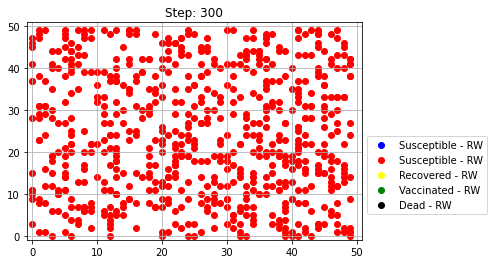

Healthy people= 0
Sick people= 683
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0

 Iteration 13


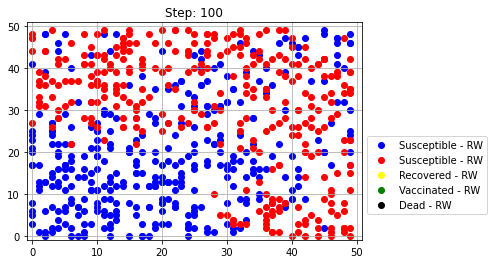

Healthy people= 356
Sick people= 327
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0


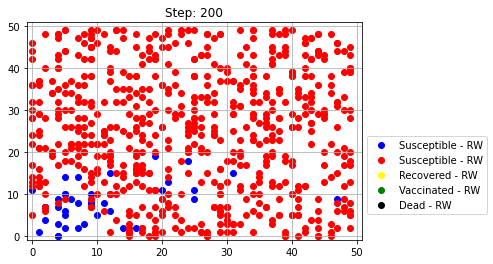

Healthy people= 36
Sick people= 647
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0


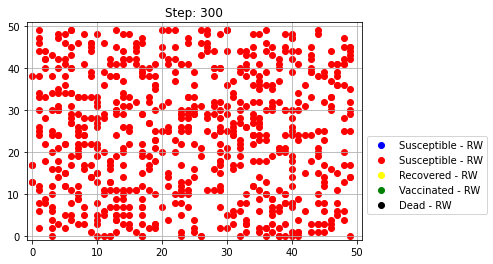

Healthy people= 0
Sick people= 683
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0

 Iteration 14


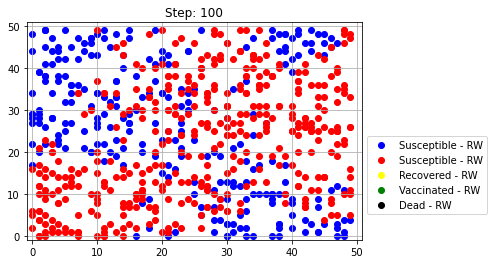

Healthy people= 261
Sick people= 422
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0


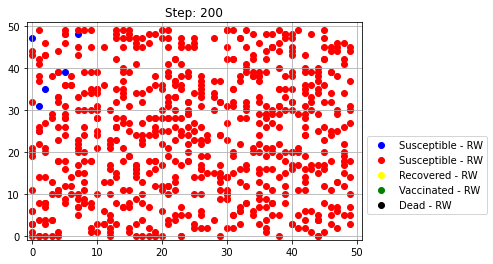

Healthy people= 5
Sick people= 678
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0


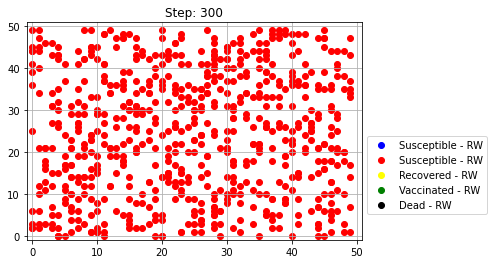

Healthy people= 0
Sick people= 683
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0

 Iteration 15


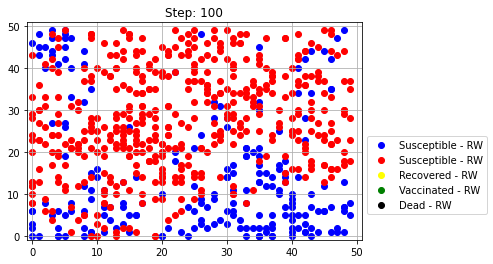

Healthy people= 210
Sick people= 473
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0


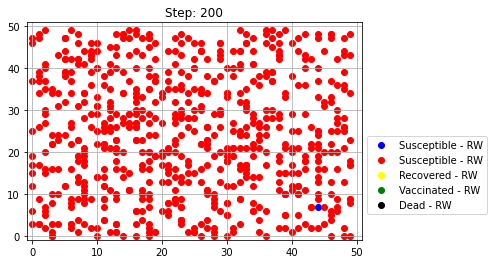

Healthy people= 1
Sick people= 682
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0


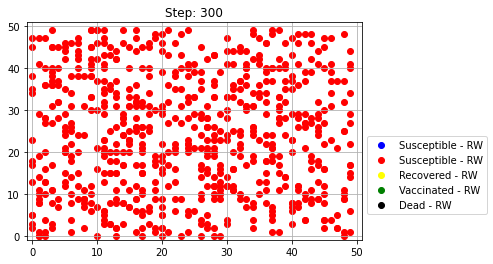

Healthy people= 0
Sick people= 683
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0

 Iteration 16


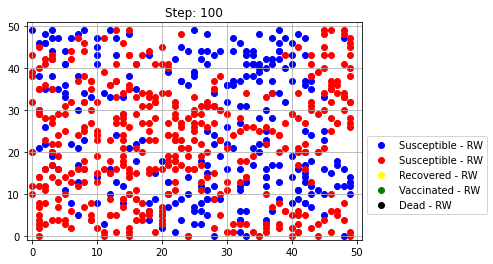

Healthy people= 255
Sick people= 428
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0


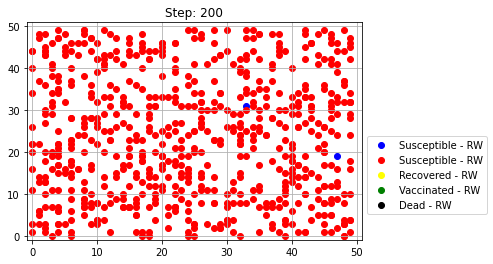

Healthy people= 2
Sick people= 681
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0


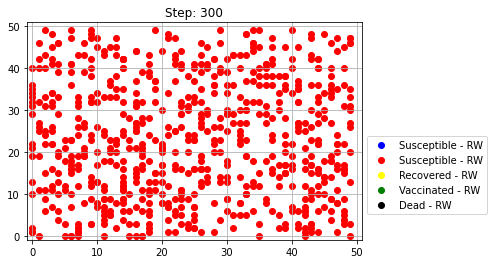

Healthy people= 0
Sick people= 683
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0

 Iteration 17


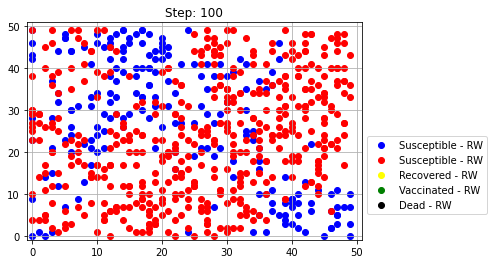

Healthy people= 196
Sick people= 487
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0


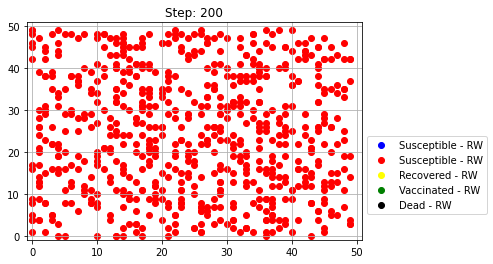

Healthy people= 0
Sick people= 683
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0


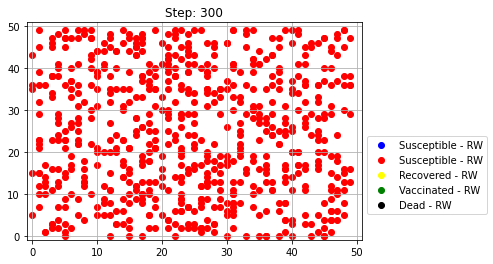

Healthy people= 0
Sick people= 683
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0

 Iteration 18


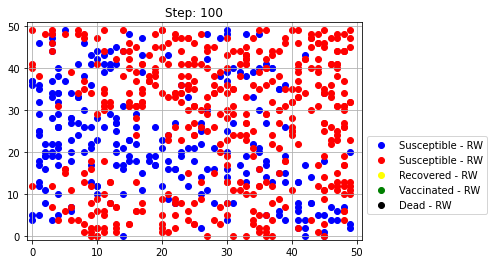

Healthy people= 241
Sick people= 442
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0


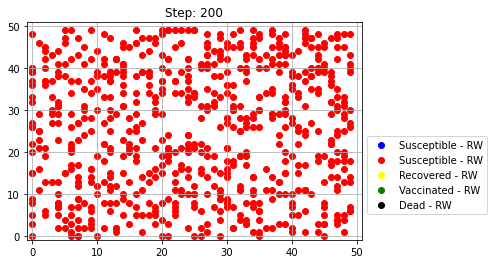

Healthy people= 0
Sick people= 683
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0


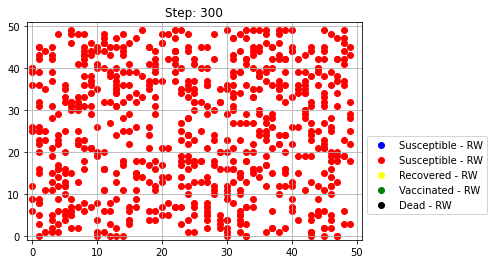

Healthy people= 0
Sick people= 683
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0

 Iteration 19


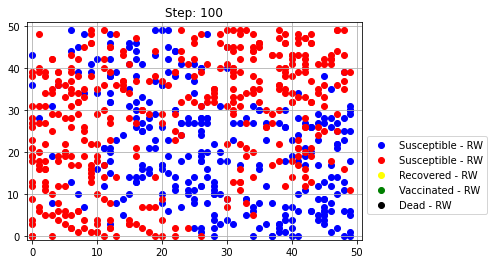

Healthy people= 292
Sick people= 391
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0


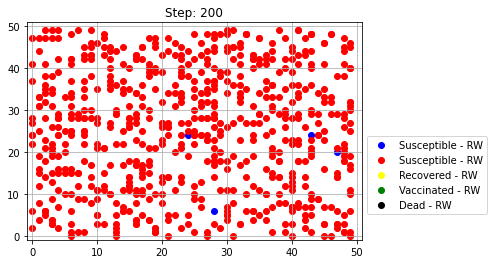

Healthy people= 4
Sick people= 679
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0


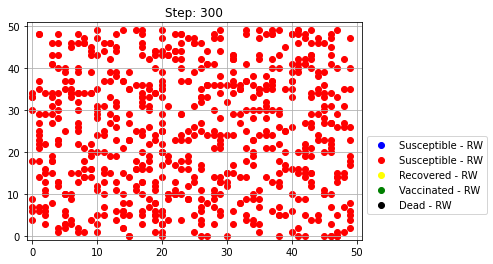

Healthy people= 0
Sick people= 683
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0

 Iteration 20


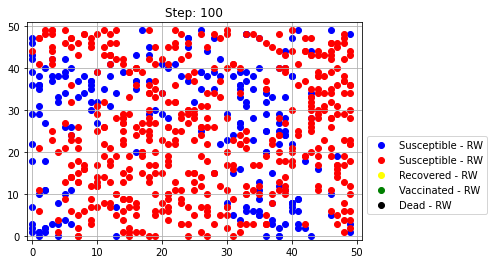

Healthy people= 203
Sick people= 480
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0


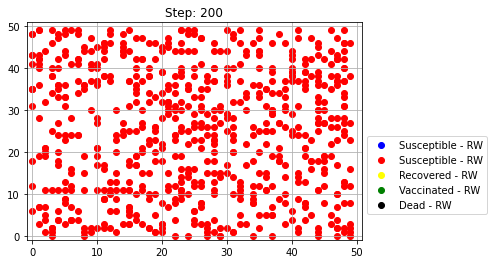

Healthy people= 0
Sick people= 683
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0


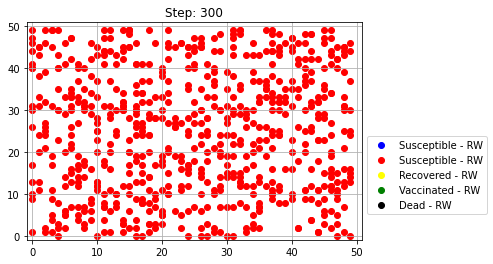

Healthy people= 0
Sick people= 683
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0

 Iteration 21


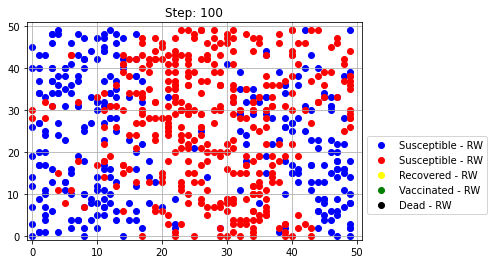

Healthy people= 299
Sick people= 384
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0


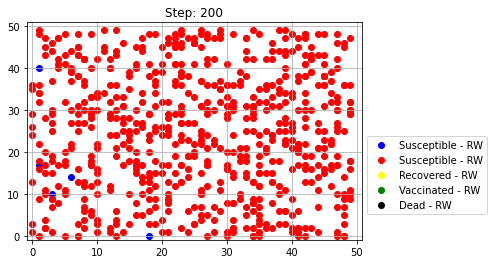

Healthy people= 5
Sick people= 678
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0


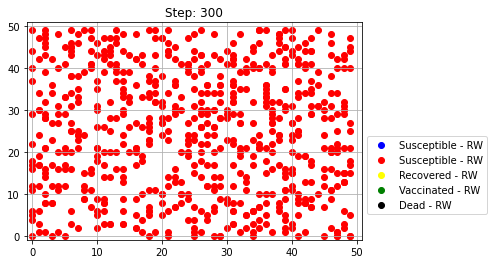

Healthy people= 0
Sick people= 683
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0

 Iteration 22


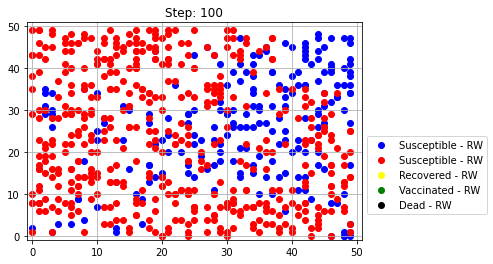

Healthy people= 200
Sick people= 483
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0


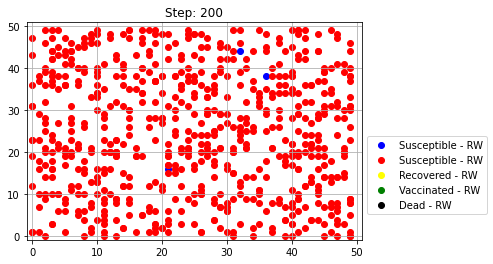

Healthy people= 3
Sick people= 680
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0


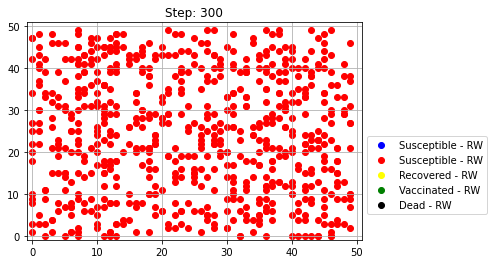

Healthy people= 0
Sick people= 683
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0

 Iteration 23


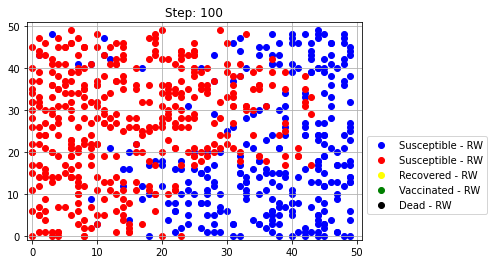

Healthy people= 283
Sick people= 400
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0


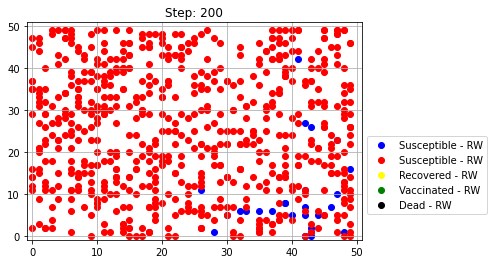

Healthy people= 23
Sick people= 660
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0


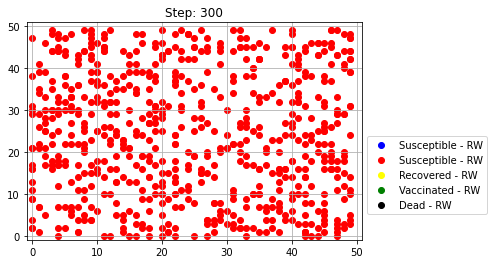

Healthy people= 0
Sick people= 683
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0

 Iteration 24


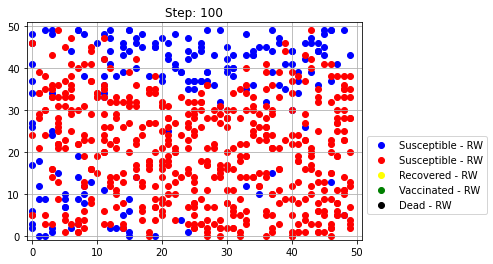

Healthy people= 176
Sick people= 507
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0


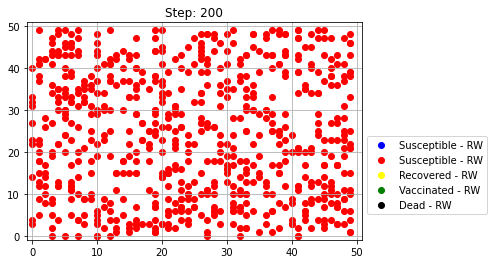

Healthy people= 0
Sick people= 683
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0


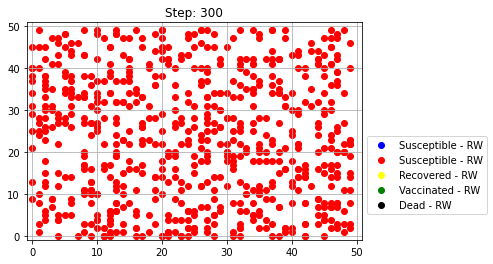

Healthy people= 0
Sick people= 683
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0

 Iteration 25


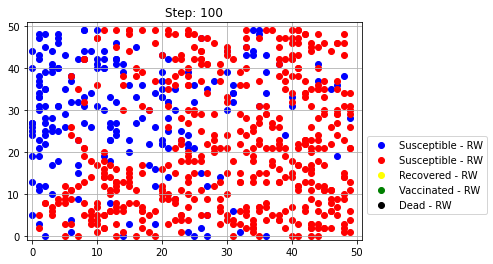

Healthy people= 200
Sick people= 483
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0


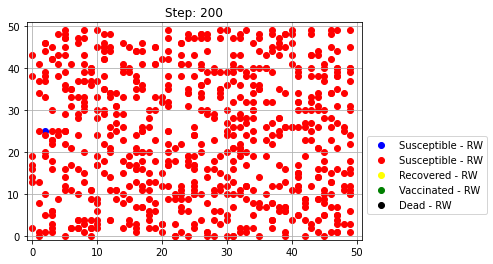

Healthy people= 1
Sick people= 682
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0


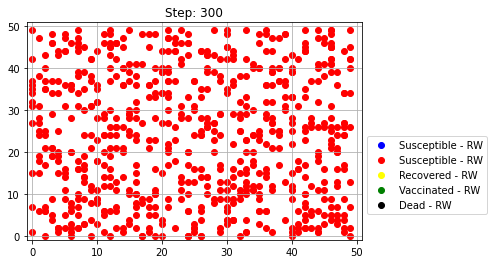

Healthy people= 0
Sick people= 683
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0

 Iteration 26


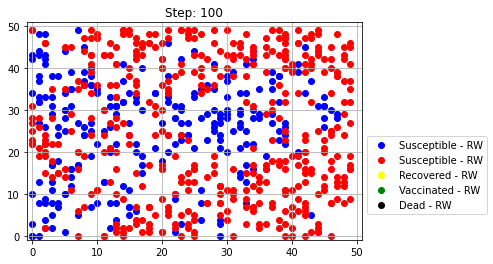

Healthy people= 240
Sick people= 443
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0


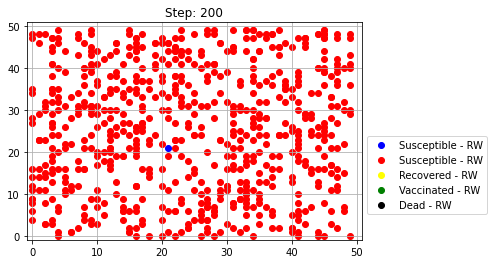

Healthy people= 1
Sick people= 682
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0


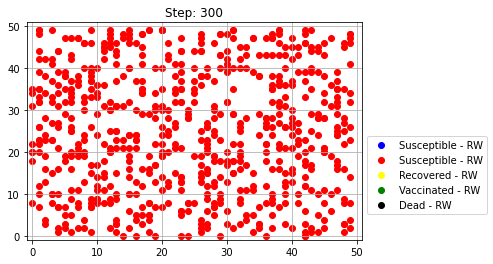

Healthy people= 0
Sick people= 683
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0

 Iteration 27


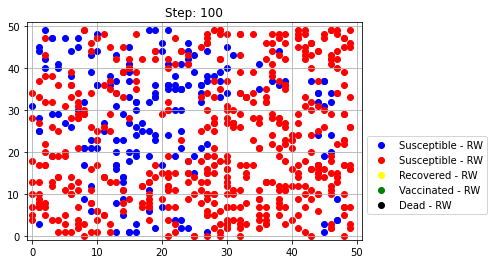

Healthy people= 176
Sick people= 507
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0


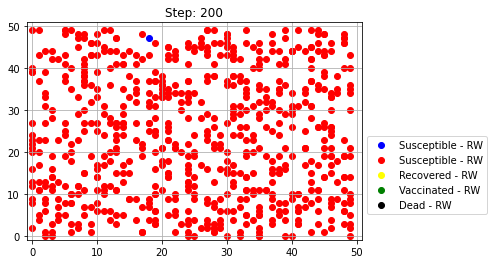

Healthy people= 1
Sick people= 682
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0


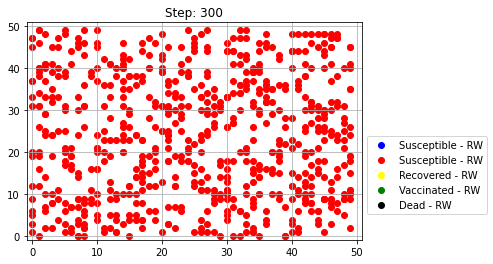

Healthy people= 0
Sick people= 683
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0

 Iteration 28


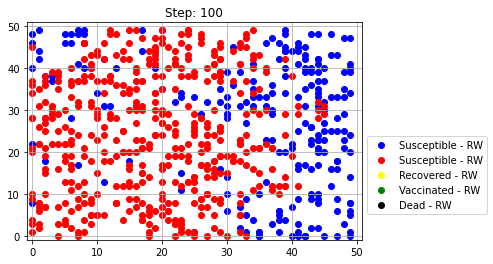

Healthy people= 219
Sick people= 464
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0


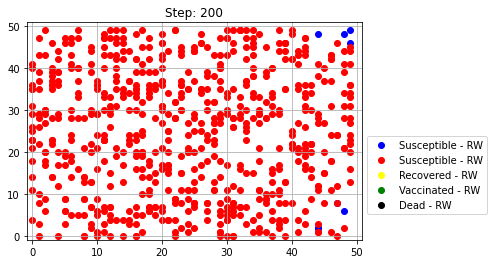

Healthy people= 7
Sick people= 676
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0


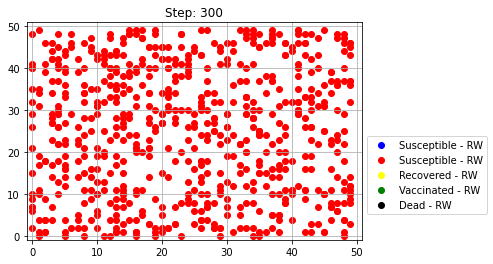

Healthy people= 0
Sick people= 683
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0

 Iteration 29


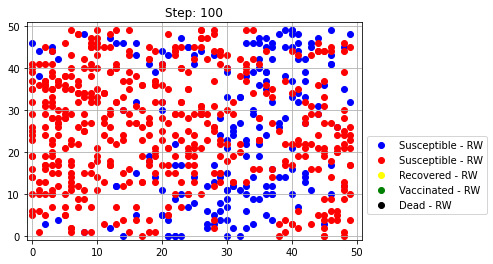

Healthy people= 187
Sick people= 496
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0


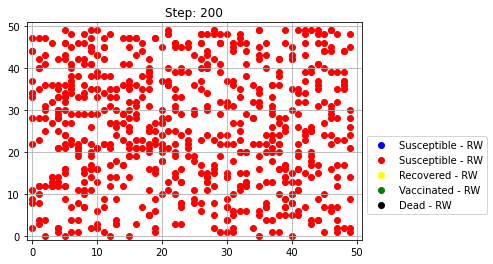

Healthy people= 0
Sick people= 683
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0


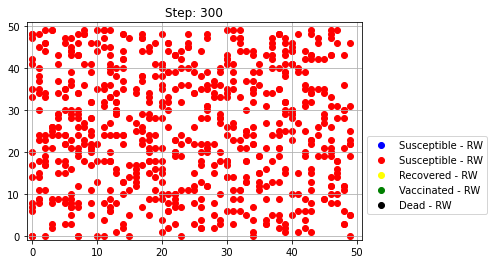

Healthy people= 0
Sick people= 683
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0

 Iteration 30


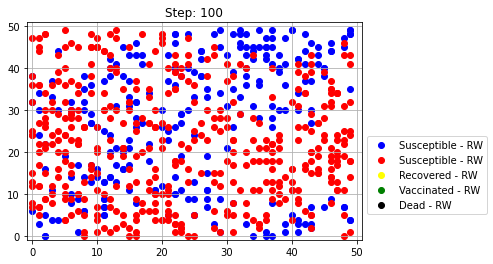

Healthy people= 242
Sick people= 441
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0


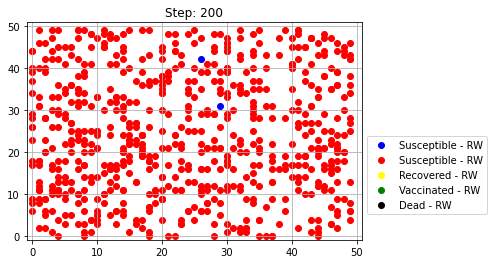

Healthy people= 2
Sick people= 681
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0


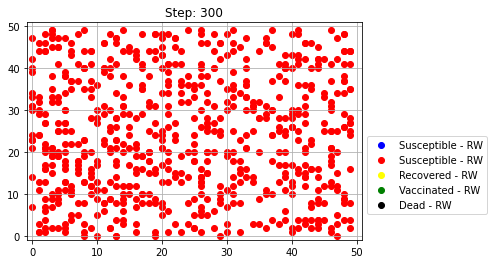

Healthy people= 0
Sick people= 683
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0

 Iteration 31


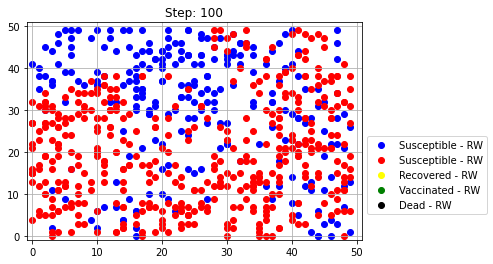

Healthy people= 241
Sick people= 442
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0


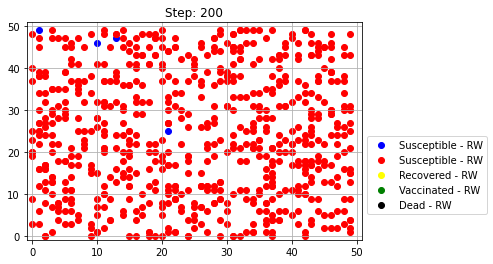

Healthy people= 4
Sick people= 679
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0


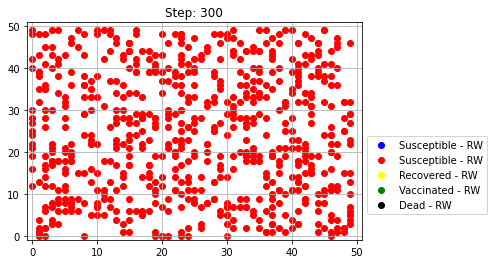

Healthy people= 0
Sick people= 683
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0

 Iteration 32


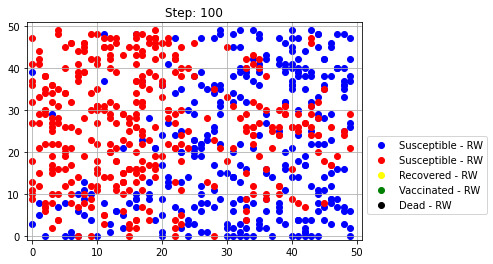

Healthy people= 310
Sick people= 373
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0


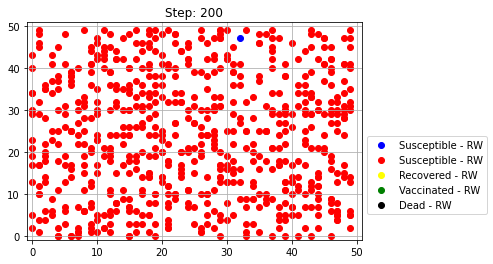

Healthy people= 1
Sick people= 682
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0


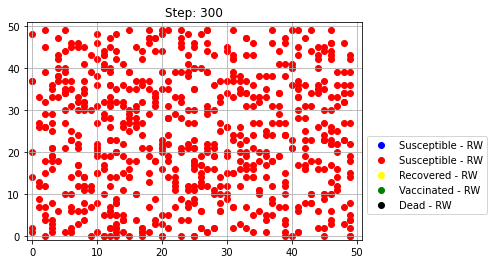

Healthy people= 0
Sick people= 683
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0

 Iteration 33


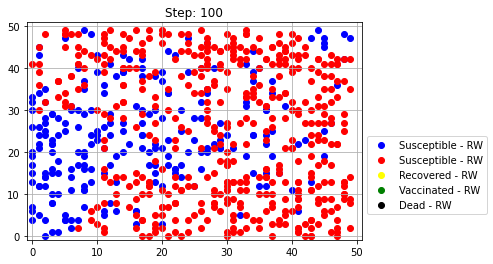

Healthy people= 220
Sick people= 463
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0


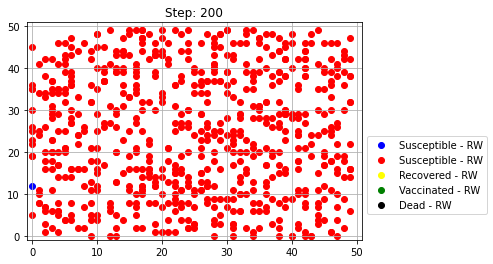

Healthy people= 1
Sick people= 682
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0


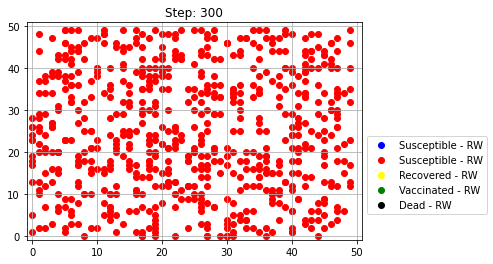

Healthy people= 0
Sick people= 683
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0

 Iteration 34


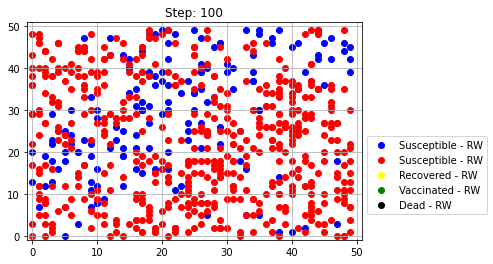

Healthy people= 156
Sick people= 527
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0


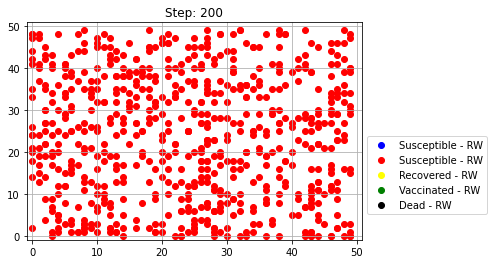

Healthy people= 0
Sick people= 683
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0


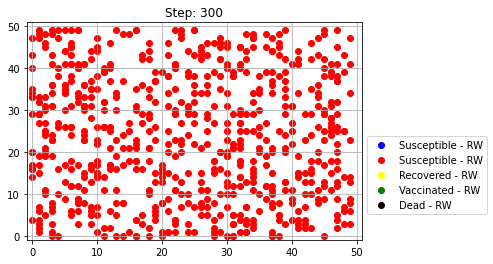

Healthy people= 0
Sick people= 683
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0

 Iteration 35


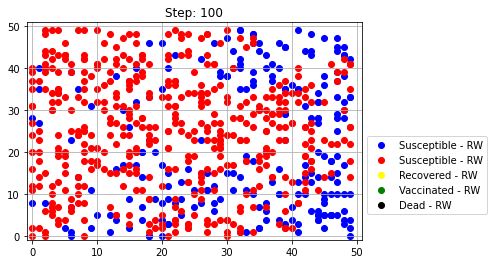

Healthy people= 214
Sick people= 469
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0


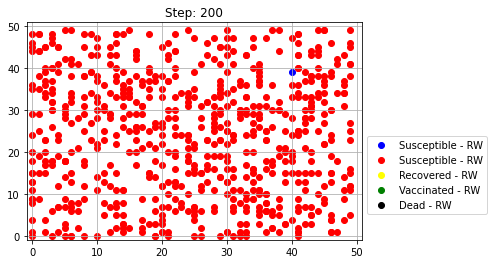

Healthy people= 1
Sick people= 682
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0


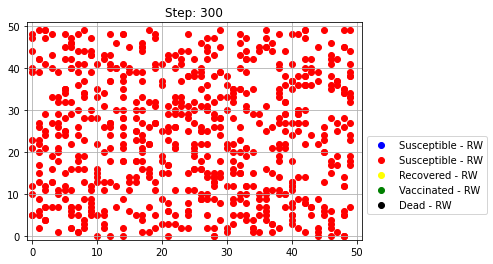

Healthy people= 0
Sick people= 683
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0

 Iteration 36


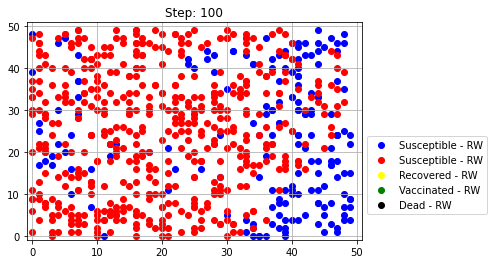

Healthy people= 177
Sick people= 506
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0


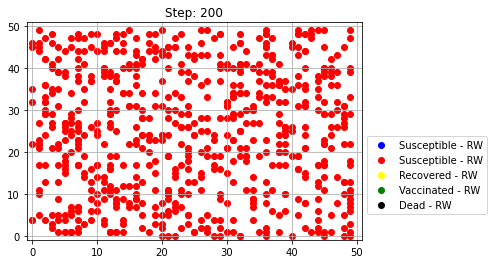

Healthy people= 0
Sick people= 683
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0


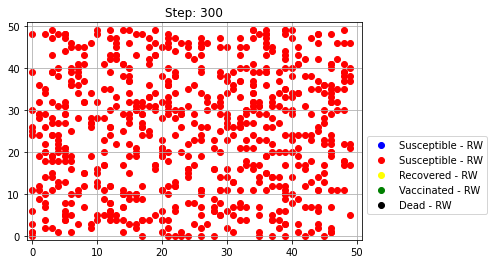

Healthy people= 0
Sick people= 683
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0

 Iteration 37


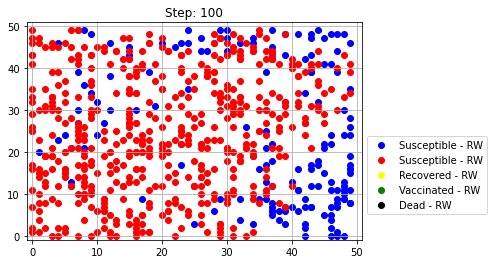

Healthy people= 156
Sick people= 527
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0


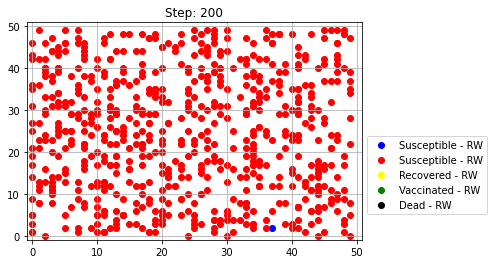

Healthy people= 1
Sick people= 682
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0


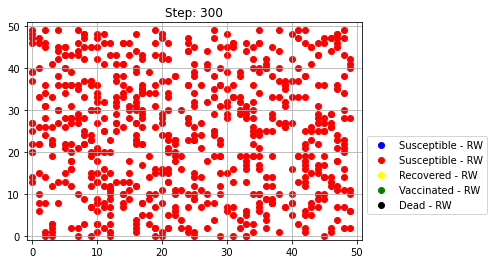

Healthy people= 0
Sick people= 683
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0

 Iteration 38


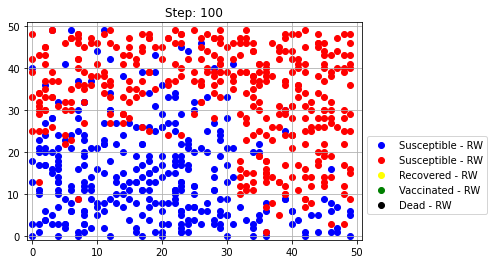

Healthy people= 311
Sick people= 372
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0


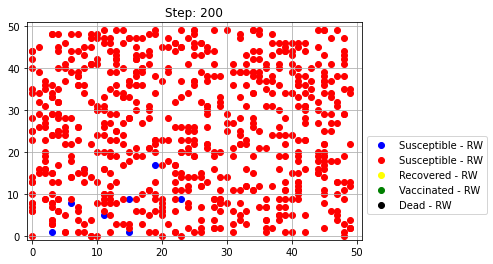

Healthy people= 7
Sick people= 676
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0


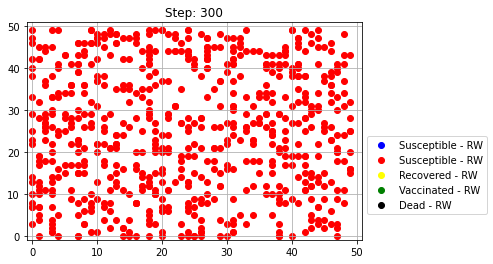

Healthy people= 0
Sick people= 683
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0

 Iteration 39


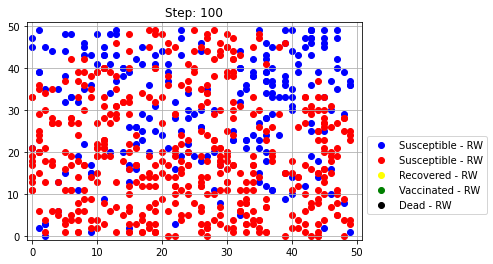

Healthy people= 220
Sick people= 463
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0


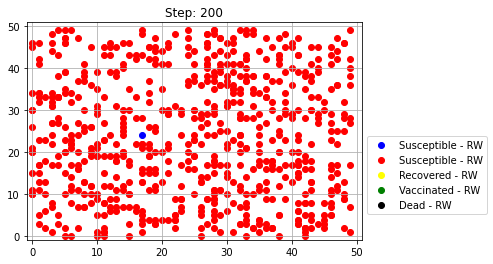

Healthy people= 1
Sick people= 682
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0


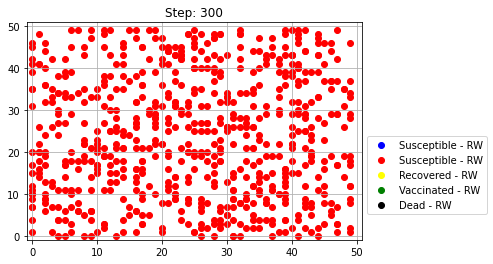

Healthy people= 0
Sick people= 683
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0

 Iteration 40


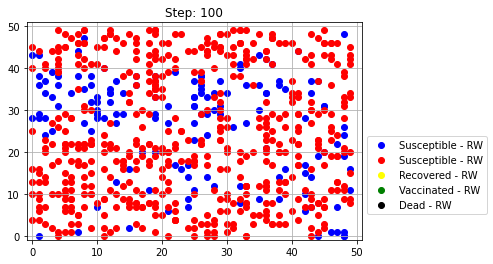

Healthy people= 140
Sick people= 543
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0


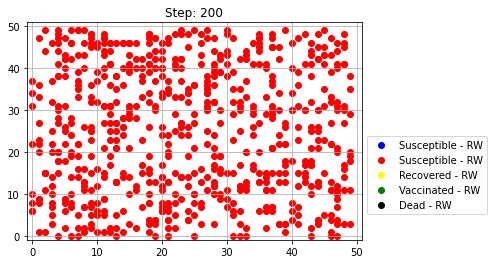

Healthy people= 0
Sick people= 683
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0


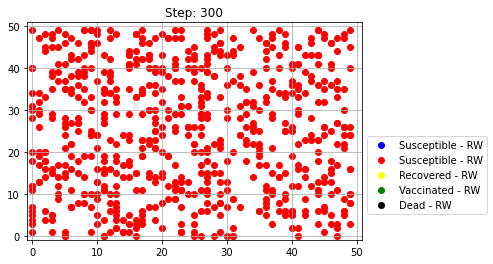

Healthy people= 0
Sick people= 683
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0

 Iteration 41


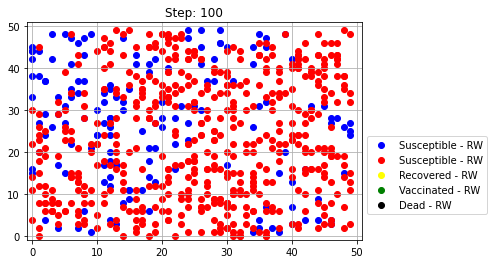

Healthy people= 148
Sick people= 535
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0


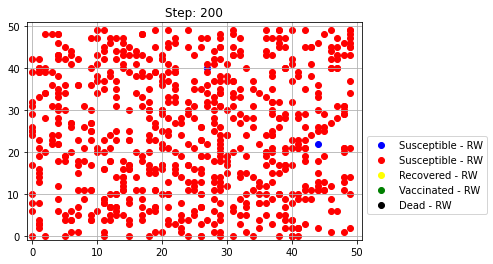

Healthy people= 2
Sick people= 681
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0


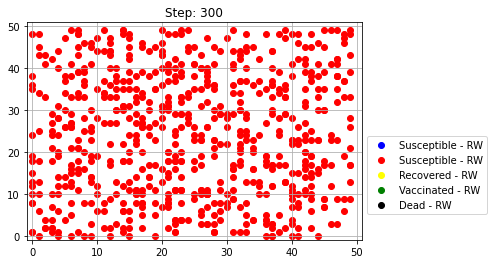

Healthy people= 0
Sick people= 683
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0

 Iteration 42


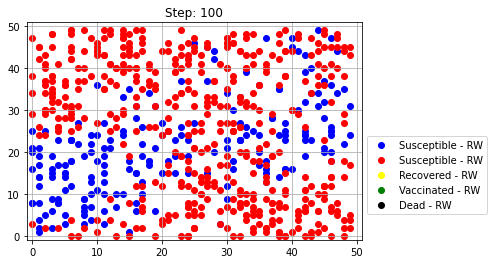

Healthy people= 199
Sick people= 484
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0


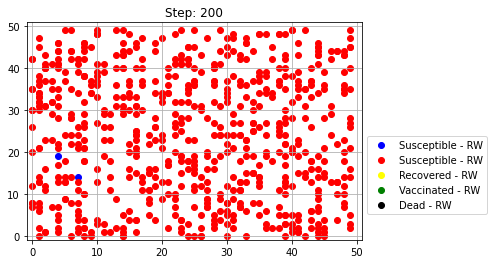

Healthy people= 2
Sick people= 681
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0


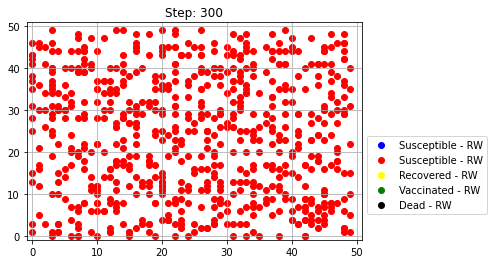

Healthy people= 0
Sick people= 683
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0

 Iteration 43


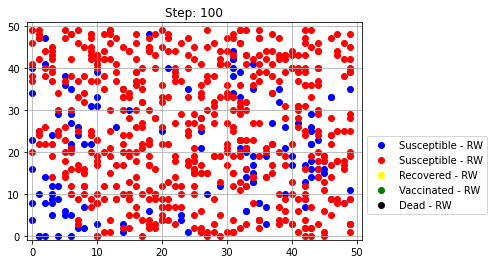

Healthy people= 125
Sick people= 558
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0


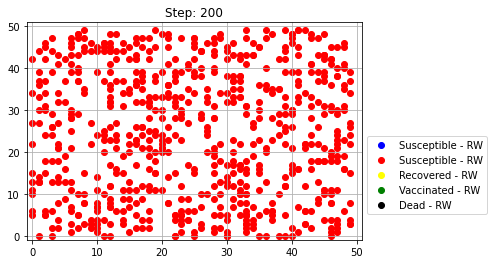

Healthy people= 0
Sick people= 683
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0


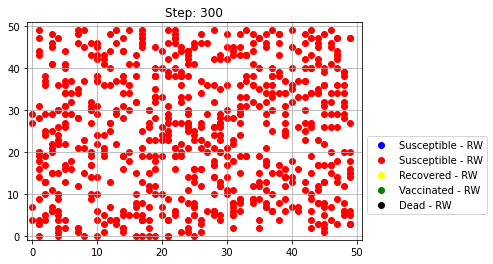

Healthy people= 0
Sick people= 683
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0

 Iteration 44


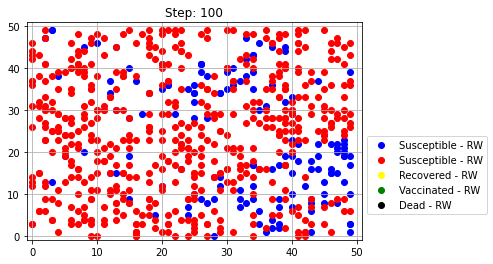

Healthy people= 138
Sick people= 545
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0


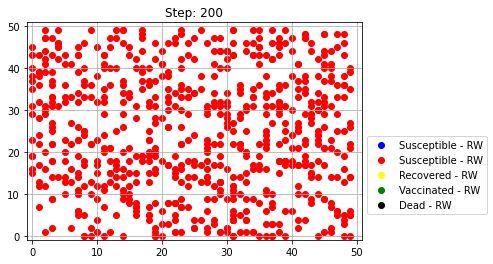

Healthy people= 0
Sick people= 683
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0


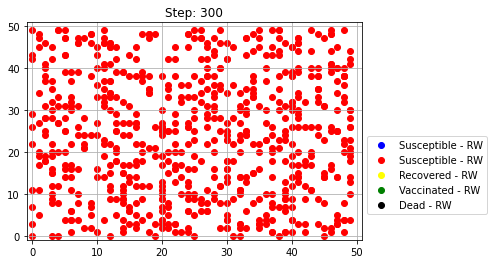

Healthy people= 0
Sick people= 683
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0

 Iteration 45


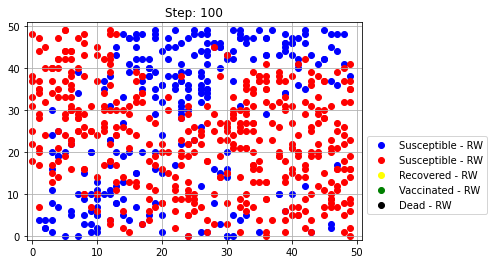

Healthy people= 247
Sick people= 436
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0


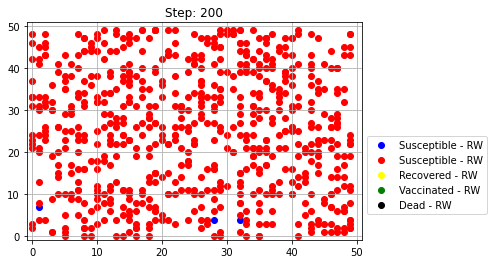

Healthy people= 3
Sick people= 680
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0


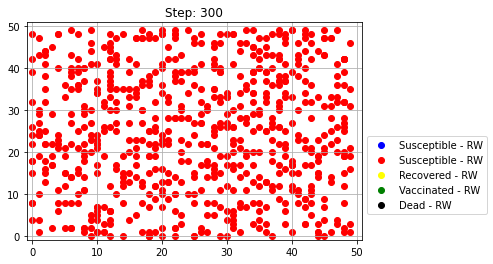

Healthy people= 0
Sick people= 683
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0

 Iteration 46


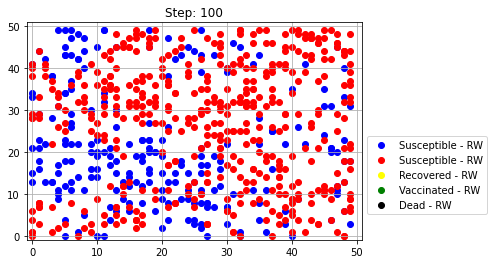

Healthy people= 223
Sick people= 460
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0


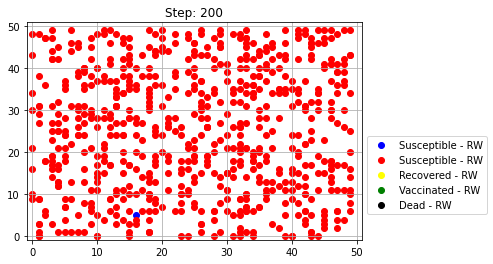

Healthy people= 1
Sick people= 682
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0


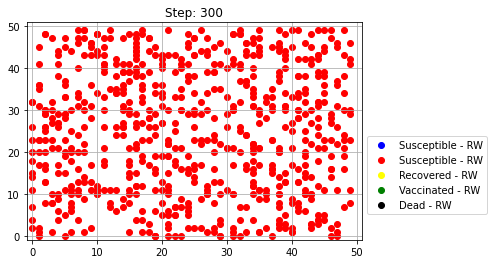

Healthy people= 0
Sick people= 683
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0

 Iteration 47


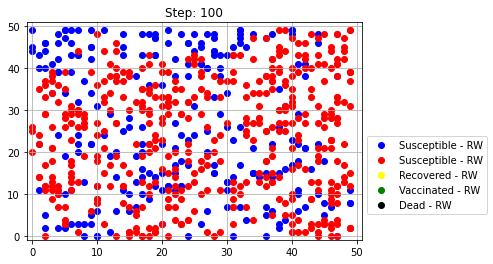

Healthy people= 229
Sick people= 454
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0


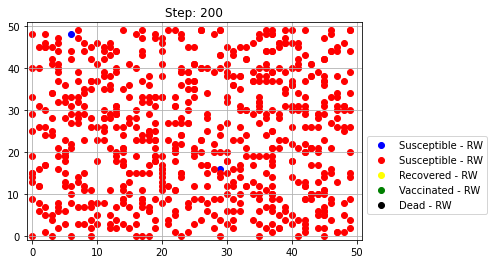

Healthy people= 2
Sick people= 681
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0


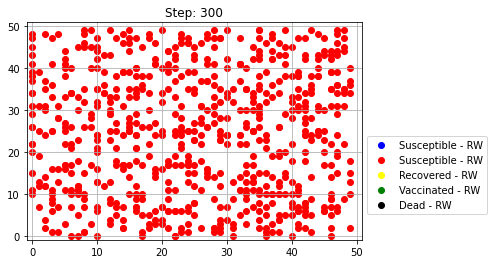

Healthy people= 0
Sick people= 683
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0

 Iteration 48


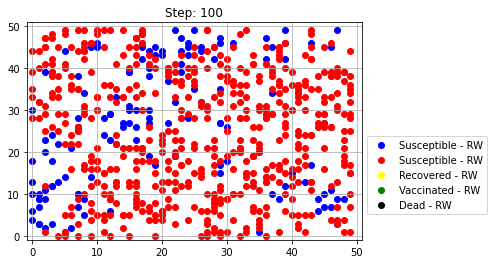

Healthy people= 130
Sick people= 553
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0


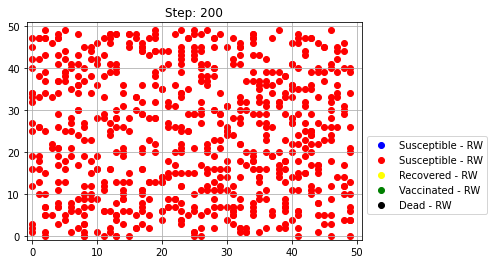

Healthy people= 0
Sick people= 683
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0


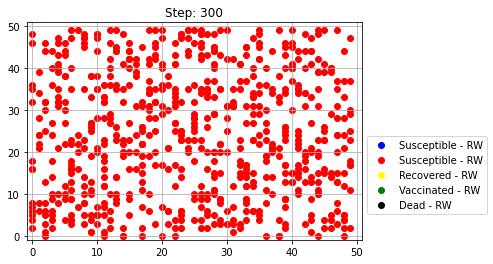

Healthy people= 0
Sick people= 683
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0

 Iteration 49


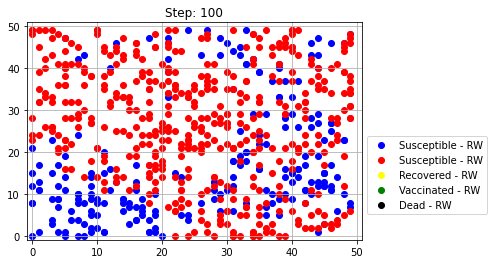

Healthy people= 217
Sick people= 466
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0


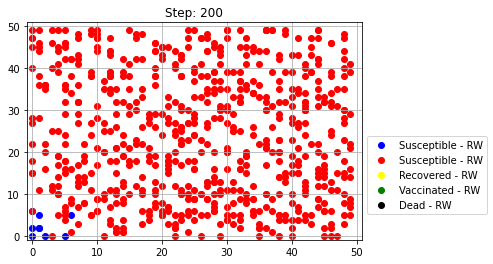

Healthy people= 8
Sick people= 675
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0


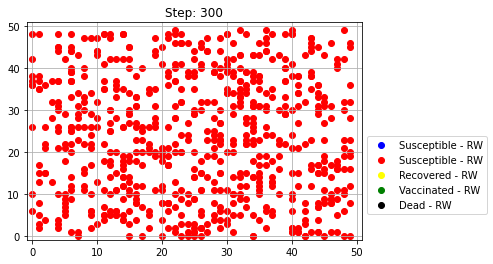

Healthy people= 0
Sick people= 683
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0

 Iteration 50


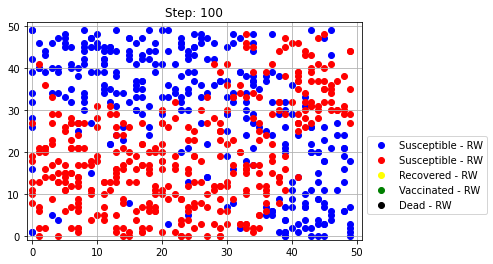

Healthy people= 311
Sick people= 372
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0


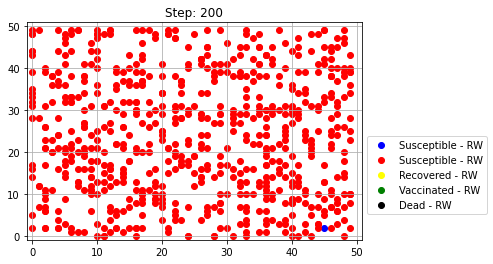

Healthy people= 1
Sick people= 682
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0


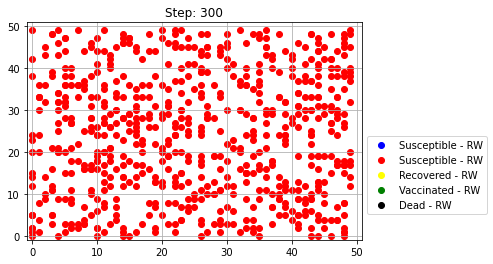

Healthy people= 0
Sick people= 683
Recovered people= 0
Vaccinated people= 0
Dead people= 0
 Dead seniors 0
 Dead juniors 0


In [9]:
# The initial infected people is equal to 10 and infection probapilitty is 0.45 in this part
inf, sus,rec,vac,dea=np.array([]),np.array([]), np.array([]), np.array([]), np.array([])
n,m=50,300 # n is number of iterations and m is time step
for i in range(n):
    print('\n Iteration {}'.format(i+1))
    ex2p4 = RandomWalkEpidemicSimulator(population_size=683,no_init_infected=10,nx=50, ny=50,p_infected=0.45,plot_radomwalk=True,plot_mean=True,plot_mean10=True,plot_beta=True) 
    inf_temp, sus_temp,rec_temp,vac_temp,dea_temp=ex2p4.simulatior_every_step(m)
    inf=np.append(inf,inf_temp)
    sus=np.append(sus,sus_temp)
    rec=np.append(rec,rec_temp)
    vac=np.append(vac,vac_temp)
    dea=np.append(dea,dea_temp)

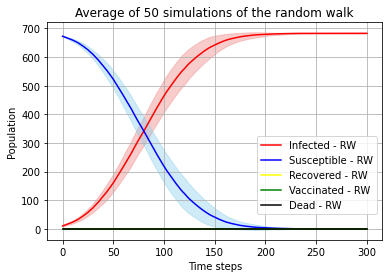

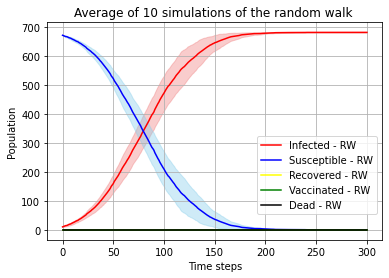

In [10]:
# Mean and sd plot of susseptible and infected people when initial infected = 10 and q=0.45
ex2p4.SI_mean_sd_plot(inf,sus,rec,vac,dea,m+1)


<ipython-input-2-3f820b7cf966>:259: RuntimeWarning: divide by zero encountered in double_scalars
  beta_deltat.append(-(self.sus_mean[i]-self.sus_mean[i-1])*self.N/self.sus_mean[i]/self.inf_mean[i])
<ipython-input-2-3f820b7cf966>:259: RuntimeWarning: invalid value encountered in double_scalars
  beta_deltat.append(-(self.sus_mean[i]-self.sus_mean[i-1])*self.N/self.sus_mean[i]/self.inf_mean[i])


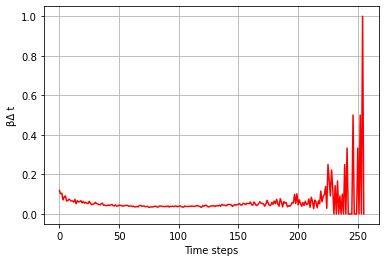


The βΔ t  [ 0.118573    0.1020384   0.10486294  0.07061413  0.08486609  0.09119632
  0.06524758  0.06807256  0.07449338  0.06965408  0.06465635  0.06609099
  0.05956998  0.07321529  0.05107415  0.06683053  0.06034592  0.06242551
  0.06691519  0.0558721   0.06336279  0.05427871  0.05863779  0.05360378
  0.05239592  0.06366763  0.05398399  0.04665506  0.04896252  0.05066566
  0.05854964  0.05255334  0.05131878  0.04692994  0.04584934  0.05138182
  0.05427134  0.04406042  0.04445994  0.04193214  0.04180035  0.04536403
  0.04219992  0.04516901  0.04806646  0.04168682  0.04001866  0.04562384
  0.03881605  0.04009818  0.04488867  0.04374002  0.04192761  0.03876292
  0.04082835  0.04307791  0.04188866  0.04378524  0.03888017  0.04005513
  0.04054417  0.03727908  0.03889022  0.03577661  0.03579118  0.03818733
  0.0358513   0.0428877   0.04274256  0.03878668  0.03960309  0.03948117
  0.03631011  0.03851607  0.03684084  0.03356085  0.03466096  0.03577595
  0.03515353  0.03724754  0.03854785  0.

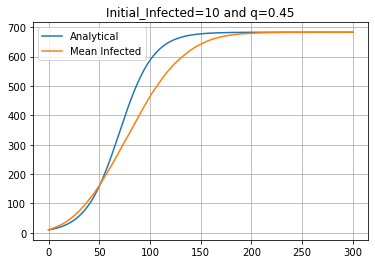

In [11]:
ex2p4.beta_deltat_plot() 
ex2p4.analytical_I()

- Is it easier to match your results to the SI model? If yes, why?   
  **Answer:**  
  According to the equation 3, when we increase both initial infections and $\beta$ at the same time, we can see that analytical curve get addapt to a linear-straight shape, since the denominator on the equation becomes closer to 1. It is important to mention that Random Walk model assumes that at some point all population get infected and     remain in this way along the time.

# Exercise 3: Extend to the SIR-model

The classic SIR-model is obtained from the SI-model by adding one more compartment: R(t): The number of "Recovered" individuals at time t . The ODE-based, deterministic SIR-model is

\begin{align}
\tag{5}
\frac{\mathrm{d}S(t)}{\mathrm{d}t}&=-\beta(t)\cdot\frac{S(t)I(t)}{N}\\ 
\tag{6}
\frac{\mathrm{d}I(t)}{\mathrm{d}t}&=\beta(t)\cdot\frac{S(t)I(t)}{N}-\frac{1}{\tau_\text{sick}}\cdot I(t)\\ 
\tag{7}
\frac{\mathrm{d}R(t)}{\mathrm{d}t}& = \frac{1}{\tau_\text{sick}}\cdot I(t)\,,
\end{align}

where τ_sick represents the mean time of infection, i.e., the time until recovery. If τ_sick → $\infty$ , a person stays sick forever, and equations (5)-(7) reduce to the SI - model.

## Part 1:
We would like to include the effect of recovery from the disease into the random walk model as well. This means that you have to extend your code by introducing a "recovered" state; see the Appendix for tips on how to do this. For simplicity, we shall assume that at the end of each time step, every infected person has a small probability of recovery, $ p_{recover} $
.

- Extend your random walk model to handle the SIR-model. By default, assume that no individuals recover, $p_{recover} $=0 (i.e., so that you get the SI-model by default).

Implementation tip: For each infected person, pick a random number between 0 and 1; if it is smaller than precove, update the status of the person to the recovered state.

**Solution:** We have included below code of this part inside the class

        #ex3p1 whether to be recovered
        Chance_rec_index=np.where(self.State==self.INFECTIOUS)[0]
        p=np.random.uniform(0,1,len(Chance_rec_index))
        rec_index=Chance_rec_index[p<np.full(shape=len(Chance_rec_index),fill_value=self.p_recovered)]
        self.State[rec_index]=self.RECOVERED

## Part 2:
Let $p_{recover} $ =0.01 , and otherwise choose the same input parameters as for the SI -model in the previous exercise. In terms of the ODE-based SIR-model, this corresponds to a scenario with a finite time duration of the disease, 0 < $\tau_\text{sick} < \infty$.
- Plot the average number of susceptible, infected and recovered as a function of time. (Use several model runs and include the uncertainty)


**Solution:**

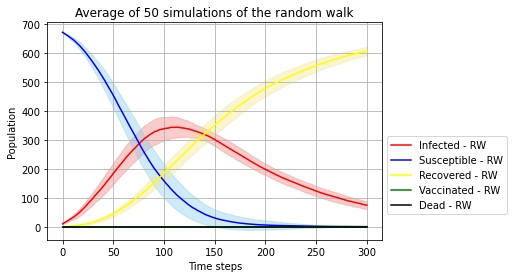

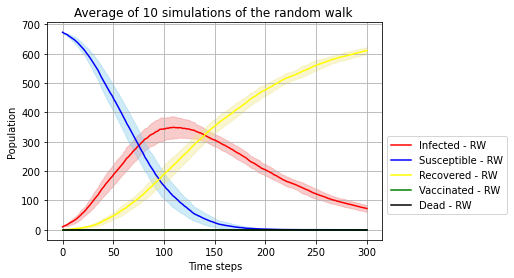

In [12]:
# We use initial infected people=10
inf, sus,rec,vac,dea=np.array([]),np.array([]), np.array([]), np.array([]), np.array([])   
n,m=50,300 # n is number of iterations and m is time step
for i in range(n):
    ex3p2 = RandomWalkEpidemicSimulator(population_size=683,no_init_infected=10,nx=50, ny=50,  
                                        p_infected=0.9,plot_mean=True,plot_mean10=True,p_recovered=0.01)
    inf_temp, sus_temp,rec_temp,vac_temp,dea_temp=ex3p2.simulatior_every_step(m)
    inf=np.append(inf,inf_temp)
    sus=np.append(sus,sus_temp)
    rec=np.append(rec,rec_temp)
    vac=np.append(vac,vac_temp)
    dea=np.append(dea,dea_temp)
ex3p2.SI_mean_sd_plot(inf,sus,rec,vac,dea,m+1)



## Part 3

- Increase $ p_{recover}$ by a factor of 10.

**Solution:**

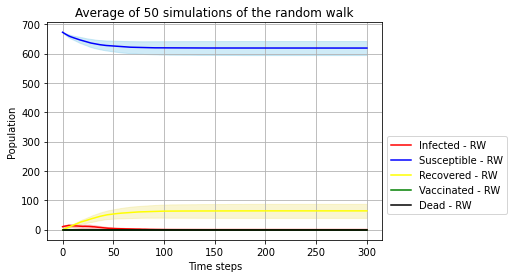

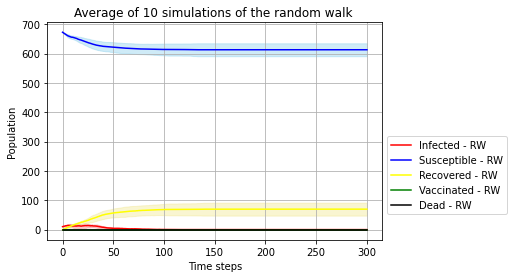

In [13]:
inf, sus,rec,vac,dea=np.array([]),np.array([]), np.array([]), np.array([]), np.array([])   
n,m=50,300
for i in range(n):
    # P_recovered is increased y´by a factor of 10
    ex3p3 = RandomWalkEpidemicSimulator(population_size=683,no_init_infected=10,nx=50, ny=50, 
                                        p_infected=0.9,plot_mean=True,plot_mean10=True,p_recovered=0.1) 
    inf_temp, sus_temp,rec_temp,vac_temp,dea_temp=ex3p3.simulatior_every_step(m)
    inf=np.append(inf,inf_temp)
    sus=np.append(sus,sus_temp)
    rec=np.append(rec,rec_temp)
    vac=np.append(vac,vac_temp)
    dea=np.append(dea,dea_temp)    
ex3p3.SI_mean_sd_plot(inf,sus,rec,vac,dea,m+1)

- What happens now?  
 **Answer:**  
By increasing the recover probability, the less susceptible people becomes infected in the starting of epidemic and at same moment the majority of the infected goes recovered. It means the immunity is an another way to stop the disease.

## Part 4:
The basic reproduction number, or basic reproduction ratio, $\mathcal{R}_0$, is defined as "the expected number of secondary cases produced, in a completely susceptible population, by a typical infected individual during its entire period of infectiousness". It is a very important measure for estimating whether a disease can spread in a population. For the deterministic SIR-model with constant β
, it can be shown that.


\begin{equation}
\mathcal{R}_0=\beta\cdot\tau_\text{sick}\,.
\tag{8}
\end{equation}

As with β , we can estimate $τ_{sick}$ in the SIR-model from the random walk simulations by using an appropriate finite different discretization, in this case from equation (7)

\begin{equation}
\tag{9}
\frac{\tau_\text{sick}}{\Delta t} \approx \frac{I_n}{R_{n}-R_{n-1}}\,.
\end{equation}

- Calculate average values for both β and $τ_{sick}$ based on random walk simulations. Note that equation (9) only makes sense if Rn−1≠Rn.


**Solution:**

In [14]:
inf, sus,rec,vac,dea=np.array([]),np.array([]), np.array([]), np.array([]), np.array([])   
n,m=50,600 # n is number of iterations and m is time step
for i in range(n):
    ex3p4 = RandomWalkEpidemicSimulator(population_size=683,no_init_infected=1,nx=50, ny=50, p_infected=0.9, p_recovered=0.01) 
    inf_temp, sus_temp,rec_temp,vac_temp,dea_temp=ex3p4.simulatior_every_step(m)
    inf=np.append(inf,inf_temp)
    sus=np.append(sus,sus_temp)
    rec=np.append(rec,rec_temp)
    vac=np.append(vac,vac_temp)
    dea=np.append(dea,dea_temp) 
ex3p4.SI_mean_sd_plot(inf,sus,rec,vac,dea,m+1)
averag_beta_ex3p4=ex3p4.beta_deltat_plot() 
average_tau_sick_ex3p4= ex3p4.tau_sick()


The average β-value  0.027989582555808065
The average Taus_sick is 104.67555823593517


- Include in your discussion how the disease transmission can be related to the basic reproduction number.  
  **Answer:**  
 
   When $R_0$ > 1  the infection will be able to start spreading in a population. In another word it means that the    larger the value of $R_0$, the harder it is to control the epidemic.
   Based on our $R_0$ which is a most 2.88, so the infection will be able to start spreading in a population. [<sup>4</sup>](#refer-4) 

## Part 5:OPTIONAL:
- Use the average values as input to the deterministic SIR-model. 

**Solution:**

In [15]:
def SIR_model(t,*,beta,tau_s,N=683,I0=10,R0=0):
    def rhs(X,t):
        S,I,R=X
        return [-beta*S*I/N,(beta*S*I/N - I/tau_s),I/tau_s]
    X0=[N-I0-R0,I0,R0]
    sol=sp.integrate.odeint(rhs,X0,t)
    return sol

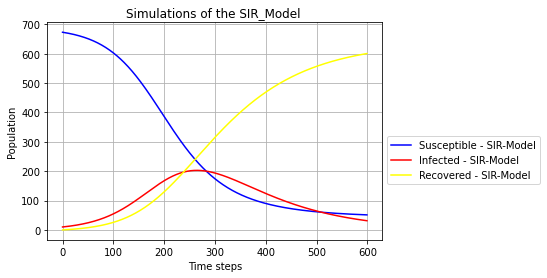

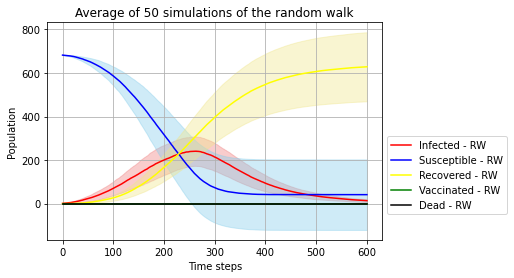

In [16]:
t_array=np.linspace(0,600,600)
solution=SIR_model(t=t_array,beta=averag_beta_ex3p4,tau_s=average_tau_sick_ex3p4)

S=solution[:,0]
I=solution[:,1]
R=solution[:,2]

solution=SIR_model(t=t_array,beta=averag_beta_ex3p4,tau_s=average_tau_sick_ex3p4)
plt.plot(S,color="Blue",label="Susceptible - SIR-Model")
plt.plot(I,color="Red",label="Infected - SIR-Model")
plt.plot(R,color='yellow',label='Recovered - SIR-Model')
plt.xlabel("Time steps")
plt.ylabel("Population")
plt.title("Simulations of the SIR_Model ")
plt.legend(bbox_to_anchor=(1,0.5))
plt.grid()
plt.show()

# We use initial infected people=1 in order to compare with SIR-model
inf, sus,rec,vac,dea=np.array([]),np.array([]), np.array([]), np.array([]), np.array([])   
n,m=50,600 # n is number of iterations and m is time step
for i in range(n):
    ex3p5 = RandomWalkEpidemicSimulator(population_size=683,no_init_infected=1,nx=50, ny=50,
                                        p_infected=0.9,p_recovered=0.01,plot_mean=True) 
    inf_temp, sus_temp,rec_temp,vac_temp,dea_temp=ex3p5.simulatior_every_step(m)
    inf=np.append(inf,inf_temp)
    sus=np.append(sus,sus_temp)
    rec=np.append(rec,rec_temp)
    vac=np.append(vac,vac_temp)
    dea=np.append(dea,dea_temp) 
ex3p5.SI_mean_sd_plot(inf,sus,rec,vac,dea,m+1)


- Compare the results with the random walk, and discuss.

   **Answer:**  
  Here we can see that the infected people is greater in RW-model than in SIR model, the maximun of people infected   at a same point of time in the RW-model it is more than 200  while in the SIR is almost less than 200. In the SIR   model at final time steps we can see that susceptible people start to become higher than infected, these           difference it is because probably some of the recover people go again to being part of the susceptible population   while in the Random Walk Model we assumed that recover people never become susceptible again, which makes recover   people curve being cumulative.

# Exercise 4: Implement your own scenario

Implemenation of our scenario and the assumptions 
- We allow people to die from the disease .
- We distinguish between sernior  and jonior people. We let older people have a larger probability of dying. In addition we let the die pepole are standing still (not moving)
- We added vaccination, i.e., if a person is vaccinated he/she will not become infected ever. In this part we let the  vaccination starts after 100 time step. 



 Iteration 1
514 juniors and 169 seniors


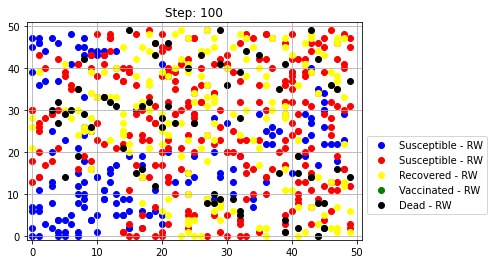

Healthy people= 149
Sick people= 288
Recovered people= 179
Vaccinated people= 0
Dead people= 67
 Dead seniors 47
 Dead juniors 20


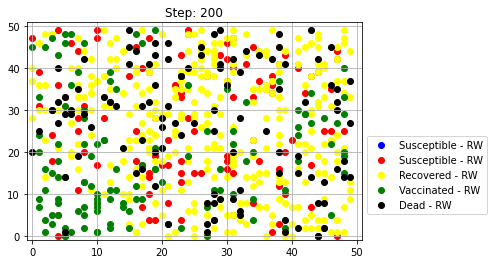

Healthy people= 0
Sick people= 107
Recovered people= 349
Vaccinated people= 117
Dead people= 110
 Dead seniors 76
 Dead juniors 34


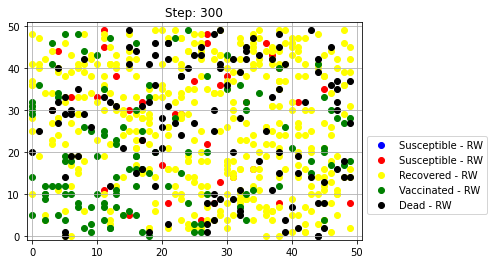

Healthy people= 0
Sick people= 34
Recovered people= 407
Vaccinated people= 117
Dead people= 125
 Dead seniors 81
 Dead juniors 44

 Iteration 2
280 juniors and 403 seniors


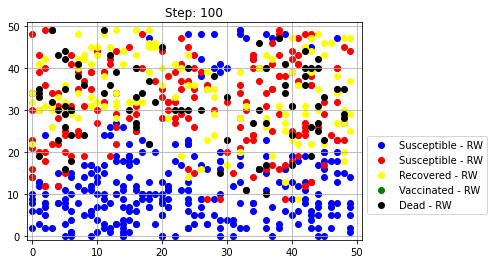

Healthy people= 278
Sick people= 191
Recovered people= 131
Vaccinated people= 0
Dead people= 83
 Dead seniors 74
 Dead juniors 9


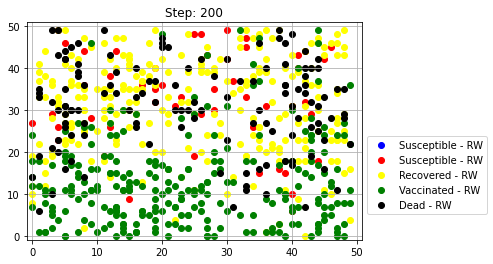

Healthy people= 0
Sick people= 50
Recovered people= 243
Vaccinated people= 261
Dead people= 129
 Dead seniors 116
 Dead juniors 13


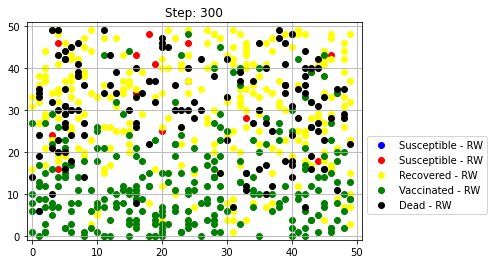

Healthy people= 0
Sick people= 16
Recovered people= 270
Vaccinated people= 261
Dead people= 136
 Dead seniors 120
 Dead juniors 16

 Iteration 3
281 juniors and 402 seniors


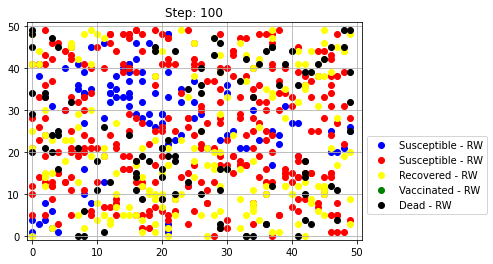

Healthy people= 97
Sick people= 306
Recovered people= 180
Vaccinated people= 0
Dead people= 100
 Dead seniors 89
 Dead juniors 11


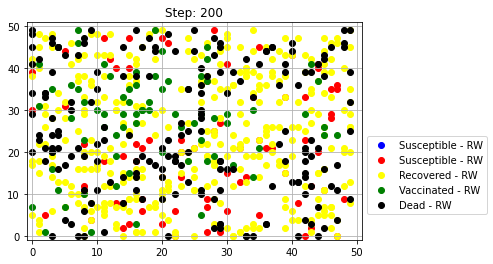

Healthy people= 0
Sick people= 75
Recovered people= 344
Vaccinated people= 74
Dead people= 190
 Dead seniors 166
 Dead juniors 24


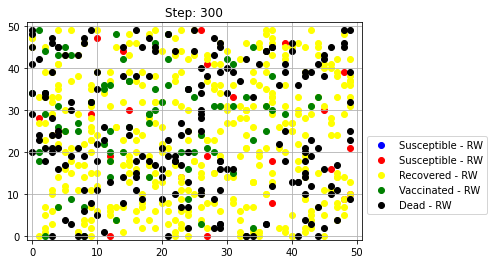

Healthy people= 0
Sick people= 23
Recovered people= 387
Vaccinated people= 74
Dead people= 199
 Dead seniors 172
 Dead juniors 27

 Iteration 4
383 juniors and 300 seniors


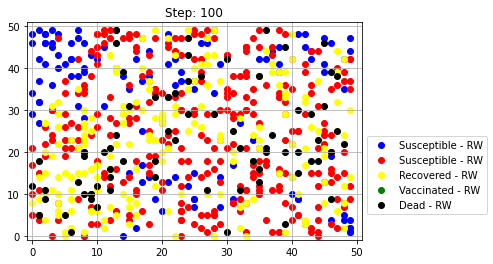

Healthy people= 110
Sick people= 310
Recovered people= 190
Vaccinated people= 0
Dead people= 73
 Dead seniors 66
 Dead juniors 7


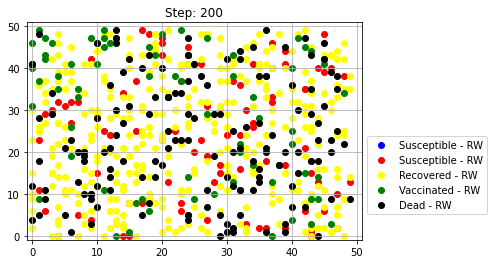

Healthy people= 0
Sick people= 87
Recovered people= 373
Vaccinated people= 76
Dead people= 147
 Dead seniors 128
 Dead juniors 19


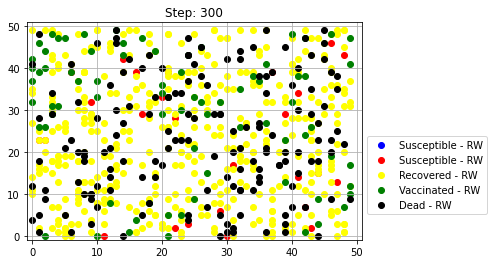

Healthy people= 0
Sick people= 25
Recovered people= 421
Vaccinated people= 76
Dead people= 161
 Dead seniors 137
 Dead juniors 24

 Iteration 5
555 juniors and 128 seniors


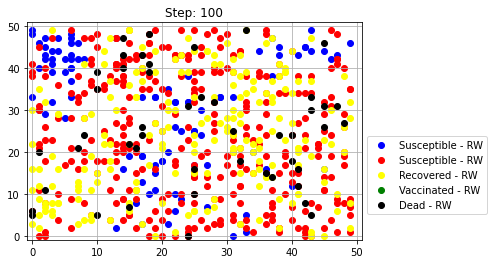

Healthy people= 92
Sick people= 336
Recovered people= 207
Vaccinated people= 0
Dead people= 48
 Dead seniors 28
 Dead juniors 20


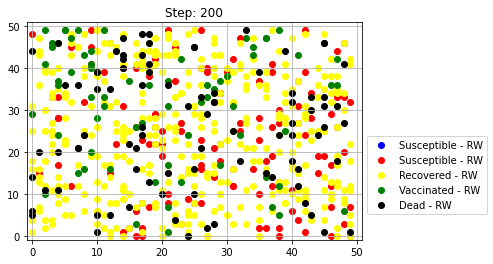

Healthy people= 0
Sick people= 124
Recovered people= 403
Vaccinated people= 70
Dead people= 86
 Dead seniors 49
 Dead juniors 37


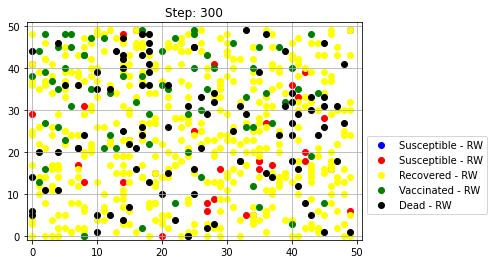

Healthy people= 0
Sick people= 33
Recovered people= 483
Vaccinated people= 70
Dead people= 97
 Dead seniors 52
 Dead juniors 45

 Iteration 6
419 juniors and 264 seniors


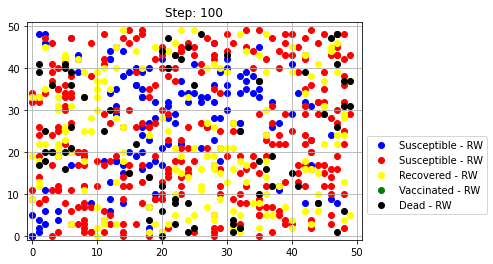

Healthy people= 125
Sick people= 315
Recovered people= 173
Vaccinated people= 0
Dead people= 70
 Dead seniors 61
 Dead juniors 9


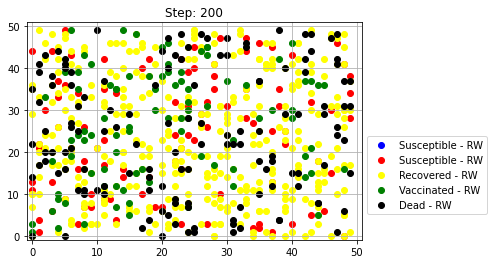

Healthy people= 0
Sick people= 98
Recovered people= 356
Vaccinated people= 91
Dead people= 138
 Dead seniors 116
 Dead juniors 22


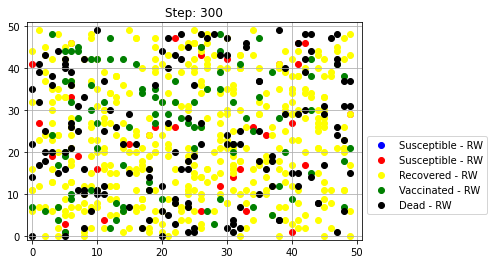

Healthy people= 0
Sick people= 33
Recovered people= 408
Vaccinated people= 91
Dead people= 151
 Dead seniors 123
 Dead juniors 28

 Iteration 7
527 juniors and 156 seniors


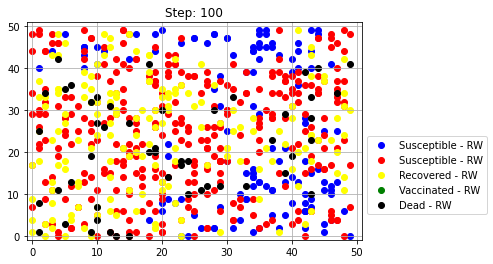

Healthy people= 126
Sick people= 333
Recovered people= 172
Vaccinated people= 0
Dead people= 52
 Dead seniors 39
 Dead juniors 13


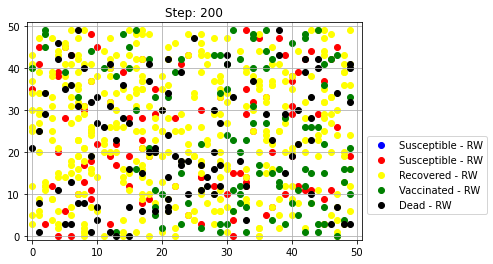

Healthy people= 0
Sick people= 95
Recovered people= 378
Vaccinated people= 105
Dead people= 105
 Dead seniors 74
 Dead juniors 31


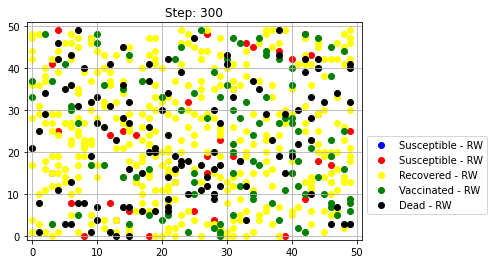

Healthy people= 0
Sick people= 41
Recovered people= 423
Vaccinated people= 105
Dead people= 114
 Dead seniors 76
 Dead juniors 38

 Iteration 8
393 juniors and 290 seniors


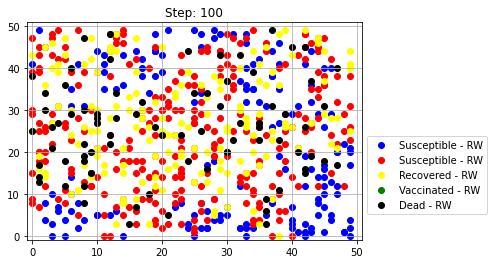

Healthy people= 160
Sick people= 275
Recovered people= 167
Vaccinated people= 0
Dead people= 81
 Dead seniors 69
 Dead juniors 12


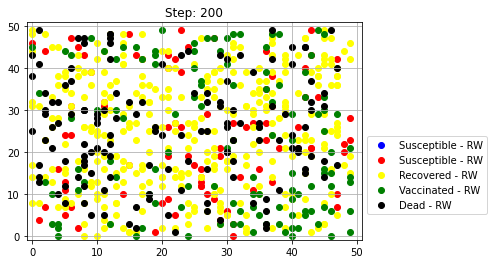

Healthy people= 0
Sick people= 85
Recovered people= 336
Vaccinated people= 120
Dead people= 142
 Dead seniors 117
 Dead juniors 25


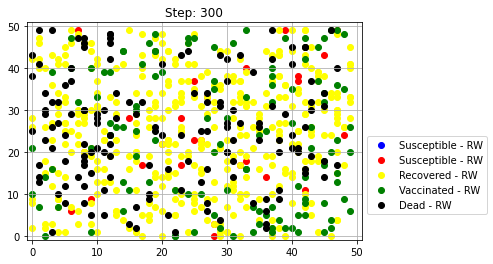

Healthy people= 0
Sick people= 26
Recovered people= 388
Vaccinated people= 120
Dead people= 149
 Dead seniors 121
 Dead juniors 28

 Iteration 9
20 juniors and 663 seniors


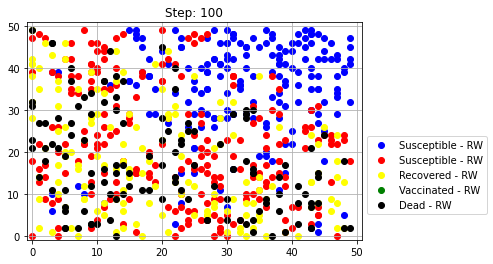

Healthy people= 182
Sick people= 219
Recovered people= 154
Vaccinated people= 0
Dead people= 128
 Dead seniors 128
 Dead juniors 0


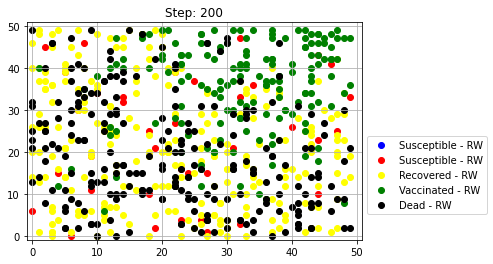

Healthy people= 0
Sick people= 38
Recovered people= 251
Vaccinated people= 160
Dead people= 234
 Dead seniors 234
 Dead juniors 0


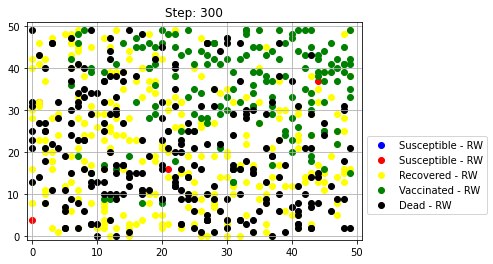

Healthy people= 0
Sick people= 5
Recovered people= 267
Vaccinated people= 160
Dead people= 251
 Dead seniors 251
 Dead juniors 0

 Iteration 10
123 juniors and 560 seniors


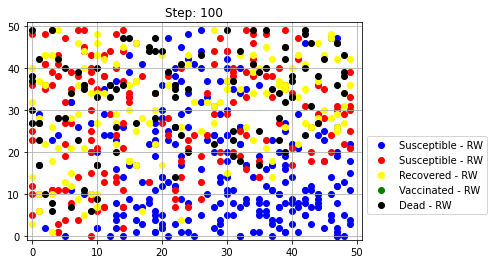

Healthy people= 252
Sick people= 185
Recovered people= 140
Vaccinated people= 0
Dead people= 106
 Dead seniors 102
 Dead juniors 4


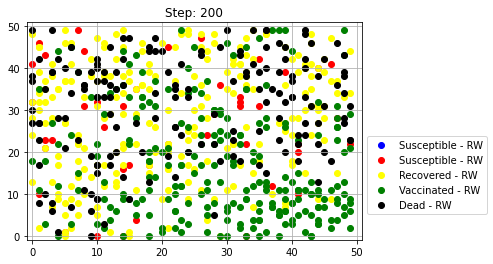

Healthy people= 0
Sick people= 44
Recovered people= 234
Vaccinated people= 238
Dead people= 167
 Dead seniors 160
 Dead juniors 7


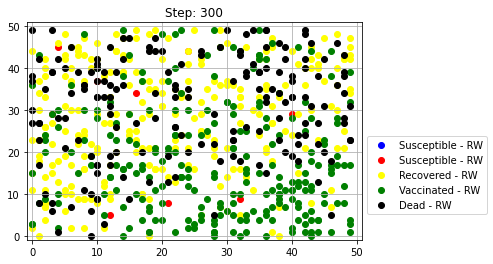

Healthy people= 0
Sick people= 9
Recovered people= 260
Vaccinated people= 238
Dead people= 176
 Dead seniors 169
 Dead juniors 7

 Iteration 11
388 juniors and 295 seniors


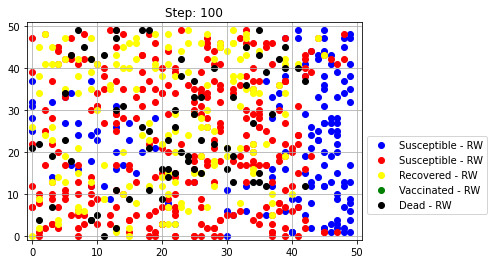

Healthy people= 139
Sick people= 302
Recovered people= 165
Vaccinated people= 0
Dead people= 77
 Dead seniors 67
 Dead juniors 10


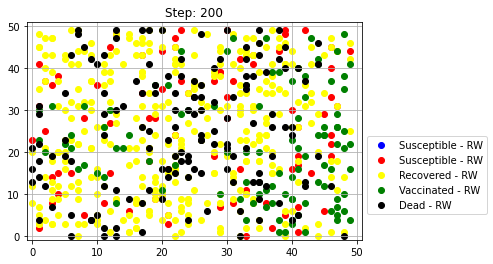

Healthy people= 0
Sick people= 83
Recovered people= 352
Vaccinated people= 102
Dead people= 146
 Dead seniors 124
 Dead juniors 22


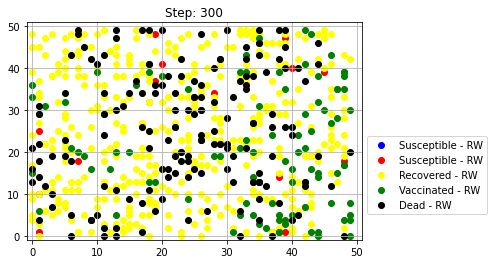

Healthy people= 0
Sick people= 19
Recovered people= 407
Vaccinated people= 102
Dead people= 155
 Dead seniors 129
 Dead juniors 26

 Iteration 12
167 juniors and 516 seniors


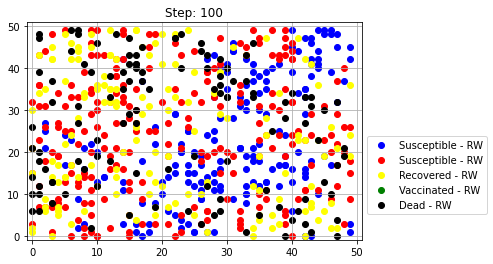

Healthy people= 179
Sick people= 233
Recovered people= 149
Vaccinated people= 0
Dead people= 122
 Dead seniors 118
 Dead juniors 4


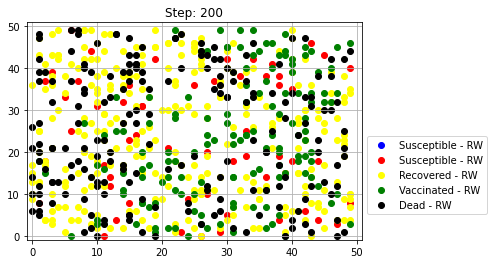

Healthy people= 0
Sick people= 56
Recovered people= 288
Vaccinated people= 142
Dead people= 197
 Dead seniors 189
 Dead juniors 8


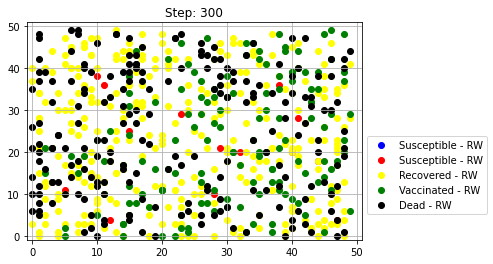

Healthy people= 0
Sick people= 15
Recovered people= 314
Vaccinated people= 142
Dead people= 212
 Dead seniors 204
 Dead juniors 8

 Iteration 13
559 juniors and 124 seniors


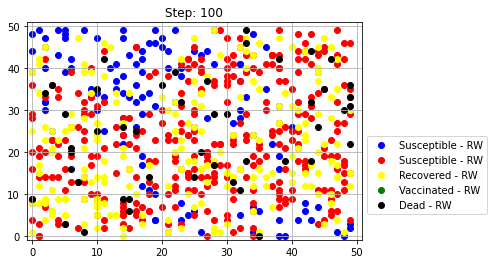

Healthy people= 108
Sick people= 330
Recovered people= 197
Vaccinated people= 0
Dead people= 48
 Dead seniors 31
 Dead juniors 17


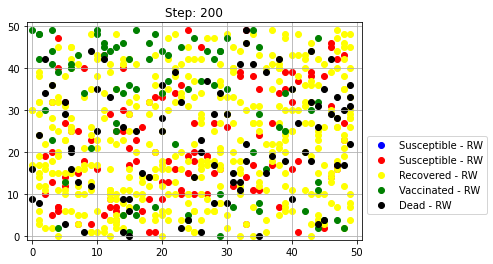

Healthy people= 0
Sick people= 111
Recovered people= 402
Vaccinated people= 82
Dead people= 88
 Dead seniors 53
 Dead juniors 35


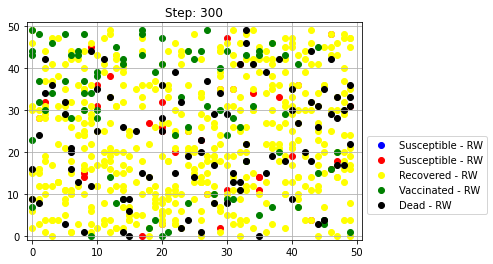

Healthy people= 0
Sick people= 36
Recovered people= 475
Vaccinated people= 82
Dead people= 90
 Dead seniors 53
 Dead juniors 37

 Iteration 14
469 juniors and 214 seniors


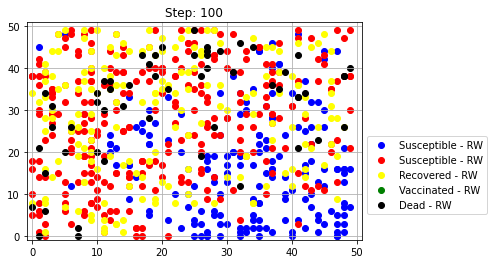

Healthy people= 165
Sick people= 284
Recovered people= 178
Vaccinated people= 0
Dead people= 56
 Dead seniors 48
 Dead juniors 8


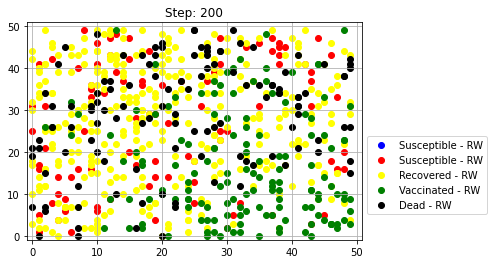

Healthy people= 0
Sick people= 94
Recovered people= 324
Vaccinated people= 145
Dead people= 120
 Dead seniors 94
 Dead juniors 26


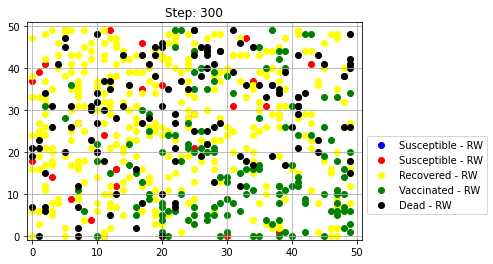

Healthy people= 0
Sick people= 33
Recovered people= 379
Vaccinated people= 145
Dead people= 126
 Dead seniors 98
 Dead juniors 28

 Iteration 15
105 juniors and 578 seniors


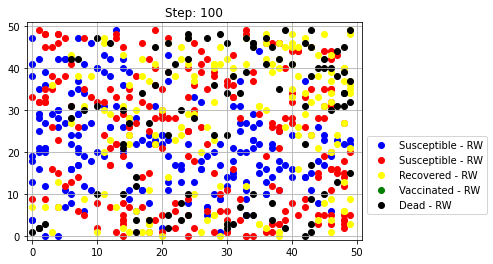

Healthy people= 192
Sick people= 233
Recovered people= 154
Vaccinated people= 0
Dead people= 104
 Dead seniors 100
 Dead juniors 4


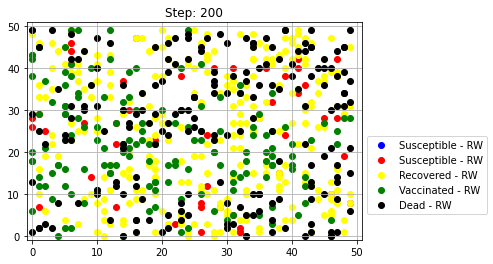

Healthy people= 0
Sick people= 49
Recovered people= 285
Vaccinated people= 151
Dead people= 198
 Dead seniors 192
 Dead juniors 6


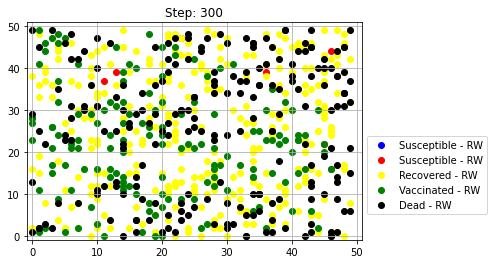

Healthy people= 0
Sick people= 9
Recovered people= 308
Vaccinated people= 151
Dead people= 215
 Dead seniors 207
 Dead juniors 8

 Iteration 16
42 juniors and 641 seniors


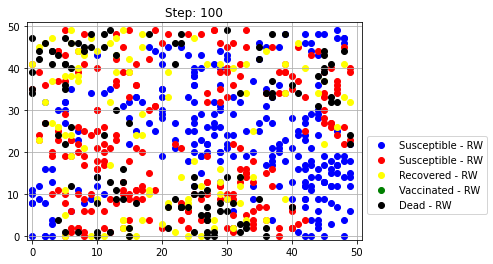

Healthy people= 235
Sick people= 222
Recovered people= 103
Vaccinated people= 0
Dead people= 123
 Dead seniors 122
 Dead juniors 1


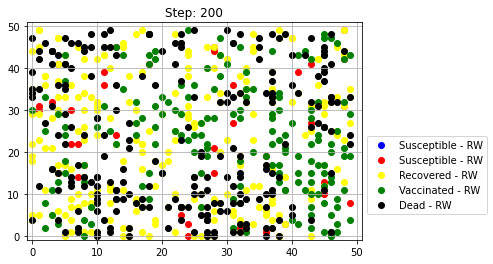

Healthy people= 0
Sick people= 37
Recovered people= 242
Vaccinated people= 174
Dead people= 230
 Dead seniors 228
 Dead juniors 2


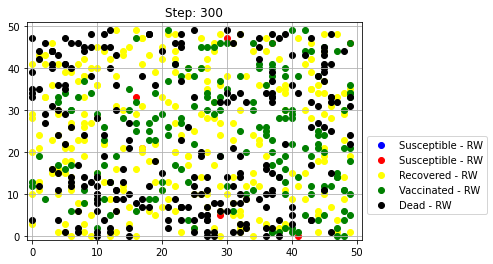

Healthy people= 0
Sick people= 7
Recovered people= 260
Vaccinated people= 174
Dead people= 242
 Dead seniors 240
 Dead juniors 2

 Iteration 17
393 juniors and 290 seniors


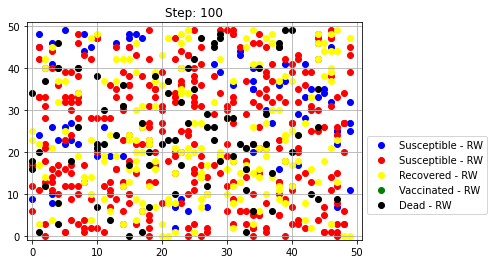

Healthy people= 68
Sick people= 336
Recovered people= 197
Vaccinated people= 0
Dead people= 82
 Dead seniors 70
 Dead juniors 12


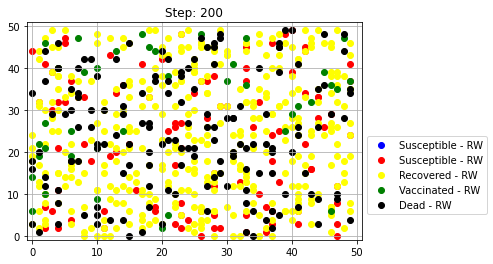

Healthy people= 0
Sick people= 100
Recovered people= 386
Vaccinated people= 39
Dead people= 158
 Dead seniors 122
 Dead juniors 36


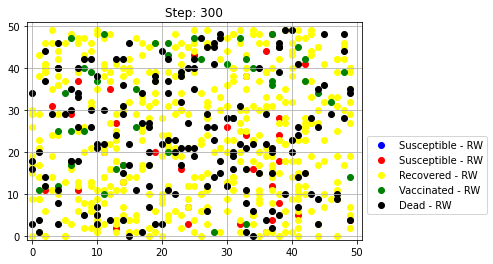

Healthy people= 0
Sick people= 33
Recovered people= 444
Vaccinated people= 39
Dead people= 167
 Dead seniors 128
 Dead juniors 39

 Iteration 18
275 juniors and 408 seniors


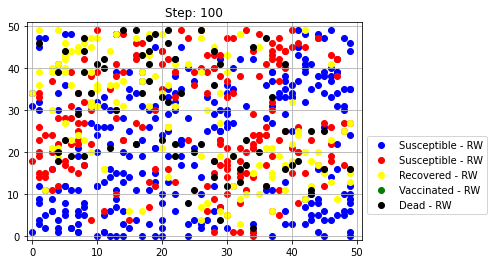

Healthy people= 277
Sick people= 201
Recovered people= 131
Vaccinated people= 0
Dead people= 74
 Dead seniors 68
 Dead juniors 6


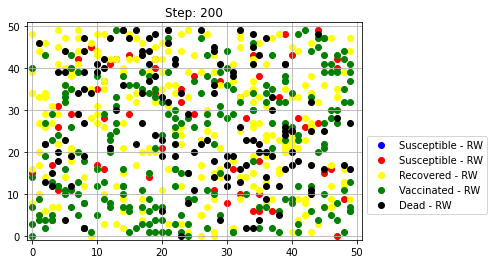

Healthy people= 0
Sick people= 55
Recovered people= 263
Vaccinated people= 231
Dead people= 134
 Dead seniors 117
 Dead juniors 17


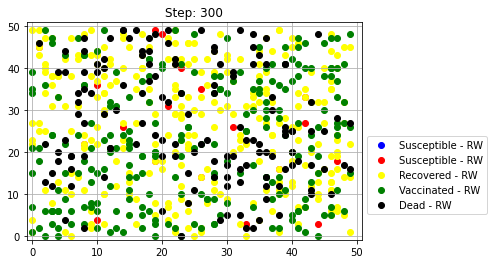

Healthy people= 0
Sick people= 19
Recovered people= 290
Vaccinated people= 231
Dead people= 143
 Dead seniors 123
 Dead juniors 20

 Iteration 19
11 juniors and 672 seniors


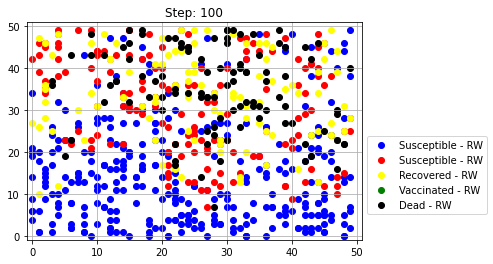

Healthy people= 309
Sick people= 167
Recovered people= 100
Vaccinated people= 0
Dead people= 107
 Dead seniors 107
 Dead juniors 0


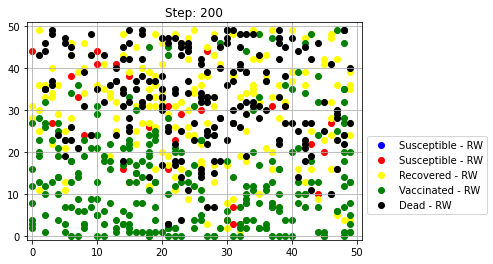

Healthy people= 0
Sick people= 32
Recovered people= 181
Vaccinated people= 274
Dead people= 196
 Dead seniors 196
 Dead juniors 0


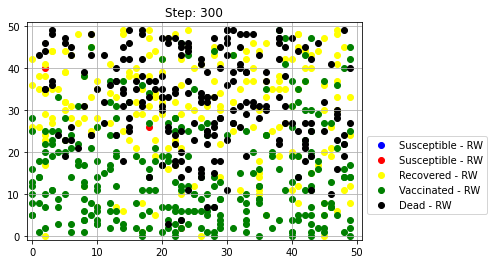

Healthy people= 0
Sick people= 3
Recovered people= 197
Vaccinated people= 274
Dead people= 209
 Dead seniors 209
 Dead juniors 0

 Iteration 20
68 juniors and 615 seniors


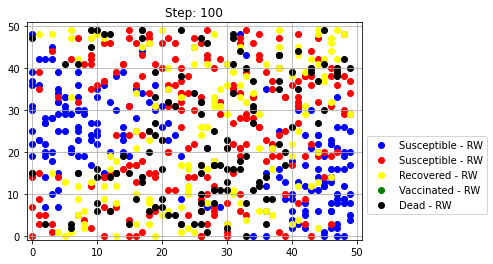

Healthy people= 188
Sick people= 230
Recovered people= 141
Vaccinated people= 0
Dead people= 124
 Dead seniors 119
 Dead juniors 5


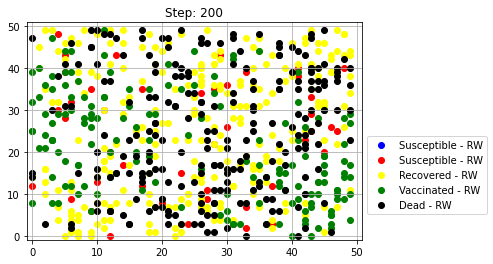

Healthy people= 0
Sick people= 47
Recovered people= 248
Vaccinated people= 160
Dead people= 228
 Dead seniors 222
 Dead juniors 6


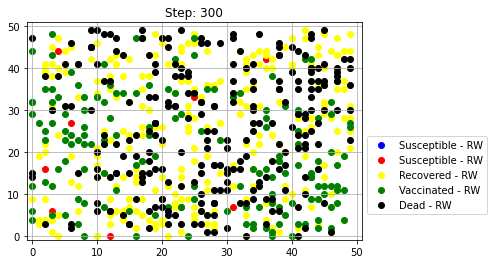

Healthy people= 0
Sick people= 9
Recovered people= 267
Vaccinated people= 160
Dead people= 247
 Dead seniors 241
 Dead juniors 6

 Iteration 21
639 juniors and 44 seniors


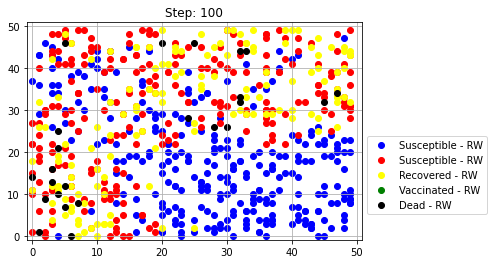

Healthy people= 276
Sick people= 243
Recovered people= 140
Vaccinated people= 0
Dead people= 24
 Dead seniors 13
 Dead juniors 11


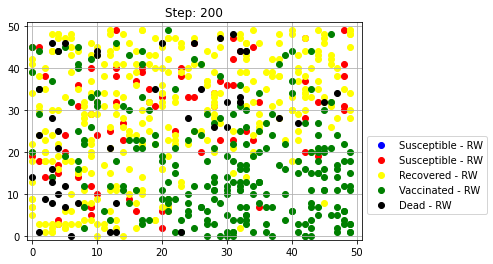

Healthy people= 0
Sick people= 76
Recovered people= 321
Vaccinated people= 242
Dead people= 44
 Dead seniors 16
 Dead juniors 28


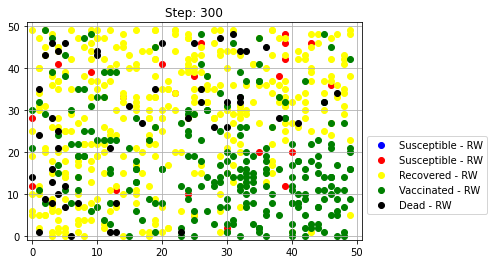

Healthy people= 0
Sick people= 24
Recovered people= 368
Vaccinated people= 242
Dead people= 49
 Dead seniors 16
 Dead juniors 33

 Iteration 22
380 juniors and 303 seniors


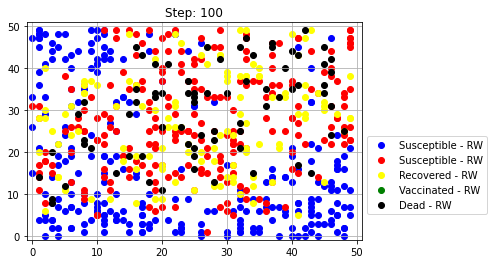

Healthy people= 251
Sick people= 235
Recovered people= 123
Vaccinated people= 0
Dead people= 74
 Dead seniors 63
 Dead juniors 11


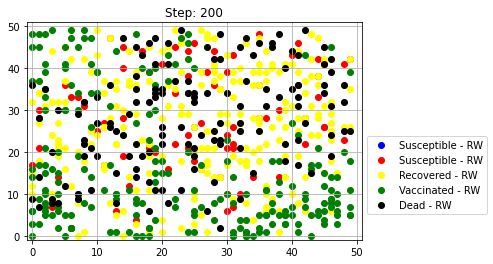

Healthy people= 0
Sick people= 76
Recovered people= 253
Vaccinated people= 218
Dead people= 136
 Dead seniors 114
 Dead juniors 22


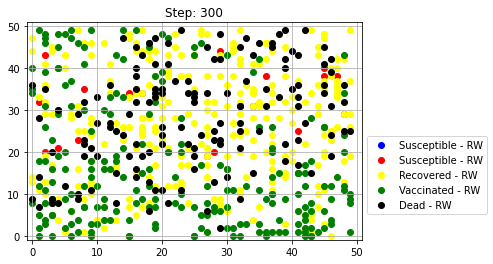

Healthy people= 0
Sick people= 20
Recovered people= 304
Vaccinated people= 218
Dead people= 141
 Dead seniors 116
 Dead juniors 25

 Iteration 23
378 juniors and 305 seniors


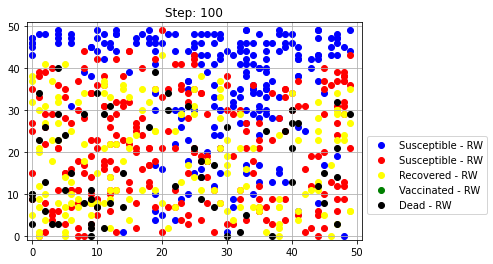

Healthy people= 209
Sick people= 250
Recovered people= 159
Vaccinated people= 0
Dead people= 65
 Dead seniors 57
 Dead juniors 8


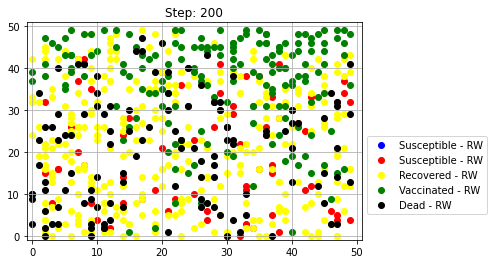

Healthy people= 0
Sick people= 68
Recovered people= 320
Vaccinated people= 172
Dead people= 123
 Dead seniors 104
 Dead juniors 19


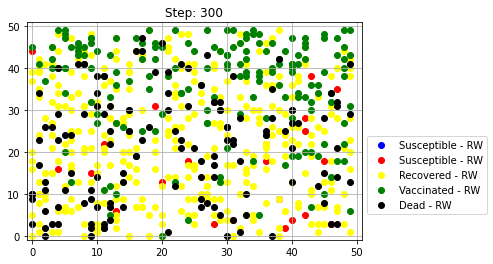

Healthy people= 0
Sick people= 22
Recovered people= 358
Vaccinated people= 172
Dead people= 131
 Dead seniors 111
 Dead juniors 20

 Iteration 24
215 juniors and 468 seniors


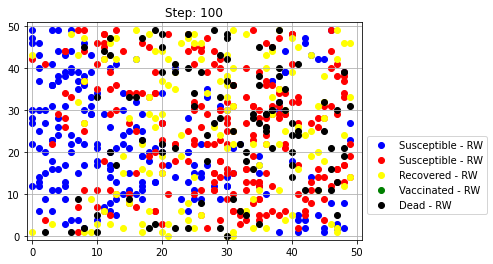

Healthy people= 197
Sick people= 242
Recovered people= 142
Vaccinated people= 0
Dead people= 102
 Dead seniors 93
 Dead juniors 9


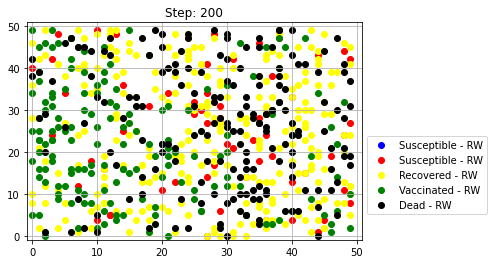

Healthy people= 0
Sick people= 59
Recovered people= 281
Vaccinated people= 159
Dead people= 184
 Dead seniors 168
 Dead juniors 16


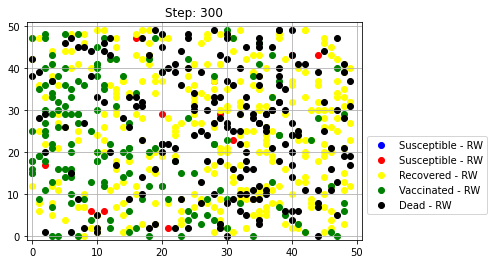

Healthy people= 0
Sick people= 12
Recovered people= 318
Vaccinated people= 159
Dead people= 194
 Dead seniors 177
 Dead juniors 17

 Iteration 25
460 juniors and 223 seniors


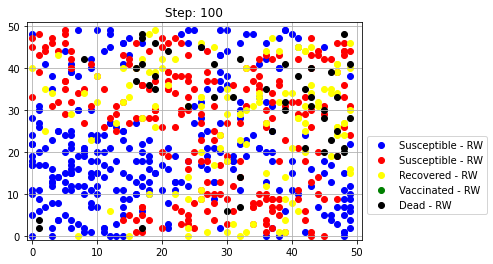

Healthy people= 288
Sick people= 224
Recovered people= 124
Vaccinated people= 0
Dead people= 47
 Dead seniors 33
 Dead juniors 14


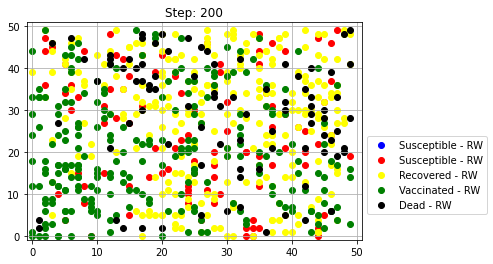

Healthy people= 0
Sick people= 96
Recovered people= 261
Vaccinated people= 236
Dead people= 90
 Dead seniors 64
 Dead juniors 26


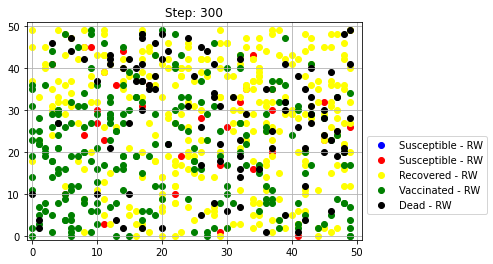

Healthy people= 0
Sick people= 32
Recovered people= 316
Vaccinated people= 236
Dead people= 99
 Dead seniors 70
 Dead juniors 29

 Iteration 26
668 juniors and 15 seniors


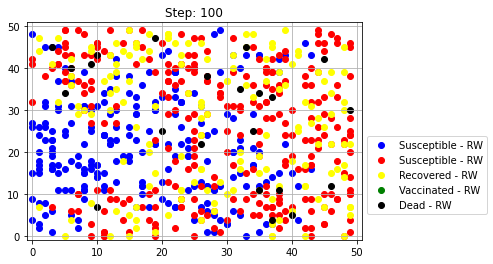

Healthy people= 224
Sick people= 280
Recovered people= 155
Vaccinated people= 0
Dead people= 24
 Dead seniors 5
 Dead juniors 19


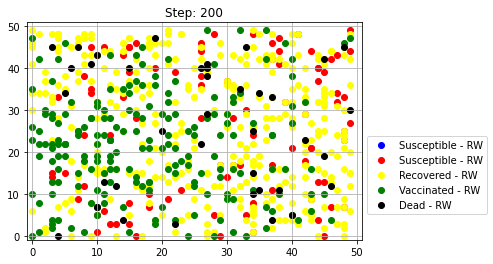

Healthy people= 0
Sick people= 93
Recovered people= 359
Vaccinated people= 193
Dead people= 38
 Dead seniors 7
 Dead juniors 31


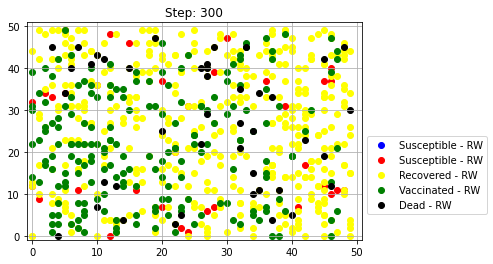

Healthy people= 0
Sick people= 34
Recovered people= 413
Vaccinated people= 193
Dead people= 43
 Dead seniors 7
 Dead juniors 36

 Iteration 27
572 juniors and 111 seniors


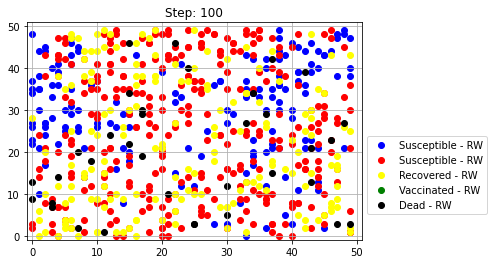

Healthy people= 154
Sick people= 319
Recovered people= 174
Vaccinated people= 0
Dead people= 36
 Dead seniors 22
 Dead juniors 14


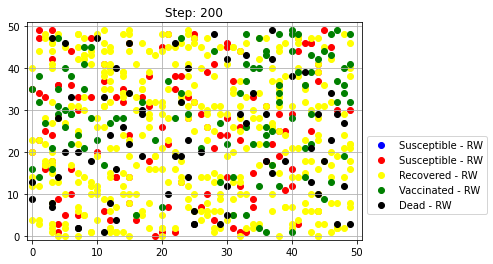

Healthy people= 0
Sick people= 118
Recovered people= 393
Vaccinated people= 102
Dead people= 70
 Dead seniors 42
 Dead juniors 28


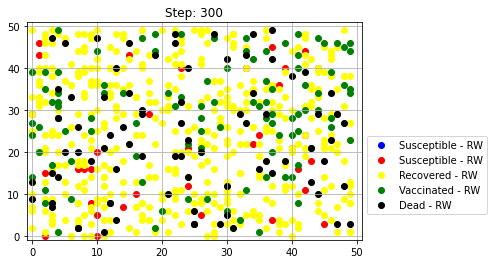

Healthy people= 0
Sick people= 35
Recovered people= 466
Vaccinated people= 102
Dead people= 80
 Dead seniors 44
 Dead juniors 36

 Iteration 28
641 juniors and 42 seniors


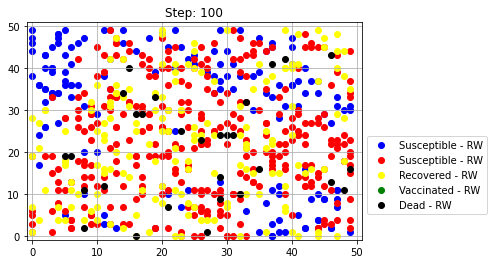

Healthy people= 144
Sick people= 336
Recovered people= 172
Vaccinated people= 0
Dead people= 31
 Dead seniors 9
 Dead juniors 22


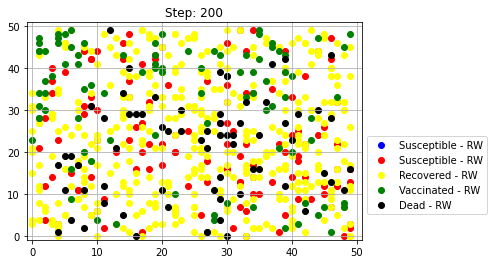

Healthy people= 0
Sick people= 124
Recovered people= 400
Vaccinated people= 92
Dead people= 67
 Dead seniors 18
 Dead juniors 49


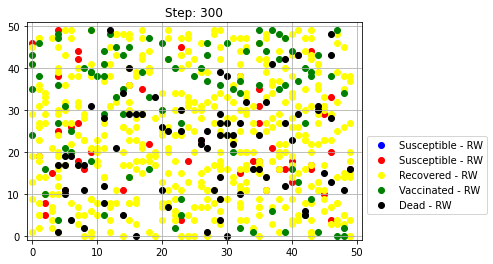

Healthy people= 0
Sick people= 46
Recovered people= 468
Vaccinated people= 92
Dead people= 77
 Dead seniors 20
 Dead juniors 57

 Iteration 29
47 juniors and 636 seniors


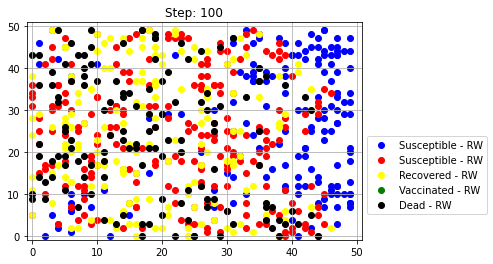

Healthy people= 158
Sick people= 221
Recovered people= 164
Vaccinated people= 0
Dead people= 140
 Dead seniors 138
 Dead juniors 2


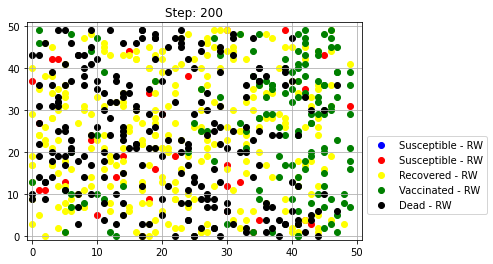

Healthy people= 0
Sick people= 31
Recovered people= 277
Vaccinated people= 136
Dead people= 239
 Dead seniors 235
 Dead juniors 4


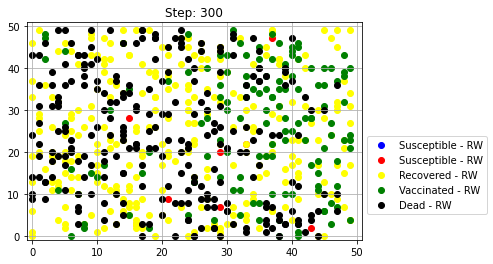

Healthy people= 0
Sick people= 8
Recovered people= 288
Vaccinated people= 136
Dead people= 251
 Dead seniors 247
 Dead juniors 4

 Iteration 30
192 juniors and 491 seniors


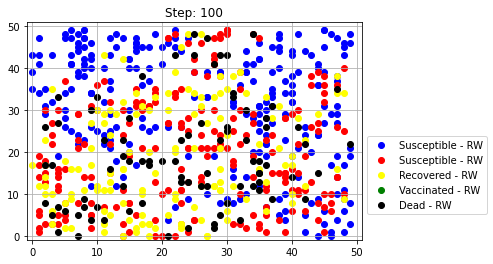

Healthy people= 244
Sick people= 213
Recovered people= 140
Vaccinated people= 0
Dead people= 86
 Dead seniors 81
 Dead juniors 5


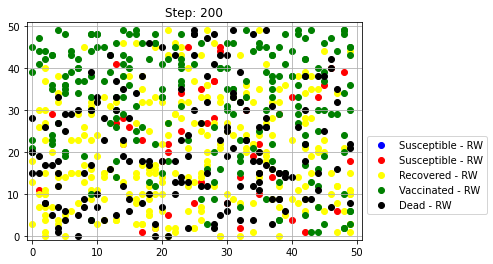

Healthy people= 0
Sick people= 43
Recovered people= 258
Vaccinated people= 215
Dead people= 167
 Dead seniors 157
 Dead juniors 10


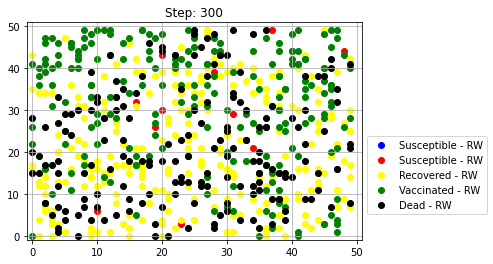

Healthy people= 0
Sick people= 11
Recovered people= 277
Vaccinated people= 215
Dead people= 180
 Dead seniors 168
 Dead juniors 12

 Iteration 31
417 juniors and 266 seniors


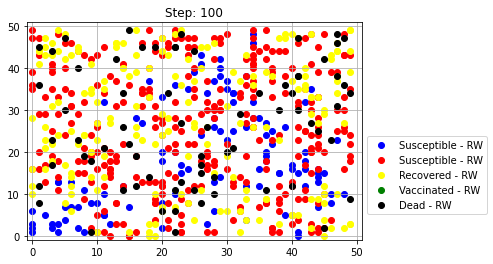

Healthy people= 103
Sick people= 316
Recovered people= 191
Vaccinated people= 0
Dead people= 73
 Dead seniors 60
 Dead juniors 13


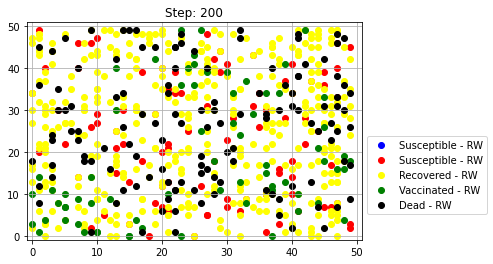

Healthy people= 0
Sick people= 93
Recovered people= 392
Vaccinated people= 69
Dead people= 129
 Dead seniors 100
 Dead juniors 29


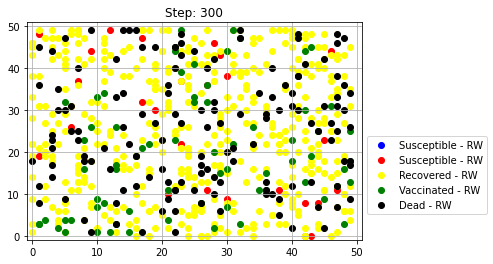

Healthy people= 0
Sick people= 28
Recovered people= 444
Vaccinated people= 69
Dead people= 142
 Dead seniors 108
 Dead juniors 34

 Iteration 32
477 juniors and 206 seniors


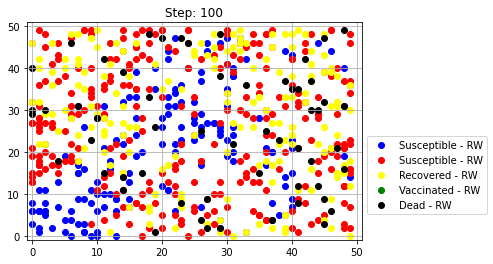

Healthy people= 154
Sick people= 288
Recovered people= 182
Vaccinated people= 0
Dead people= 59
 Dead seniors 44
 Dead juniors 15


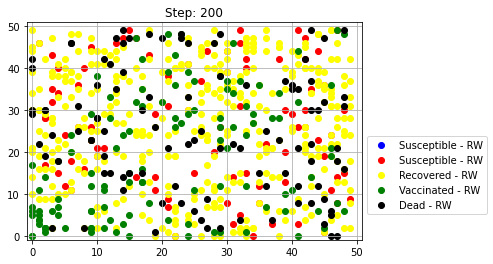

Healthy people= 0
Sick people= 88
Recovered people= 375
Vaccinated people= 118
Dead people= 102
 Dead seniors 73
 Dead juniors 29


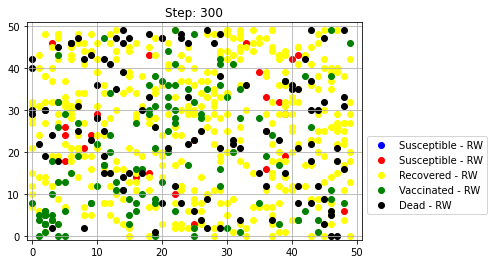

Healthy people= 0
Sick people= 26
Recovered people= 431
Vaccinated people= 118
Dead people= 108
 Dead seniors 73
 Dead juniors 35

 Iteration 33
679 juniors and 4 seniors


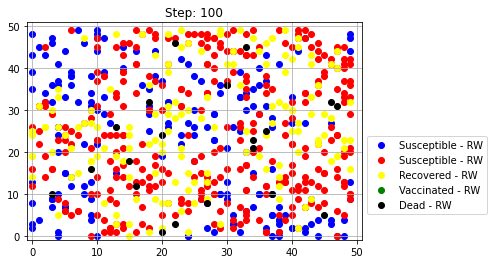

Healthy people= 174
Sick people= 336
Recovered people= 152
Vaccinated people= 0
Dead people= 21
 Dead seniors 0
 Dead juniors 21


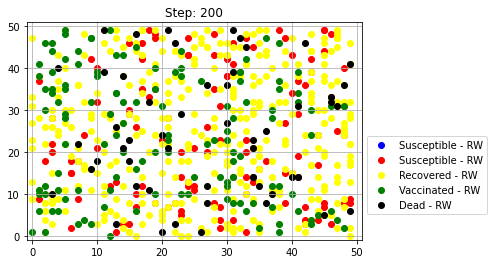

Healthy people= 0
Sick people= 120
Recovered people= 382
Vaccinated people= 129
Dead people= 52
 Dead seniors 2
 Dead juniors 50


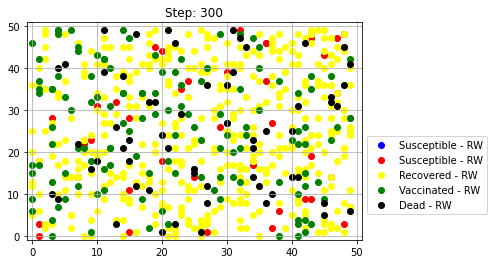

Healthy people= 0
Sick people= 42
Recovered people= 452
Vaccinated people= 129
Dead people= 60
 Dead seniors 2
 Dead juniors 58

 Iteration 34
399 juniors and 284 seniors


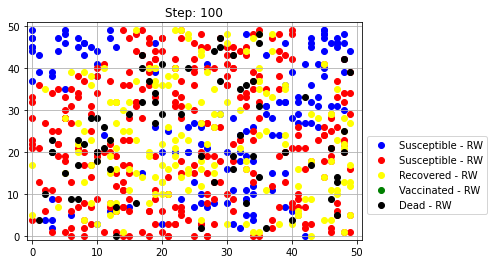

Healthy people= 141
Sick people= 305
Recovered people= 169
Vaccinated people= 0
Dead people= 68
 Dead seniors 60
 Dead juniors 8


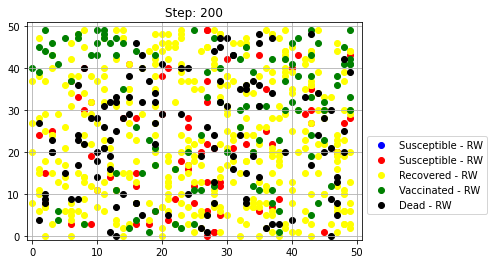

Healthy people= 0
Sick people= 72
Recovered people= 385
Vaccinated people= 106
Dead people= 120
 Dead seniors 103
 Dead juniors 17


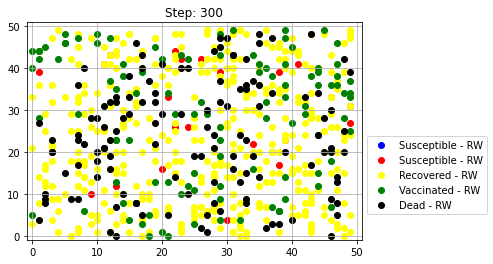

Healthy people= 0
Sick people= 25
Recovered people= 424
Vaccinated people= 106
Dead people= 128
 Dead seniors 109
 Dead juniors 19

 Iteration 35
297 juniors and 386 seniors


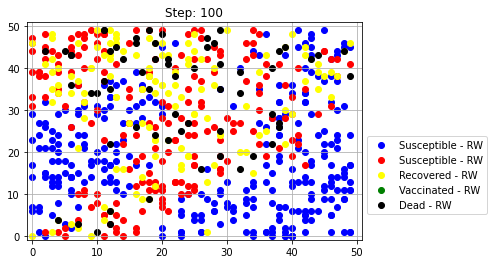

Healthy people= 287
Sick people= 200
Recovered people= 129
Vaccinated people= 0
Dead people= 67
 Dead seniors 60
 Dead juniors 7


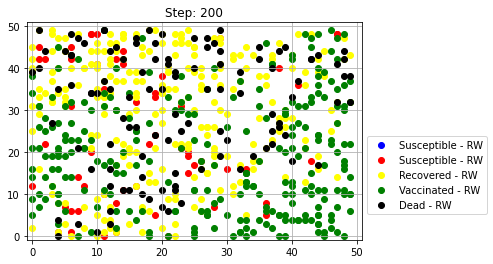

Healthy people= 0
Sick people= 56
Recovered people= 255
Vaccinated people= 259
Dead people= 113
 Dead seniors 103
 Dead juniors 10


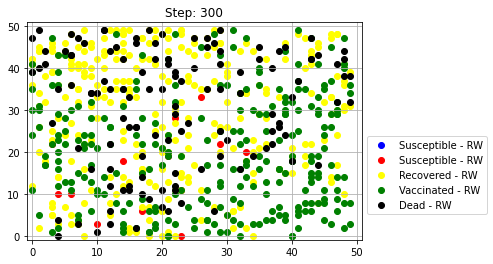

Healthy people= 0
Sick people= 13
Recovered people= 288
Vaccinated people= 259
Dead people= 123
 Dead seniors 111
 Dead juniors 12

 Iteration 36
112 juniors and 571 seniors


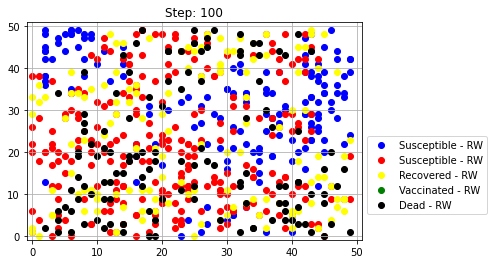

Healthy people= 152
Sick people= 262
Recovered people= 138
Vaccinated people= 0
Dead people= 131
 Dead seniors 129
 Dead juniors 2


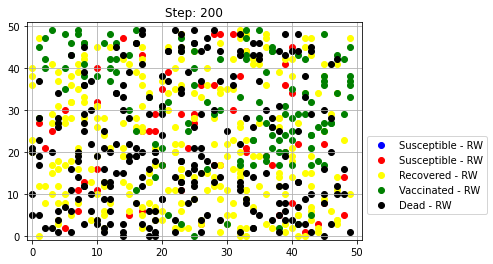

Healthy people= 0
Sick people= 55
Recovered people= 262
Vaccinated people= 123
Dead people= 243
 Dead seniors 235
 Dead juniors 8


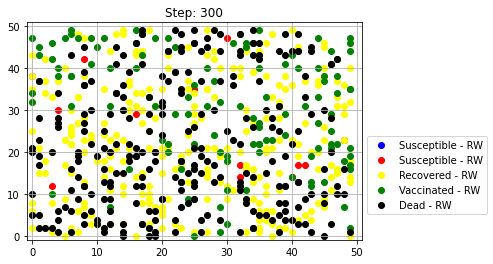

Healthy people= 0
Sick people= 13
Recovered people= 288
Vaccinated people= 123
Dead people= 259
 Dead seniors 251
 Dead juniors 8

 Iteration 37
542 juniors and 141 seniors


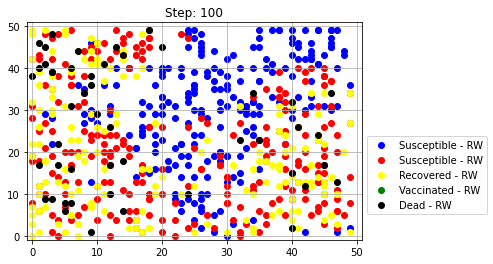

Healthy people= 219
Sick people= 248
Recovered people= 167
Vaccinated people= 0
Dead people= 49
 Dead seniors 27
 Dead juniors 22


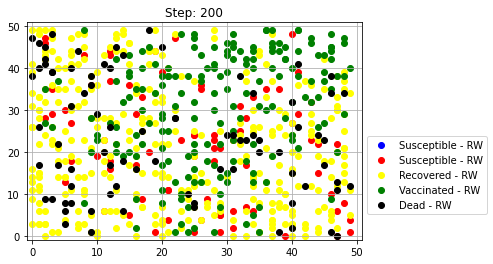

Healthy people= 0
Sick people= 78
Recovered people= 340
Vaccinated people= 182
Dead people= 83
 Dead seniors 50
 Dead juniors 33


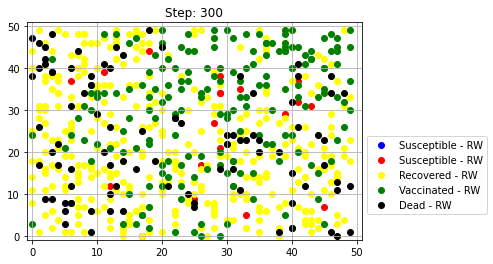

Healthy people= 0
Sick people= 21
Recovered people= 389
Vaccinated people= 182
Dead people= 91
 Dead seniors 56
 Dead juniors 35

 Iteration 38
176 juniors and 507 seniors


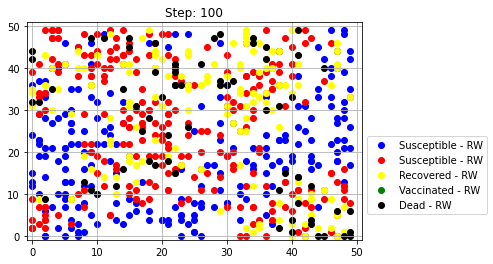

Healthy people= 213
Sick people= 251
Recovered people= 147
Vaccinated people= 0
Dead people= 72
 Dead seniors 70
 Dead juniors 2


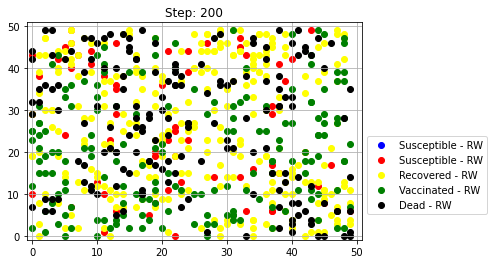

Healthy people= 0
Sick people= 63
Recovered people= 278
Vaccinated people= 172
Dead people= 170
 Dead seniors 167
 Dead juniors 3


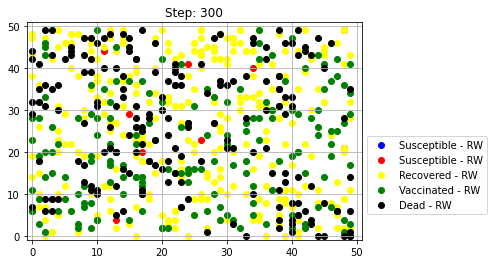

Healthy people= 0
Sick people= 10
Recovered people= 311
Vaccinated people= 172
Dead people= 190
 Dead seniors 185
 Dead juniors 5

 Iteration 39
169 juniors and 514 seniors


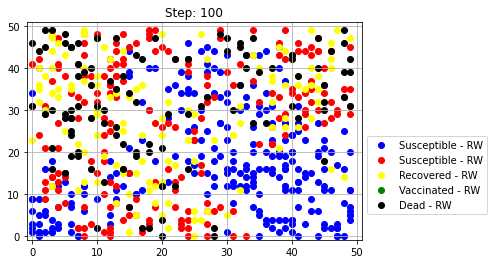

Healthy people= 241
Sick people= 203
Recovered people= 128
Vaccinated people= 0
Dead people= 111
 Dead seniors 108
 Dead juniors 3


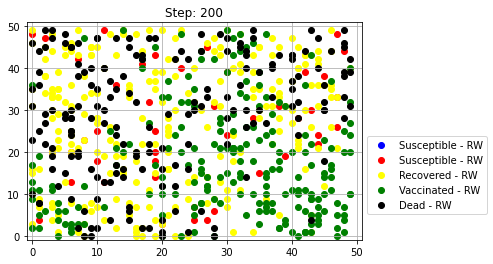

Healthy people= 0
Sick people= 45
Recovered people= 245
Vaccinated people= 209
Dead people= 184
 Dead seniors 174
 Dead juniors 10


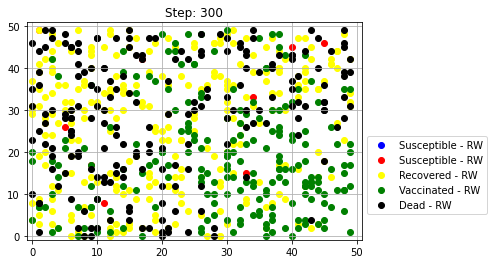

Healthy people= 0
Sick people= 9
Recovered people= 267
Vaccinated people= 209
Dead people= 198
 Dead seniors 186
 Dead juniors 12

 Iteration 40
339 juniors and 344 seniors


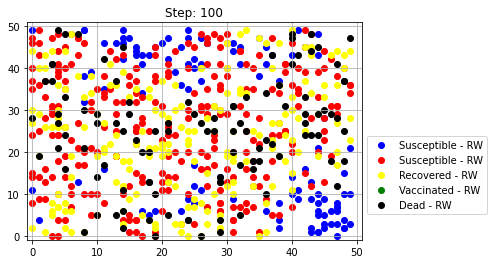

Healthy people= 106
Sick people= 281
Recovered people= 189
Vaccinated people= 0
Dead people= 107
 Dead seniors 90
 Dead juniors 17


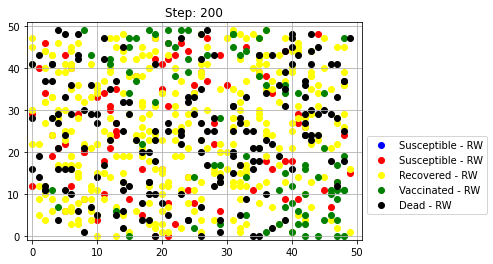

Healthy people= 0
Sick people= 82
Recovered people= 335
Vaccinated people= 85
Dead people= 181
 Dead seniors 148
 Dead juniors 33


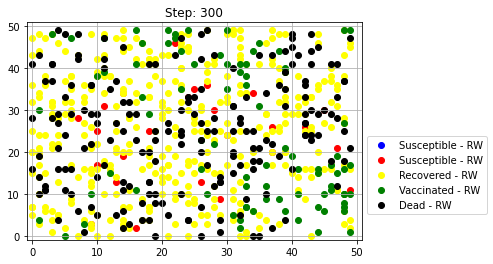

Healthy people= 0
Sick people= 25
Recovered people= 379
Vaccinated people= 85
Dead people= 194
 Dead seniors 156
 Dead juniors 38

 Iteration 41
427 juniors and 256 seniors


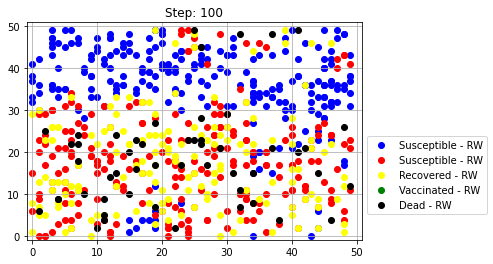

Healthy people= 242
Sick people= 236
Recovered people= 153
Vaccinated people= 0
Dead people= 52
 Dead seniors 42
 Dead juniors 10


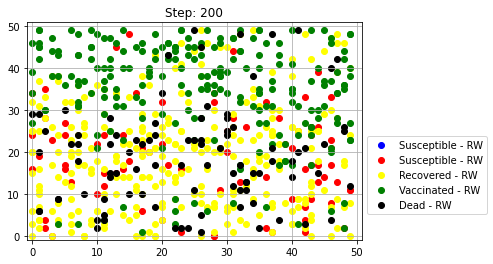

Healthy people= 0
Sick people= 79
Recovered people= 288
Vaccinated people= 223
Dead people= 93
 Dead seniors 66
 Dead juniors 27


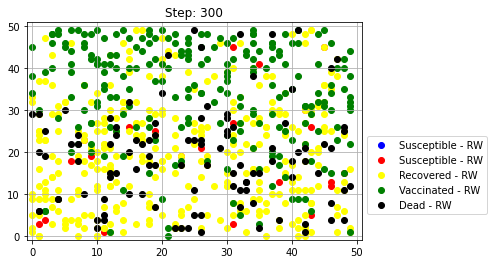

Healthy people= 0
Sick people= 22
Recovered people= 332
Vaccinated people= 223
Dead people= 106
 Dead seniors 71
 Dead juniors 35

 Iteration 42
99 juniors and 584 seniors


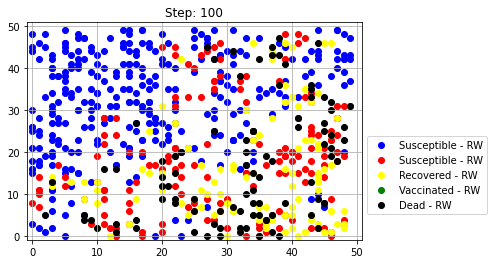

Healthy people= 316
Sick people= 157
Recovered people= 112
Vaccinated people= 0
Dead people= 98
 Dead seniors 97
 Dead juniors 1


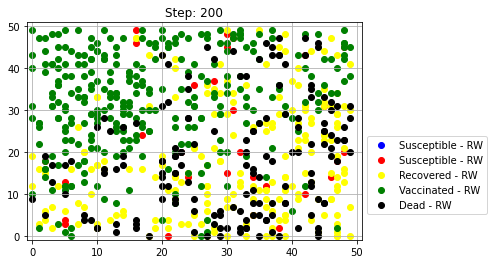

Healthy people= 0
Sick people= 29
Recovered people= 199
Vaccinated people= 295
Dead people= 160
 Dead seniors 157
 Dead juniors 3


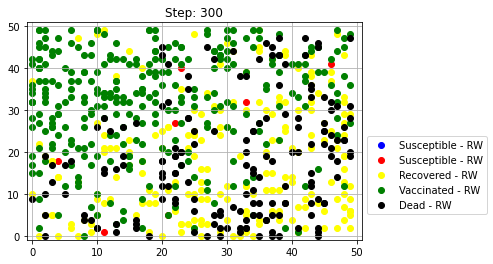

Healthy people= 0
Sick people= 7
Recovered people= 211
Vaccinated people= 295
Dead people= 170
 Dead seniors 165
 Dead juniors 5

 Iteration 43
134 juniors and 549 seniors


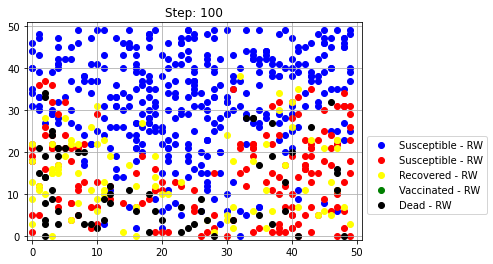

Healthy people= 367
Sick people= 166
Recovered people= 85
Vaccinated people= 0
Dead people= 65
 Dead seniors 61
 Dead juniors 4


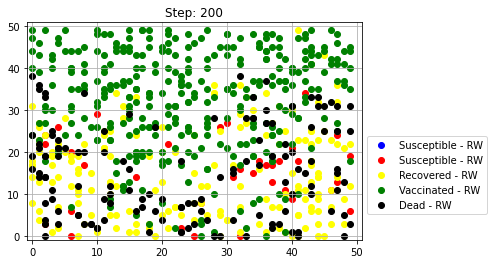

Healthy people= 0
Sick people= 35
Recovered people= 175
Vaccinated people= 340
Dead people= 133
 Dead seniors 127
 Dead juniors 6


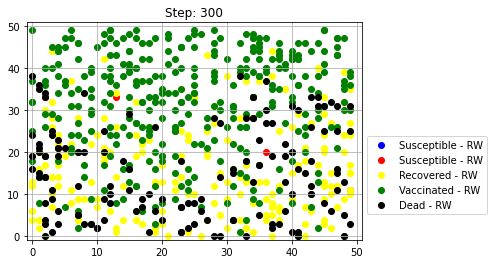

Healthy people= 0
Sick people= 4
Recovered people= 199
Vaccinated people= 340
Dead people= 140
 Dead seniors 134
 Dead juniors 6

 Iteration 44
253 juniors and 430 seniors


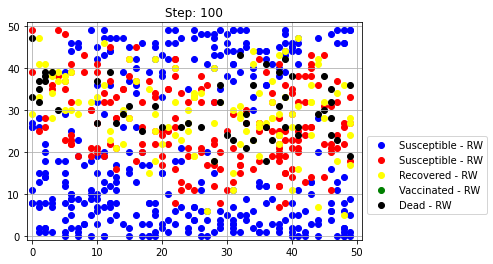

Healthy people= 328
Sick people= 189
Recovered people= 110
Vaccinated people= 0
Dead people= 56
 Dead seniors 53
 Dead juniors 3


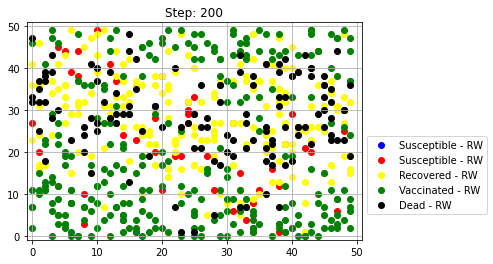

Healthy people= 0
Sick people= 53
Recovered people= 220
Vaccinated people= 284
Dead people= 126
 Dead seniors 118
 Dead juniors 8


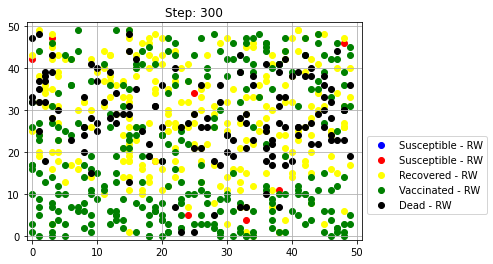

Healthy people= 0
Sick people= 9
Recovered people= 254
Vaccinated people= 284
Dead people= 136
 Dead seniors 128
 Dead juniors 8

 Iteration 45
192 juniors and 491 seniors


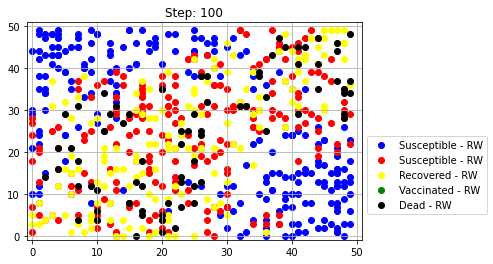

Healthy people= 225
Sick people= 217
Recovered people= 163
Vaccinated people= 0
Dead people= 78
 Dead seniors 75
 Dead juniors 3


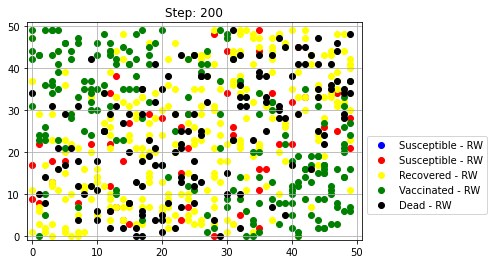

Healthy people= 0
Sick people= 51
Recovered people= 286
Vaccinated people= 201
Dead people= 145
 Dead seniors 140
 Dead juniors 5


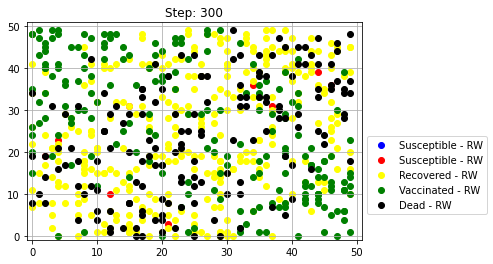

Healthy people= 0
Sick people= 9
Recovered people= 313
Vaccinated people= 201
Dead people= 160
 Dead seniors 152
 Dead juniors 8

 Iteration 46
271 juniors and 412 seniors


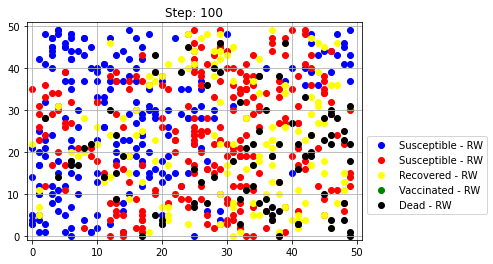

Healthy people= 204
Sick people= 256
Recovered people= 134
Vaccinated people= 0
Dead people= 89
 Dead seniors 79
 Dead juniors 10


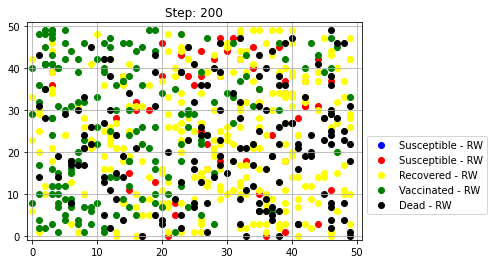

Healthy people= 0
Sick people= 56
Recovered people= 295
Vaccinated people= 171
Dead people= 161
 Dead seniors 146
 Dead juniors 15


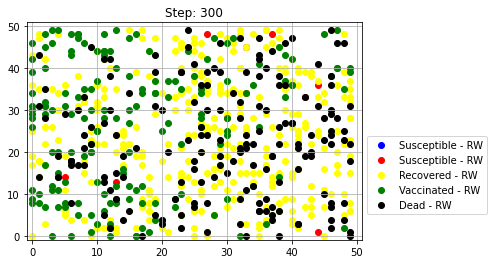

Healthy people= 0
Sick people= 10
Recovered people= 328
Vaccinated people= 171
Dead people= 174
 Dead seniors 157
 Dead juniors 17

 Iteration 47
645 juniors and 38 seniors


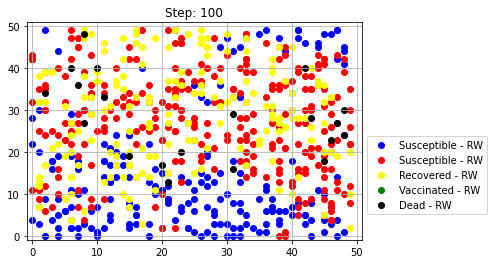

Healthy people= 191
Sick people= 296
Recovered people= 176
Vaccinated people= 0
Dead people= 20
 Dead seniors 5
 Dead juniors 15


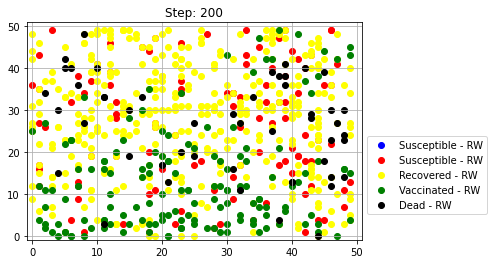

Healthy people= 0
Sick people= 103
Recovered people= 379
Vaccinated people= 151
Dead people= 50
 Dead seniors 12
 Dead juniors 38


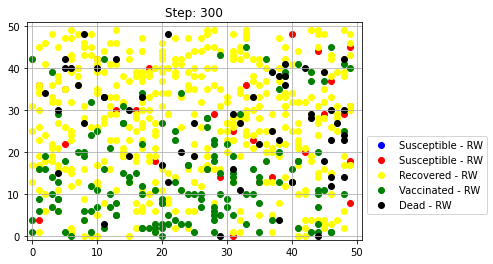

Healthy people= 0
Sick people= 29
Recovered people= 447
Vaccinated people= 151
Dead people= 56
 Dead seniors 12
 Dead juniors 44

 Iteration 48
374 juniors and 309 seniors


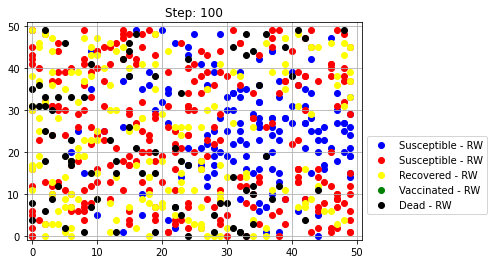

Healthy people= 148
Sick people= 273
Recovered people= 176
Vaccinated people= 0
Dead people= 86
 Dead seniors 71
 Dead juniors 15


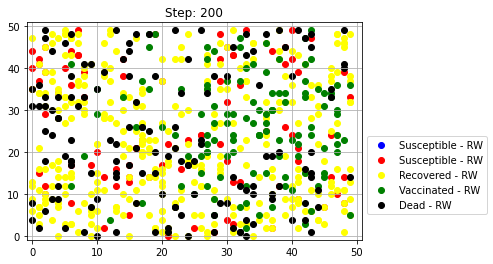

Healthy people= 0
Sick people= 87
Recovered people= 333
Vaccinated people= 120
Dead people= 143
 Dead seniors 113
 Dead juniors 30


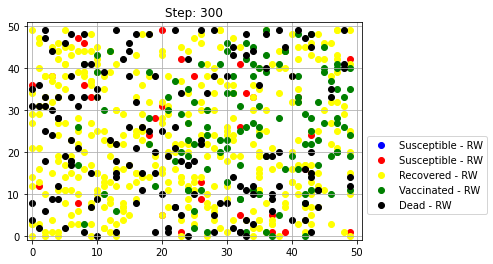

Healthy people= 0
Sick people= 30
Recovered people= 379
Vaccinated people= 120
Dead people= 154
 Dead seniors 123
 Dead juniors 31

 Iteration 49
230 juniors and 453 seniors


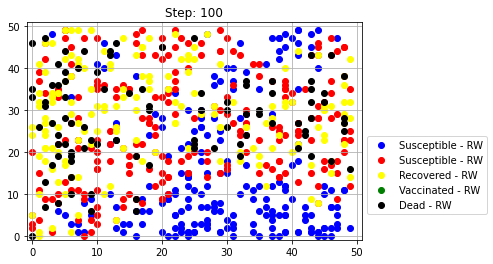

Healthy people= 200
Sick people= 230
Recovered people= 158
Vaccinated people= 0
Dead people= 95
 Dead seniors 89
 Dead juniors 6


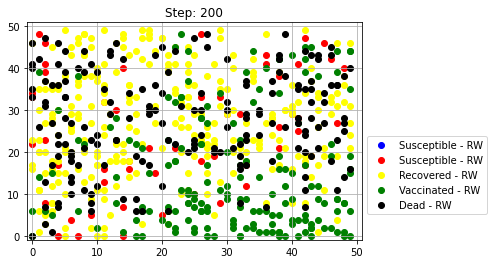

Healthy people= 0
Sick people= 53
Recovered people= 277
Vaccinated people= 173
Dead people= 180
 Dead seniors 168
 Dead juniors 12


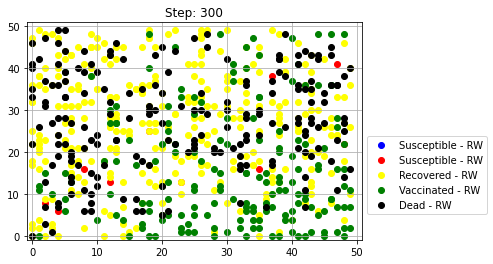

Healthy people= 0
Sick people= 9
Recovered people= 307
Vaccinated people= 173
Dead people= 194
 Dead seniors 179
 Dead juniors 15

 Iteration 50
463 juniors and 220 seniors


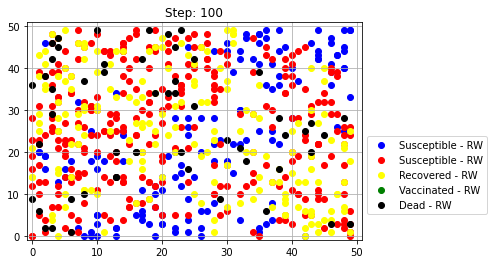

Healthy people= 134
Sick people= 312
Recovered people= 183
Vaccinated people= 0
Dead people= 54
 Dead seniors 35
 Dead juniors 19


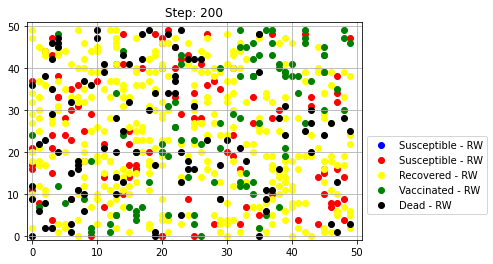

Healthy people= 0
Sick people= 103
Recovered people= 376
Vaccinated people= 99
Dead people= 105
 Dead seniors 73
 Dead juniors 32


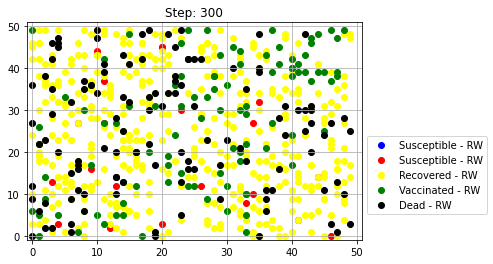

Healthy people= 0
Sick people= 21
Recovered people= 441
Vaccinated people= 99
Dead people= 122
 Dead seniors 81
 Dead juniors 41


In [17]:
inf, sus,rec,vac,dea=np.array([]),np.array([]), np.array([]), np.array([]), np.array([])
n,m=50,300 # n is number of iterations and m is time step
for i in range(n):
    print('\n Iteration {}'.format(i+1))
    ex4 = RandomWalkEpidemicSimulator(population_size=683,no_init_infected=10,nx=50, ny=50,  
                                      p_infected=0.9,plot_radomwalk=True,p_recovered=0.01,
                                      p_vaccinated=0.1,p_dead=0.01,print_age=True,plot_mean=True,plot_mean10=True,)
    inf_temp, sus_temp,rec_temp,vac_temp,dea_temp=ex4.simulatior_every_step(m)
    inf=np.append(inf,inf_temp)
    sus=np.append(sus,sus_temp)
    rec=np.append(rec,rec_temp)
    vac=np.append(vac,vac_temp)
    dea=np.append(dea,dea_temp)

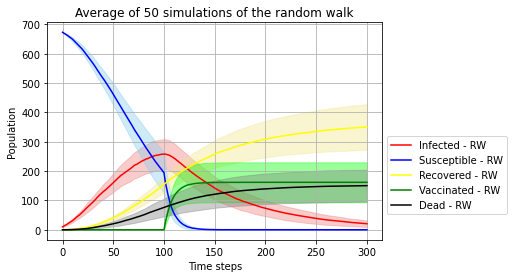

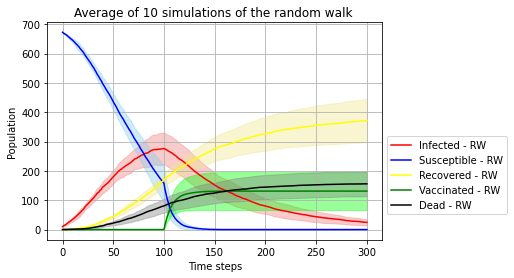

In [18]:
ex4.SI_mean_sd_plot(inf,sus,rec,vac,dea,m+1)

# Conclusion and Discussion:

It is amazing how python can be such as useful tool to solve almost any kind of problem, its reach depends actually on how you see the things and how you can analyze them. 


It is amazing the amount of information that we can find avaliable in internet and how we can apply our knowledge to give a better understanding of its behaviour in order to predict some future outcomes or "possibly outcomes". In a situation like this it is hard to predict sometimes due to virus change every second and the information that we are modelling it is depending of the virus effects on person, which in a real life sitution can overcome us in the beginning but if we really understand the it is initial reactions and patterns we can set rules that at some point in the future can match and prevent a virus spreading among the population.

Regarding the implementation and development of the code to get and vizualize the information that we got, we found some problems in order to get the right code but with the help of the TA and the guide report we manage to reach our objective. Also we did team work mettings to come up with different ideas to proceed with the code and implementation of classes and ways to code.

From the project we can also conclude that with a 0.01 probability to get recover form the disease its good, we saw how the infected people got smoother and no more than half of the population was infected at the same time which makes the disease to spread slower and in the real-life situation, can help the hospitals to not reach their maximun capacity

From the last exercise we can see that death people tried to be constant, and that is why governments try to keep since it is hard to reduce this until 0, because of the constant variants. Also this was one of the objectives when vaccines were launched to reduce or keep constant the amount of deaths, an din the graph we can see that when vaccines came out, death people inmediately starting to get almost constant. [<sup>5</sup>](#refer-5) 

# References

<div id="refer-1"></div>‌- [1] [Review of Random Corona Walk] Hiorth, A. (2021)  
<div id="refer-2"></div>- [2] [Random Walk (Implementation in Python)] (https://www.geeksforgeeks.org/random-walk-implementation-python/) geeksforgeeks (2021)  <div id="refer-3"></div>- [3] [Modelling the coronavirus epidemic in a city with Python] (https://towardsdatascience.com/modelling-the-coronavirus-epidemic-spreading-in-a-city-with-python-babd14d82fa2) Gevorg Yeghikyan (2020)  
<div id="refer-4"></div>- [4] [The Basic Reproduction Number
] (http://web.stanford.edu/class/earthsys214/notes/R0.html) James Holland Jones (2017)  
<div id="refer-5"></div>- [5] [Coronavirus death rate: What are the chances of dying?] (https://www.bbc.com/news/health-51674743) Robert Cuffe (2020)